## Environment Setup

**Upload following files to current directory**

1.   *requirements.txt*
2.   *dataloader.py*
3.   *capsule_network.py*
4.   *ccm_pruner.py*
5.   *utils.py*
6.   *model_train_test.py*

In [ ]:
from google.colab import files

uploaded = files.upload()

for fn in uploaded.keys():
  print('User uploaded file "{name}"'.format(name=fn))

Saving ccm_pruner.py to ccm_pruner.py
Saving capsule_network.py to capsule_network.py
Saving dataloader.py to dataloader.py
Saving model_train_test.py to model_train_test.py
Saving requirements.txt to requirements.txt
Saving utils.py to utils.py
User uploaded file "ccm_pruner.py"
User uploaded file "capsule_network.py"
User uploaded file "dataloader.py"
User uploaded file "model_train_test.py"
User uploaded file "requirements.txt"
User uploaded file "utils.py"


In [ ]:
pip install -r requirements.txt

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 521.2/521.2 kB 8.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 115.3/115.3 kB 14.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 12.3 MB/s eta 0:00:00
INFO: pip is looking at multiple versions of multiprocess to determine which version is compatible with other requirements. This could take a while.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 16.4 MB/s eta 0:00:00


In [1]:
from google.colab import drive
drive.mount('/content/drive')

ROOT="/content/drive/MyDrive/MSc_AI/Course/OCOM5300M-AI_Project/code_repository/results/"

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Importing required libraries

In [2]:
import os, gc
import random
import shutil
import time, datetime
from thop import vision, profile, clever_format
from flopth import flopth
from PIL import Image

import numpy as np
import matplotlib.pyplot as plt
from collections import OrderedDict

import torch
import torch.nn as nn
import torch.nn.functional as F

import capsule_network as caps
import ccm_pruner as ccmp
import model_train_test as mtt
import utils
from dataloader import image_dataloader

CapsuleNet is using device: cuda


Device (CPU/GPU) available to use.

In [3]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print('This notebook using device:', device)

random_seed = 42
random.seed(random_seed)
np.random.seed(random_seed)
torch.manual_seed(random_seed)
torch.cuda.manual_seed(random_seed)
torch.random.manual_seed(random_seed)

This notebook using device: cuda


Setting up logger and directories

In [4]:
try:
    ROOT
except NameError:
    ROOT="./results/"
    if not os.path.exists(ROOT):
        os.makedirs(ROOT)

print('ROOT Directory:', ROOT)

TRAIN_DIR = ROOT+"train/"
LOG_DIR = ROOT+"logs/"

logger = utils.get_logger(LOG_DIR)

ROOT Directory: /content/drive/MyDrive/MSc_AI/Course/OCOM5300M-AI_Project/code_repository/results/


In [5]:
def clear_gpu_memory():
    gc.collect()
    torch.cuda.empty_cache()

## Single Intermediate Layered CapsNet

In [ ]:
CIFAR10_TRAIN_DIR = TRAIN_DIR+"cifar10/20Caps8Dim/"
batch_size=32
n_epochs=30
n_class=10

n_caps_layers=1
prim_caps_channels=20
prim_caps_dim=8

model_conv_config = {'in_img_h':32,
                     'in_img_w':32,
                     'in_img_c':3,
                     'kernel_size': [3, 3, 3, 3],
                     'stride': [1, 2, 1, 2],
                     'padding': [1, 1, 1, 0]}

train_loader, test_loader = image_dataloader(dataset='cifar10', batch_size=batch_size)

criterion = caps.CapsNetLoss(n_class=n_class)

Files already downloaded and verified
Files already downloaded and verified


In [ ]:
multilayer_inter1_capsnet_cifar10_model = caps.CapsuleNetwork(in_img_c=3, in_img_h=32, in_img_w=32, n_class=n_class,
                                                               model_conv_config=model_conv_config, prim_caps_channels=prim_caps_channels,
                                                               prim_caps_dim=prim_caps_dim, n_caps_layers=n_caps_layers)

multilayer_inter1_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 40, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(40, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(40, 80, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(80, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(80, 160, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(160, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(160, 160, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
  )
  (class_caps): CapsLayer()
)

### 12.5% Pruned Base CapsNet with Intermediate Layers

In [ ]:
pruned_model_type = 12

best_pruned_base_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_{}pc_base_capsnet_cifar10_model.pt'.format(pruned_model_type))

pruned_multilayer_inter1_capsnet_cifar10_model = ccmp.create_pruned_model_from_state_dict(
    new_model = multilayer_inter1_capsnet_cifar10_model,
    saved_state_dict = best_pruned_base_capsnet_cifar10_model['model_state_dict'],
    model_conv_config_dict = model_conv_config, n_class = n_class, n_caps_layers = n_caps_layers,
    prim_caps_dim = prim_caps_dim, base_capsnet_stdict = True)

pruned_multilayer_inter1_capsnet_cifar10_model.name = 'pruned_{}pc_multilayer_inter1_capsnet_cifar10_model'.format(pruned_model_type)
pruned_multilayer_inter1_capsnet_cifar10_model = pruned_multilayer_inter1_capsnet_cifar10_model.to(device)
pruned_multilayer_inter1_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 72, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(72, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(72, 144, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(144, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(144, 144, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
  )
  (class_caps): CapsLayer()
)

In [ ]:
%%time
best_trained_model_path, _, _ = mtt.train_capsnet(n_epochs,
                                                  pruned_multilayer_inter1_capsnet_cifar10_model,
                                                  criterion,
                                                  train_loader,
                                                  test_loader,
                                                  CIFAR10_TRAIN_DIR,
                                                  logger,
                                                  device=device)

02/28 01:43:45 PM | pruned_12pc_multilayer_inter1_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=1.2073, Top 1 Acc=3.12, Top 5 Acc=62.50
INFO:capsnet:pruned_12pc_multilayer_inter1_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=1.2073, Top 1 Acc=3.12, Top 5 Acc=62.50
02/28 01:43:51 PM | pruned_12pc_multilayer_inter1_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.5467, Top 1 Acc=22.92, Top 5 Acc=68.56
INFO:capsnet:pruned_12pc_multilayer_inter1_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.5467, Top 1 Acc=22.92, Top 5 Acc=68.56
02/28 01:43:56 PM | pruned_12pc_multilayer_inter1_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.4633, Top 1 Acc=35.87, Top 5 Acc=79.04
INFO:capsnet:pruned_12pc_multilayer_inter1_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.4633, Top 1 Acc=35.87, Top 5 Acc=79.04
02/28 01:44:01 PM | pruned_12pc_multilayer_inter1_capsnet_cifar10_model

CPU times: user 2h 4min 15s, sys: 5min 20s, total: 2h 9min 35s
Wall time: 2h 11min 8s


#### Export ConvCaps Activation

In [ ]:
pruned_trained_multilayer_inter1_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_12pc_multilayer_inter1_capsnet_cifar10_model.pt')

pruned_multilayer_inter1_capsnet_cifar10_model.load_state_dict(pruned_trained_multilayer_inter1_capsnet_cifar10_model['model_state_dict'])

pruned_multilayer_inter1_capsnet_cifar10_model.name = 'best_pruned_12pc_multilayer_inter1_capsnet_cifar10_model'
pruned_multilayer_inter1_capsnet_cifar10_model = pruned_multilayer_inter1_capsnet_cifar10_model.to(device)
pruned_multilayer_inter1_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 72, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(72, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(72, 144, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(144, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(144, 144, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
  )
  (class_caps): CapsLayer()
)

In [ ]:
capsnet_inter1_convcaps_activations = utils.extract_convcaps_activations(pruned_multilayer_inter1_capsnet_cifar10_model,
                                                                         test_loader, logger, CIFAR10_TRAIN_DIR, device)

02/28 04:28:36 PM | best_pruned_12pc_multilayer_inter1_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=84.375, Top 5 Acc=100.000
INFO:capsnet:best_pruned_12pc_multilayer_inter1_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=84.375, Top 5 Acc=100.000
02/28 04:28:37 PM | best_pruned_12pc_multilayer_inter1_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=75.000, Top 5 Acc=92.188
INFO:capsnet:best_pruned_12pc_multilayer_inter1_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=75.000, Top 5 Acc=92.188
02/28 04:28:37 PM | best_pruned_12pc_multilayer_inter1_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=78.125, Top 5 Acc=94.792
INFO:capsnet:best_pruned_12pc_multilayer_inter1_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=78.125, Top 5 Acc=94.792
02/28 04:28:37 PM | best_pruned_12pc_multilayer_inter1_capsnet_cifar10_model - Iterations=4/313, Batch Size=32, Top 1 Acc=82.031, Top 5 A

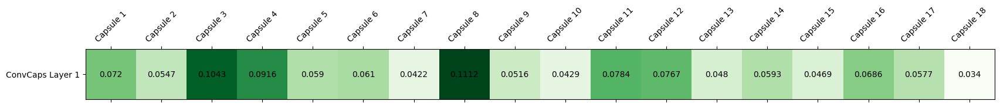

In [ ]:
utils.plot_caps_layers_activations(capsnet_inter1_convcaps_activations,
                                   n_caps=capsnet_inter1_convcaps_activations['intermediate_convcaps_layer_1'].shape[0],
                                   n_caps_layers=n_caps_layers, text_en=1)

#### Plots for losses and accuracies

In [ ]:
multilayer_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Trained_pruned_12pc_multilayer_inter1_capsnet_cifar10_model_Epoch30_of_30.pt')

epoch_loss = multilayer_capsnet_cifar10_model['epoch_loss']
epoch_accuracy = multilayer_capsnet_cifar10_model['epoch_accuracy']

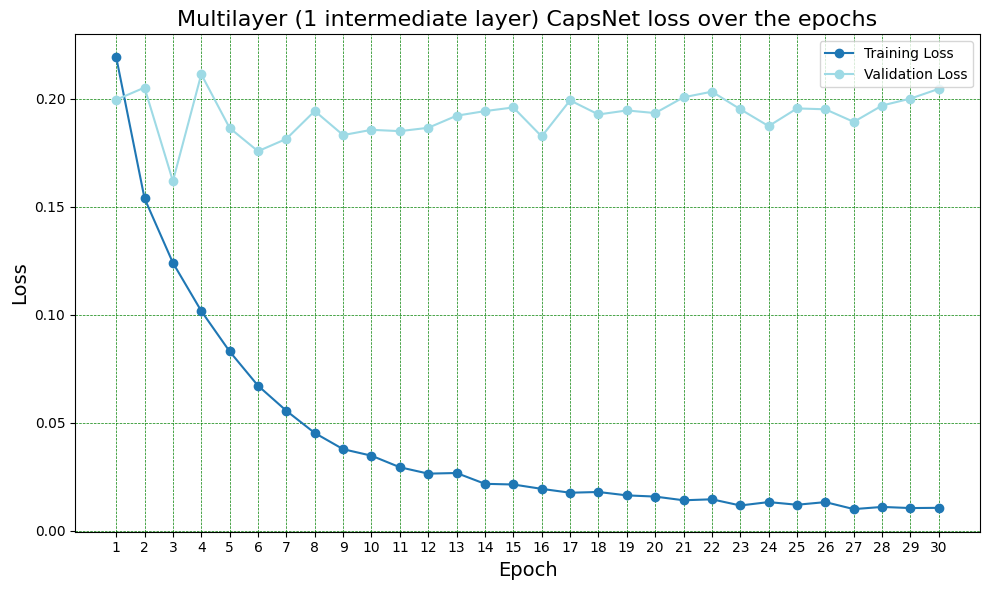

In [ ]:
utils.plot_line_chart(epoch_loss, ['Training Loss', 'Validation Loss'], 'Epoch', 'Loss',
                      'Multilayer (1 intermediate layer) CapsNet loss over the epochs')

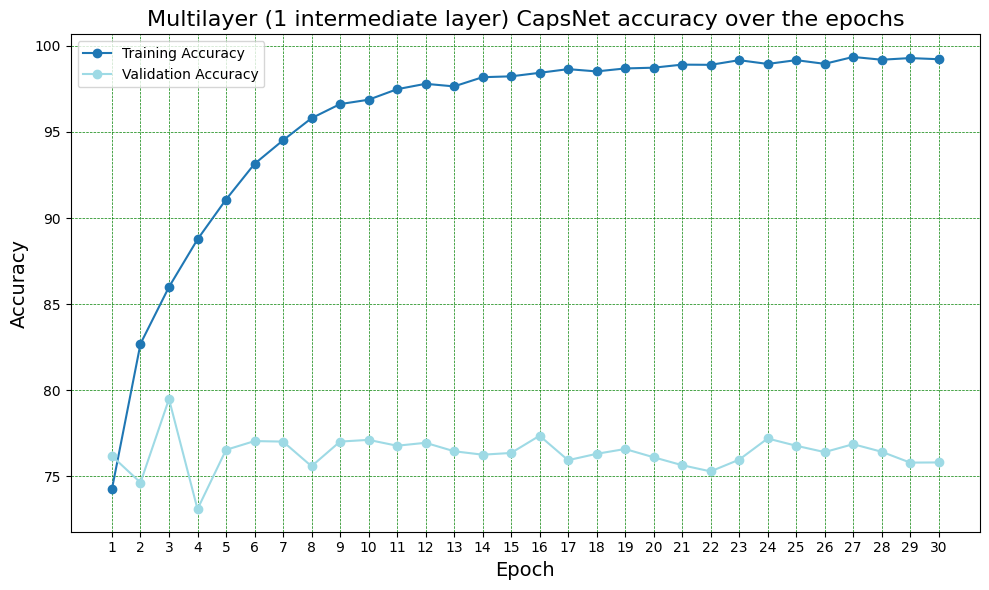

In [ ]:
utils.plot_line_chart(epoch_accuracy, ['Training Accuracy', 'Validation Accuracy'], 'Epoch', 'Accuracy',
                      'Multilayer (1 intermediate layer) CapsNet accuracy over the epochs')

In [ ]:
time.sleep(5)

from google.colab import runtime
runtime.unassign()

### 25% Pruned Base CapsNet with Intermediate Layers

In [ ]:
pruned_model_type = 25

best_pruned_base_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_{}pc_base_capsnet_cifar10_model.pt'.format(pruned_model_type))

pruned_multilayer_inter1_capsnet_cifar10_model = ccmp.create_pruned_model_from_state_dict(
    new_model = multilayer_inter1_capsnet_cifar10_model,
    saved_state_dict = best_pruned_base_capsnet_cifar10_model['model_state_dict'],
    model_conv_config_dict = model_conv_config, n_class = n_class, n_caps_layers = n_caps_layers,
    prim_caps_dim = prim_caps_dim, base_capsnet_stdict = True)

pruned_multilayer_inter1_capsnet_cifar10_model.name = 'pruned_{}pc_multilayer_inter1_capsnet_cifar10_model'.format(pruned_model_type)
pruned_multilayer_inter1_capsnet_cifar10_model = pruned_multilayer_inter1_capsnet_cifar10_model.to(device)
pruned_multilayer_inter1_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(64, 120, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(120, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(120, 120, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
  )
  (class_caps): CapsLayer()
)

In [ ]:
%%time
n_epochs = 15
best_trained_model_path, _, _ = mtt.train_capsnet(n_epochs,
                                                  pruned_multilayer_inter1_capsnet_cifar10_model,
                                                  criterion,
                                                  train_loader,
                                                  test_loader,
                                                  CIFAR10_TRAIN_DIR,
                                                  logger,
                                                  device=device)

02/28 04:30:29 PM | pruned_25pc_multilayer_inter1_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=1.0385, Top 1 Acc=12.50, Top 5 Acc=43.75
INFO:capsnet:pruned_25pc_multilayer_inter1_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=1.0385, Top 1 Acc=12.50, Top 5 Acc=43.75
02/28 04:30:33 PM | pruned_25pc_multilayer_inter1_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.5078, Top 1 Acc=26.89, Top 5 Acc=71.78
INFO:capsnet:pruned_25pc_multilayer_inter1_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.5078, Top 1 Acc=26.89, Top 5 Acc=71.78
02/28 04:30:37 PM | pruned_25pc_multilayer_inter1_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.4300, Top 1 Acc=40.91, Top 5 Acc=82.12
INFO:capsnet:pruned_25pc_multilayer_inter1_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.4300, Top 1 Acc=40.91, Top 5 Acc=82.12
02/28 04:30:42 PM | pruned_25pc_multilayer_inter1_capsnet_cifar10_mod

CPU times: user 52min 10s, sys: 2min 40s, total: 54min 50s
Wall time: 55min 25s


#### Export ConvCaps Activation

In [ ]:
pruned_trained_multilayer_inter1_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_25pc_multilayer_inter1_capsnet_cifar10_model.pt')

pruned_multilayer_inter1_capsnet_cifar10_model.load_state_dict(pruned_trained_multilayer_inter1_capsnet_cifar10_model['model_state_dict'])

pruned_multilayer_inter1_capsnet_cifar10_model.name = 'best_pruned_25pc_multilayer_inter1_capsnet_cifar10_model'
pruned_multilayer_inter1_capsnet_cifar10_model = pruned_multilayer_inter1_capsnet_cifar10_model.to(device)
pruned_multilayer_inter1_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(64, 120, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(120, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(120, 120, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
  )
  (class_caps): CapsLayer()
)

In [ ]:
capsnet_inter1_convcaps_activations = utils.extract_convcaps_activations(pruned_multilayer_inter1_capsnet_cifar10_model,
                                                                         test_loader, logger, CIFAR10_TRAIN_DIR, device)

02/28 05:25:54 PM | best_pruned_25pc_multilayer_inter1_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=93.750, Top 5 Acc=100.000
INFO:capsnet:best_pruned_25pc_multilayer_inter1_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=93.750, Top 5 Acc=100.000
02/28 05:25:54 PM | best_pruned_25pc_multilayer_inter1_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=78.125, Top 5 Acc=95.312
INFO:capsnet:best_pruned_25pc_multilayer_inter1_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=78.125, Top 5 Acc=95.312
02/28 05:25:54 PM | best_pruned_25pc_multilayer_inter1_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=76.042, Top 5 Acc=96.875
INFO:capsnet:best_pruned_25pc_multilayer_inter1_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=76.042, Top 5 Acc=96.875
02/28 05:25:54 PM | best_pruned_25pc_multilayer_inter1_capsnet_cifar10_model - Iterations=4/313, Batch Size=32, Top 1 Acc=79.688, Top 5 A

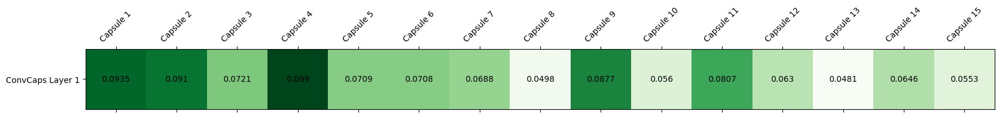

In [ ]:
utils.plot_caps_layers_activations(capsnet_inter1_convcaps_activations,
                                   n_caps=capsnet_inter1_convcaps_activations['intermediate_convcaps_layer_1'].shape[0],
                                   n_caps_layers=n_caps_layers, text_en=1)

#### Plots for losses and accuracies

In [ ]:
multilayer_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Trained_pruned_25pc_multilayer_inter1_capsnet_cifar10_model_Epoch15_of_15.pt')

epoch_loss = multilayer_capsnet_cifar10_model['epoch_loss']
epoch_accuracy = multilayer_capsnet_cifar10_model['epoch_accuracy']

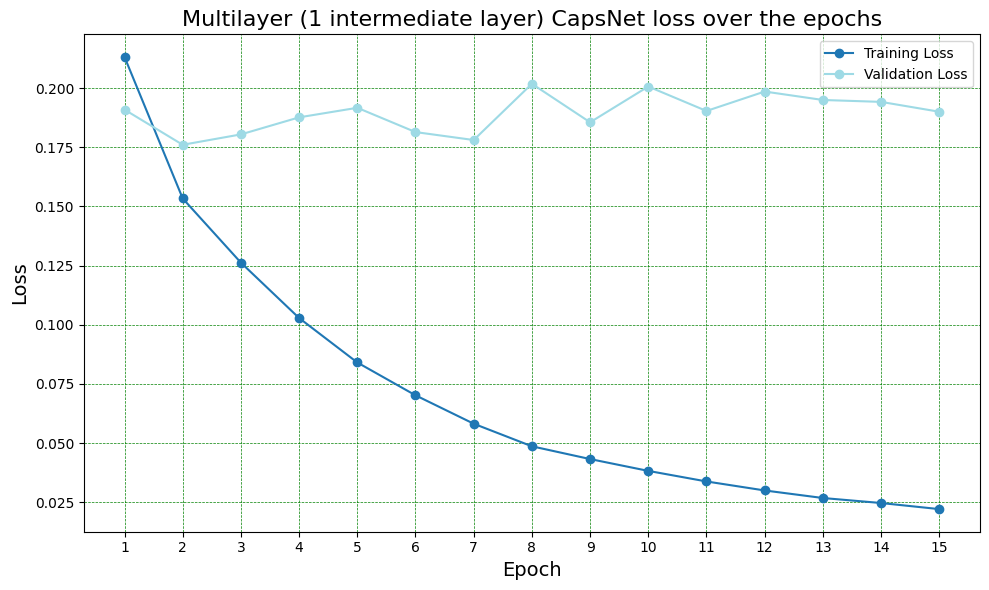

In [ ]:
utils.plot_line_chart(epoch_loss, ['Training Loss', 'Validation Loss'], 'Epoch', 'Loss',
                      'Multilayer (1 intermediate layer) CapsNet loss over the epochs')

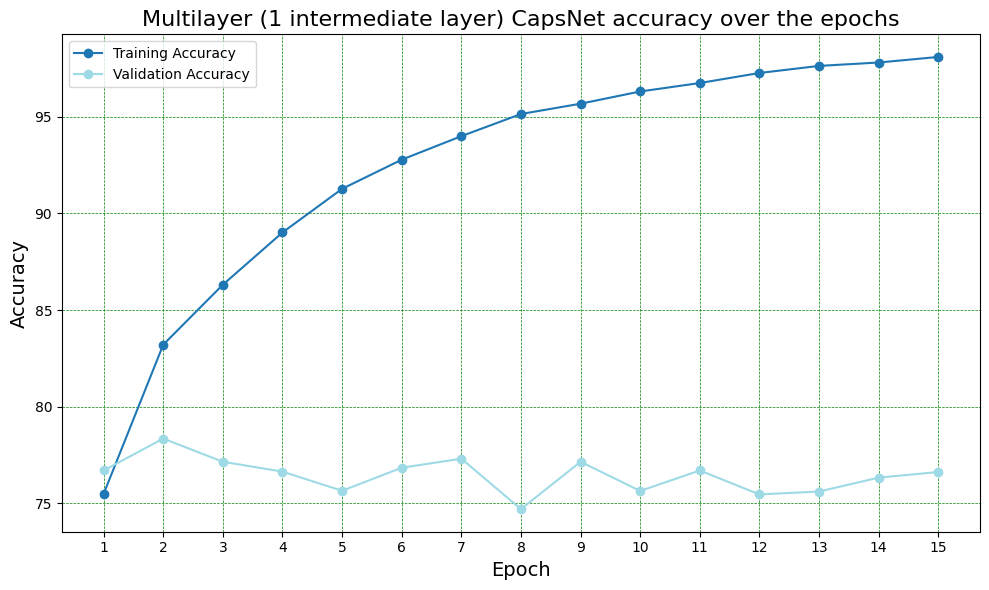

In [ ]:
utils.plot_line_chart(epoch_accuracy, ['Training Accuracy', 'Validation Accuracy'], 'Epoch', 'Accuracy',
                      'Multilayer (1 intermediate layer) CapsNet accuracy over the epochs')

In [ ]:
time.sleep(5)

from google.colab import runtime
runtime.unassign()

## 2 Intermediate Layered CapsNet

In [ ]:
CIFAR10_TRAIN_DIR = TRAIN_DIR+"cifar10/20Caps8Dim/"
batch_size=32
n_epochs=15
n_class=10

n_caps_layers=2
prim_caps_channels=20
prim_caps_dim=8

model_conv_config = {'in_img_h':32,
                     'in_img_w':32,
                     'in_img_c':3,
                     'kernel_size':[3, 3, 3, 3],
                     'stride':[1, 2, 1, 2],
                     'padding':[1, 1, 1, 0]}

train_loader, test_loader = image_dataloader(dataset='cifar10', batch_size=batch_size)

criterion = caps.CapsNetLoss(n_class=n_class)

100%|██████████| 170498071/170498071 [00:01<00:00, 106533567.56it/s]


Extracting ./data/cifar-10-python.tar.gz to ./data
Files already downloaded and verified


In [ ]:
multilayer_inter2_capsnet_cifar10_model = caps.CapsuleNetwork(in_img_c=3, in_img_h=32, in_img_w=32, n_class=n_class,
                                                               model_conv_config=model_conv_config, prim_caps_channels=prim_caps_channels,
                                                               prim_caps_dim=prim_caps_dim, n_caps_layers=n_caps_layers)

multilayer_inter2_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 40, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(40, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(40, 80, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(80, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(80, 160, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(160, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(160, 160, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
  )
  (class_caps): CapsLayer()
)

### 12.5% Pruned Base CapsNet with Intermediate Layers

In [ ]:
pruned_model_type = 12

best_pruned_base_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_{}pc_base_capsnet_cifar10_model.pt'.format(pruned_model_type))

pruned_multilayer_inter2_capsnet_cifar10_model = ccmp.create_pruned_model_from_state_dict(
    new_model = multilayer_inter2_capsnet_cifar10_model,
    saved_state_dict = best_pruned_base_capsnet_cifar10_model['model_state_dict'],
    model_conv_config_dict = model_conv_config, n_class = n_class, n_caps_layers = n_caps_layers,
    prim_caps_dim = prim_caps_dim, base_capsnet_stdict = True)

pruned_multilayer_inter2_capsnet_cifar10_model.name = 'pruned_{}pc_multilayer_inter2_capsnet_cifar10_model'.format(pruned_model_type)
pruned_multilayer_inter2_capsnet_cifar10_model = pruned_multilayer_inter2_capsnet_cifar10_model.to(device)
pruned_multilayer_inter2_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 72, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(72, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(72, 144, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(144, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(144, 144, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
  )
  (class_caps): CapsLayer()
)

In [ ]:
%%time
best_trained_model_path, _, _ = mtt.train_capsnet(n_epochs,
                                                  pruned_multilayer_inter2_capsnet_cifar10_model,
                                                  criterion,
                                                  train_loader,
                                                  test_loader,
                                                  CIFAR10_TRAIN_DIR,
                                                  logger,
                                                  device=device)

02/28 11:09:55 PM | pruned_12pc_multilayer_inter2_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=1.1768, Top 1 Acc=3.12, Top 5 Acc=37.50
INFO:capsnet:pruned_12pc_multilayer_inter2_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=1.1768, Top 1 Acc=3.12, Top 5 Acc=37.50
02/28 11:10:03 PM | pruned_12pc_multilayer_inter2_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.4890, Top 1 Acc=31.63, Top 5 Acc=76.70
INFO:capsnet:pruned_12pc_multilayer_inter2_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.4890, Top 1 Acc=31.63, Top 5 Acc=76.70
02/28 11:10:11 PM | pruned_12pc_multilayer_inter2_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.4140, Top 1 Acc=44.71, Top 5 Acc=84.95
INFO:capsnet:pruned_12pc_multilayer_inter2_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.4140, Top 1 Acc=44.71, Top 5 Acc=84.95
02/28 11:10:19 PM | pruned_12pc_multilayer_inter2_capsnet_cifar10_model

CPU times: user 1h 42min 38s, sys: 3min 43s, total: 1h 46min 21s
Wall time: 1h 47min 34s


#### Export ConvCaps Activation

In [ ]:
pruned_trained_multilayer_inter2_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_12pc_multilayer_inter2_capsnet_cifar10_model.pt')

pruned_multilayer_inter2_capsnet_cifar10_model.load_state_dict(pruned_trained_multilayer_inter2_capsnet_cifar10_model['model_state_dict'])

pruned_multilayer_inter2_capsnet_cifar10_model.name = 'best_pruned_12pc_multilayer_inter2_capsnet_cifar10_model'
pruned_multilayer_inter2_capsnet_cifar10_model = pruned_multilayer_inter2_capsnet_cifar10_model.to(device)
pruned_multilayer_inter2_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 72, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(72, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(72, 144, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(144, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(144, 144, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
  )
  (class_caps): CapsLayer()
)

In [ ]:
capsnet_inter2_convcaps_activations = utils.extract_convcaps_activations(pruned_multilayer_inter2_capsnet_cifar10_model,
                                                                         test_loader, logger, CIFAR10_TRAIN_DIR, device)

02/29 01:05:15 AM | best_pruned_12pc_multilayer_inter2_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=93.750, Top 5 Acc=100.000
INFO:capsnet:best_pruned_12pc_multilayer_inter2_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=93.750, Top 5 Acc=100.000
02/29 01:05:15 AM | best_pruned_12pc_multilayer_inter2_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=82.812, Top 5 Acc=92.188
INFO:capsnet:best_pruned_12pc_multilayer_inter2_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=82.812, Top 5 Acc=92.188
02/29 01:05:15 AM | best_pruned_12pc_multilayer_inter2_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=80.208, Top 5 Acc=94.792
INFO:capsnet:best_pruned_12pc_multilayer_inter2_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=80.208, Top 5 Acc=94.792
02/29 01:05:15 AM | best_pruned_12pc_multilayer_inter2_capsnet_cifar10_model - Iterations=4/313, Batch Size=32, Top 1 Acc=81.250, Top 5 A

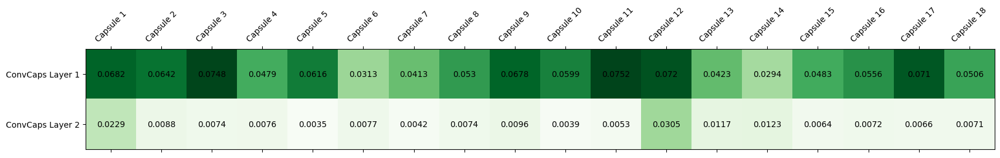

In [ ]:
utils.plot_caps_layers_activations(capsnet_inter2_convcaps_activations,
                                   n_caps=capsnet_inter2_convcaps_activations['intermediate_convcaps_layer_1'].shape[0],
                                   n_caps_layers=n_caps_layers, text_en=1)

#### Plots for losses and accuracies

In [ ]:
multilayer_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Trained_pruned_12pc_multilayer_inter2_capsnet_cifar10_model_Epoch15_of_15.pt')

epoch_loss = multilayer_capsnet_cifar10_model['epoch_loss']
epoch_accuracy = multilayer_capsnet_cifar10_model['epoch_accuracy']

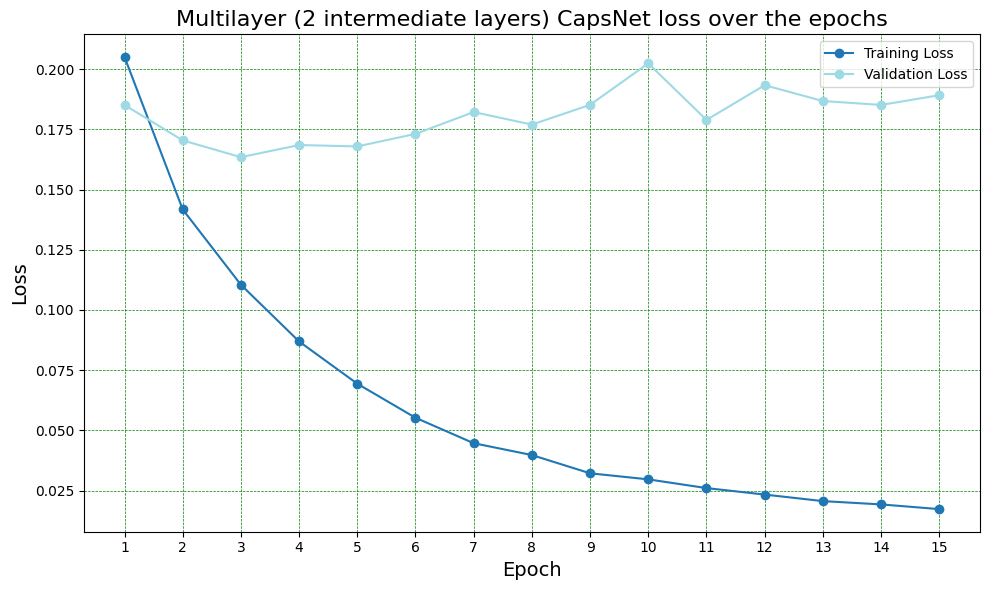

In [ ]:
utils.plot_line_chart(epoch_loss, ['Training Loss', 'Validation Loss'], 'Epoch', 'Loss',
                      'Multilayer (2 intermediate layers) CapsNet loss over the epochs')

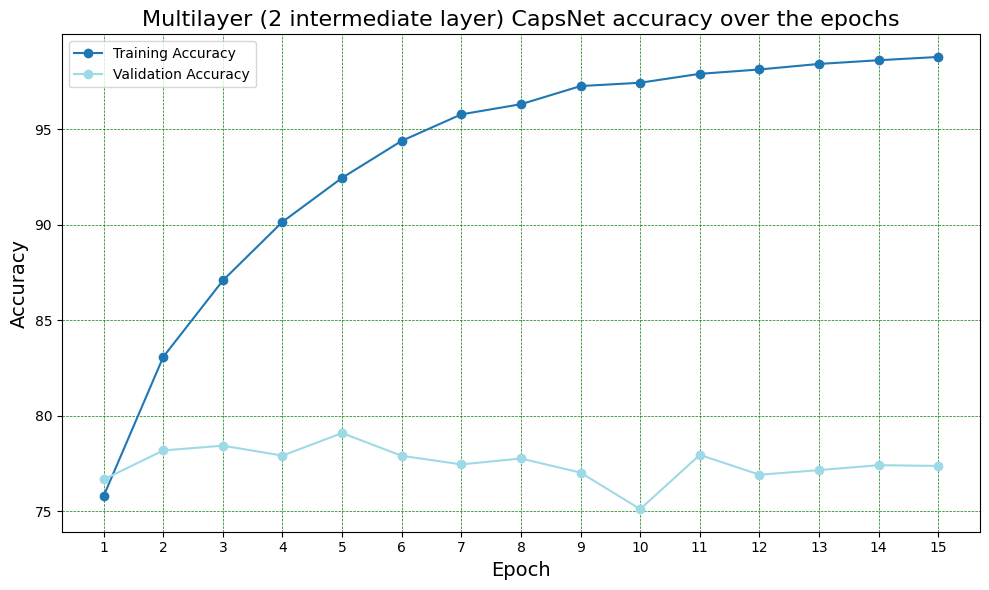

In [ ]:
utils.plot_line_chart(epoch_accuracy, ['Training Accuracy', 'Validation Accuracy'], 'Epoch', 'Accuracy',
                      'Multilayer (2 intermediate layer) CapsNet accuracy over the epochs')

### 25% Pruned Base CapsNet with Intermediate Layers

In [ ]:
pruned_model_type = 25

best_pruned_base_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_{}pc_base_capsnet_cifar10_model.pt'.format(pruned_model_type))

pruned_multilayer_inter2_capsnet_cifar10_model = ccmp.create_pruned_model_from_state_dict(
    new_model = multilayer_inter2_capsnet_cifar10_model,
    saved_state_dict = best_pruned_base_capsnet_cifar10_model['model_state_dict'],
    model_conv_config_dict = model_conv_config, n_class = n_class, n_caps_layers = n_caps_layers,
    prim_caps_dim = prim_caps_dim, base_capsnet_stdict = True)

pruned_multilayer_inter2_capsnet_cifar10_model.name = 'pruned_{}pc_multilayer_inter2_capsnet_cifar10_model'.format(pruned_model_type)
pruned_multilayer_inter2_capsnet_cifar10_model = pruned_multilayer_inter2_capsnet_cifar10_model.to(device)
pruned_multilayer_inter2_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(64, 120, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(120, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(120, 120, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
  )
  (class_caps): CapsLayer()
)

In [ ]:
%%time
n_epochs = 15
best_trained_model_path, _, _ = mtt.train_capsnet(n_epochs,
                                                  pruned_multilayer_inter2_capsnet_cifar10_model,
                                                  criterion,
                                                  train_loader,
                                                  test_loader,
                                                  CIFAR10_TRAIN_DIR,
                                                  logger,
                                                  device=device)

02/29 01:05:53 AM | pruned_25pc_multilayer_inter2_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.9658, Top 1 Acc=9.38, Top 5 Acc=50.00
INFO:capsnet:pruned_25pc_multilayer_inter2_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.9658, Top 1 Acc=9.38, Top 5 Acc=50.00
02/29 01:05:59 AM | pruned_25pc_multilayer_inter2_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.4917, Top 1 Acc=28.41, Top 5 Acc=74.81
INFO:capsnet:pruned_25pc_multilayer_inter2_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.4917, Top 1 Acc=28.41, Top 5 Acc=74.81
02/29 01:06:07 AM | pruned_25pc_multilayer_inter2_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.4167, Top 1 Acc=43.08, Top 5 Acc=83.61
INFO:capsnet:pruned_25pc_multilayer_inter2_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.4167, Top 1 Acc=43.08, Top 5 Acc=83.61
02/29 01:06:13 AM | pruned_25pc_multilayer_inter2_capsnet_cifar10_model

CPU times: user 1h 23min 1s, sys: 3min 43s, total: 1h 26min 45s
Wall time: 1h 27min 36s


#### Export ConvCaps Activation

In [ ]:
pruned_trained_multilayer_inter2_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_25pc_multilayer_inter2_capsnet_cifar10_model.pt')

pruned_multilayer_inter2_capsnet_cifar10_model.load_state_dict(pruned_trained_multilayer_inter2_capsnet_cifar10_model['model_state_dict'])

pruned_multilayer_inter2_capsnet_cifar10_model.name = 'best_pruned_25pc_multilayer_inter2_capsnet_cifar10_model'
pruned_multilayer_inter2_capsnet_cifar10_model = pruned_multilayer_inter2_capsnet_cifar10_model.to(device)
pruned_multilayer_inter2_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(64, 120, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(120, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(120, 120, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
  )
  (class_caps): CapsLayer()
)

In [ ]:
capsnet_inter2_convcaps_activations = utils.extract_convcaps_activations(pruned_multilayer_inter2_capsnet_cifar10_model,
                                                                         test_loader, logger, CIFAR10_TRAIN_DIR, device)

02/29 03:02:01 AM | best_pruned_25pc_multilayer_inter2_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=87.500, Top 5 Acc=96.875
INFO:capsnet:best_pruned_25pc_multilayer_inter2_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=87.500, Top 5 Acc=96.875
02/29 03:02:01 AM | best_pruned_25pc_multilayer_inter2_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=73.438, Top 5 Acc=96.875
INFO:capsnet:best_pruned_25pc_multilayer_inter2_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=73.438, Top 5 Acc=96.875
02/29 03:02:01 AM | best_pruned_25pc_multilayer_inter2_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=75.000, Top 5 Acc=96.875
INFO:capsnet:best_pruned_25pc_multilayer_inter2_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=75.000, Top 5 Acc=96.875
02/29 03:02:01 AM | best_pruned_25pc_multilayer_inter2_capsnet_cifar10_model - Iterations=4/313, Batch Size=32, Top 1 Acc=79.688, Top 5 Acc

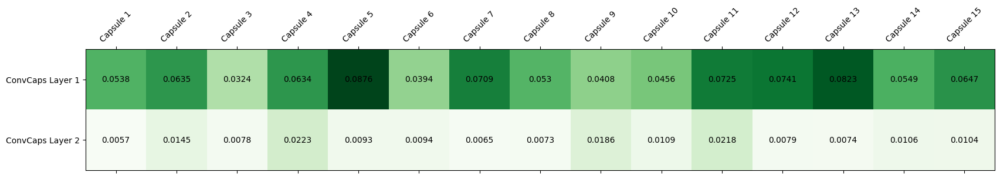

In [ ]:
utils.plot_caps_layers_activations(capsnet_inter2_convcaps_activations,
                                   n_caps=capsnet_inter2_convcaps_activations['intermediate_convcaps_layer_1'].shape[0],
                                   n_caps_layers=n_caps_layers, text_en=1)

#### Plots for losses and accuracies

In [ ]:
multilayer_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Trained_pruned_25pc_multilayer_inter2_capsnet_cifar10_model_Epoch15_of_15.pt')

epoch_loss = multilayer_capsnet_cifar10_model['epoch_loss']
epoch_accuracy = multilayer_capsnet_cifar10_model['epoch_accuracy']

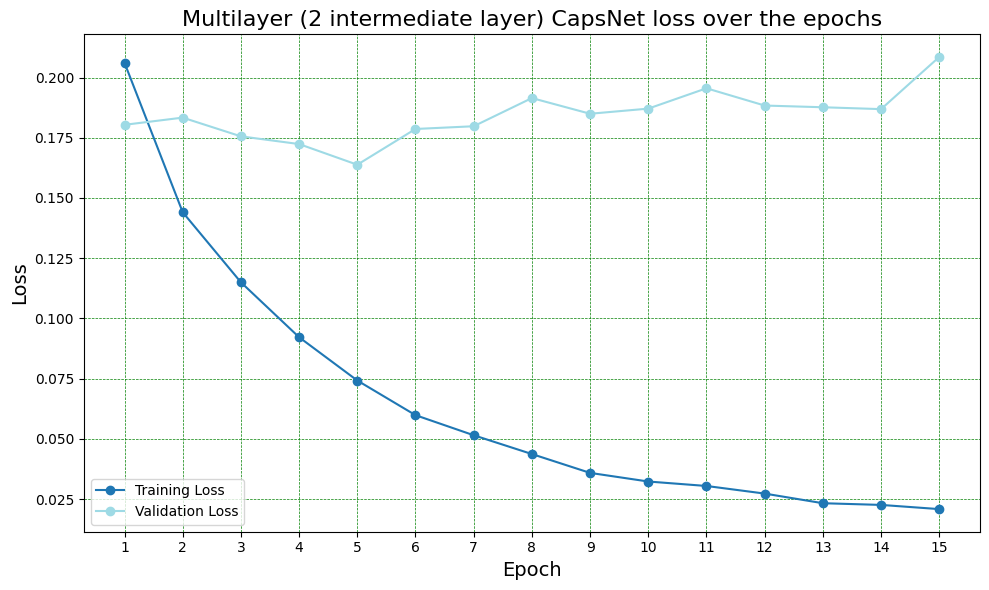

In [ ]:
utils.plot_line_chart(epoch_loss, ['Training Loss', 'Validation Loss'], 'Epoch', 'Loss',
                      'Multilayer (2 intermediate layer) CapsNet loss over the epochs')

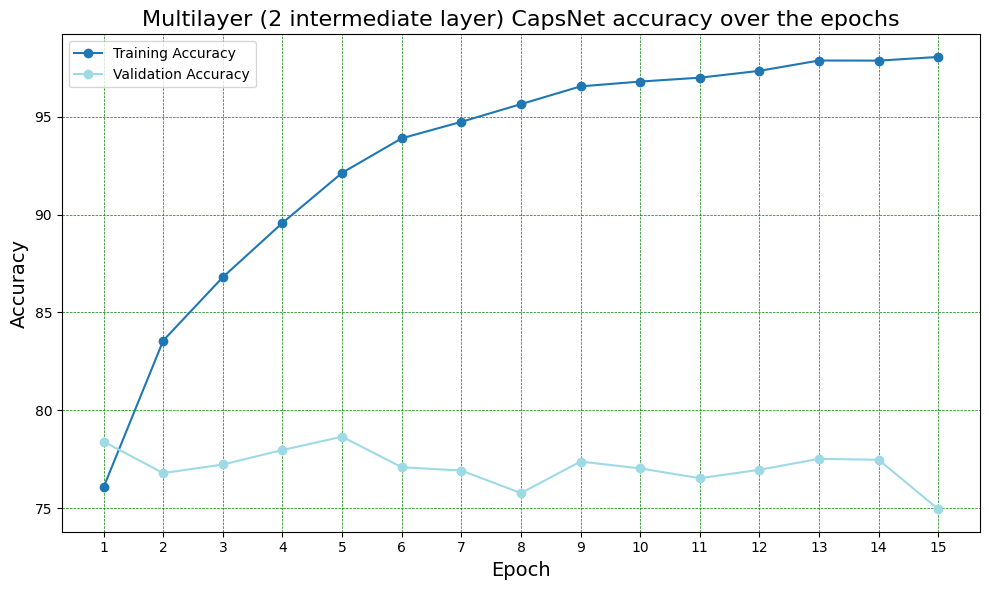

In [ ]:
utils.plot_line_chart(epoch_accuracy, ['Training Accuracy', 'Validation Accuracy'], 'Epoch', 'Accuracy',
                      'Multilayer (2 intermediate layer) CapsNet accuracy over the epochs')

In [ ]:
time.sleep(5)

from google.colab import runtime
runtime.unassign()

### 37.5% Pruned Base CapsNet with Intermediate Layers

In [ ]:
pruned_model_type = 37

best_pruned_base_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_{}pc_base_capsnet_cifar10_model.pt'.format(pruned_model_type))

pruned_multilayer_inter2_capsnet_cifar10_model = ccmp.create_pruned_model_from_state_dict(
    new_model = multilayer_inter2_capsnet_cifar10_model,
    saved_state_dict = best_pruned_base_capsnet_cifar10_model['model_state_dict'],
    model_conv_config_dict = model_conv_config, n_class = n_class, n_caps_layers = n_caps_layers,
    prim_caps_dim = prim_caps_dim, base_capsnet_stdict = True)

pruned_multilayer_inter2_capsnet_cifar10_model.name = 'pruned_{}pc_multilayer_inter2_capsnet_cifar10_model'.format(pruned_model_type)
pruned_multilayer_inter2_capsnet_cifar10_model = pruned_multilayer_inter2_capsnet_cifar10_model.to(device)
pruned_multilayer_inter2_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 56, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(56, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(56, 104, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(104, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(104, 104, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
  )
  (class_caps): CapsLayer()
)

In [ ]:
%%time
n_epochs = 15
best_trained_model_path, _, _ = mtt.train_capsnet(n_epochs,
                                                  pruned_multilayer_inter2_capsnet_cifar10_model,
                                                  criterion,
                                                  train_loader,
                                                  test_loader,
                                                  CIFAR10_TRAIN_DIR,
                                                  logger,
                                                  device=device)

02/29 03:05:57 AM | pruned_37pc_multilayer_inter2_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.6481, Top 1 Acc=3.12, Top 5 Acc=43.75
INFO:capsnet:pruned_37pc_multilayer_inter2_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.6481, Top 1 Acc=3.12, Top 5 Acc=43.75
02/29 03:06:03 AM | pruned_37pc_multilayer_inter2_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.4383, Top 1 Acc=37.97, Top 5 Acc=83.62
INFO:capsnet:pruned_37pc_multilayer_inter2_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.4383, Top 1 Acc=37.97, Top 5 Acc=83.62
02/29 03:06:10 AM | pruned_37pc_multilayer_inter2_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.3820, Top 1 Acc=49.13, Top 5 Acc=88.08
INFO:capsnet:pruned_37pc_multilayer_inter2_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.3820, Top 1 Acc=49.13, Top 5 Acc=88.08
02/29 03:06:18 AM | pruned_37pc_multilayer_inter2_capsnet_cifar10_model

CPU times: user 1h 12min 14s, sys: 3min 40s, total: 1h 15min 54s
Wall time: 1h 16min 38s


#### Export ConvCaps Activation

In [ ]:
pruned_trained_multilayer_inter2_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_37pc_multilayer_inter2_capsnet_cifar10_model.pt')

pruned_multilayer_inter2_capsnet_cifar10_model.load_state_dict(pruned_trained_multilayer_inter2_capsnet_cifar10_model['model_state_dict'])

pruned_multilayer_inter2_capsnet_cifar10_model.name = 'best_pruned_37pc_multilayer_inter2_capsnet_cifar10_model'
pruned_multilayer_inter2_capsnet_cifar10_model = pruned_multilayer_inter2_capsnet_cifar10_model.to(device)
pruned_multilayer_inter2_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 56, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(56, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(56, 104, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(104, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(104, 104, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
  )
  (class_caps): CapsLayer()
)

In [ ]:
capsnet_inter2_convcaps_activations = utils.extract_convcaps_activations(pruned_multilayer_inter2_capsnet_cifar10_model,
                                                                         test_loader, logger, CIFAR10_TRAIN_DIR, device)

02/29 04:22:35 AM | best_pruned_37pc_multilayer_inter2_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=90.625, Top 5 Acc=100.000
INFO:capsnet:best_pruned_37pc_multilayer_inter2_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=90.625, Top 5 Acc=100.000
02/29 04:22:36 AM | best_pruned_37pc_multilayer_inter2_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=70.312, Top 5 Acc=96.875
INFO:capsnet:best_pruned_37pc_multilayer_inter2_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=70.312, Top 5 Acc=96.875
02/29 04:22:36 AM | best_pruned_37pc_multilayer_inter2_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=77.083, Top 5 Acc=97.917
INFO:capsnet:best_pruned_37pc_multilayer_inter2_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=77.083, Top 5 Acc=97.917
02/29 04:22:36 AM | best_pruned_37pc_multilayer_inter2_capsnet_cifar10_model - Iterations=4/313, Batch Size=32, Top 1 Acc=80.469, Top 5 A

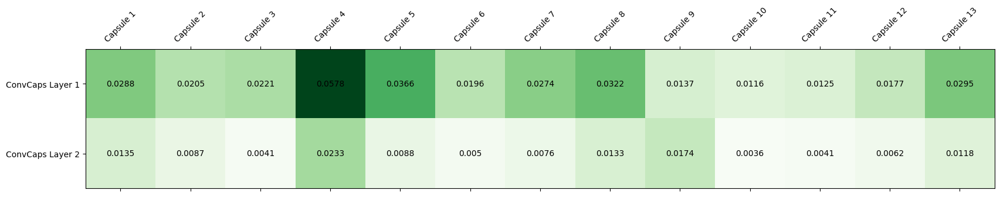

In [ ]:
utils.plot_caps_layers_activations(capsnet_inter2_convcaps_activations,
                                   n_caps=capsnet_inter2_convcaps_activations['intermediate_convcaps_layer_1'].shape[0],
                                   n_caps_layers=n_caps_layers, text_en=1)

#### Plots for losses and accuracies

In [ ]:
multilayer_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Trained_pruned_37pc_multilayer_inter2_capsnet_cifar10_model_Epoch15_of_15.pt')

epoch_loss = multilayer_capsnet_cifar10_model['epoch_loss']
epoch_accuracy = multilayer_capsnet_cifar10_model['epoch_accuracy']

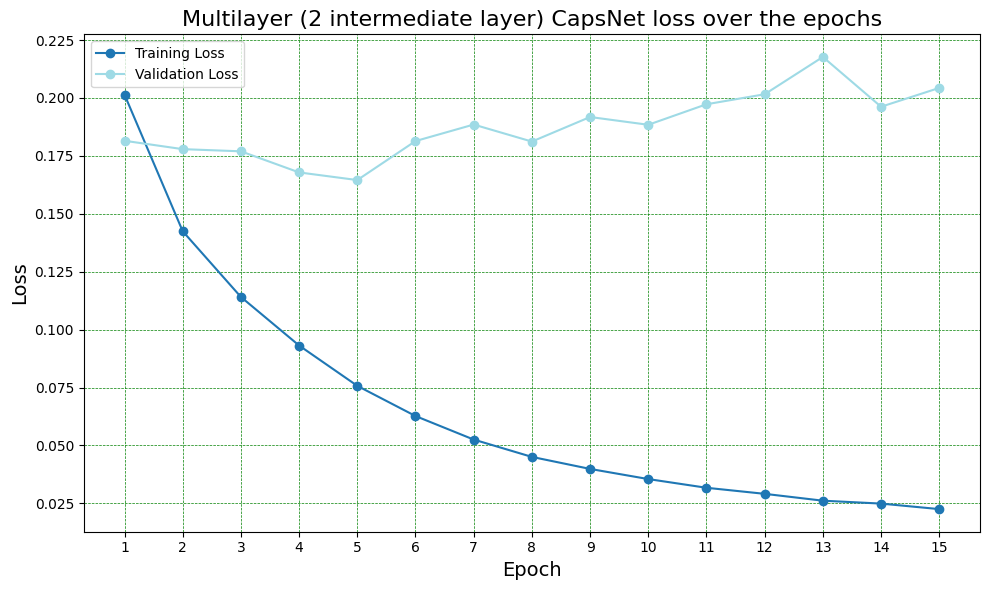

In [ ]:
utils.plot_line_chart(epoch_loss, ['Training Loss', 'Validation Loss'], 'Epoch', 'Loss',
                      'Multilayer (2 intermediate layer) CapsNet loss over the epochs')

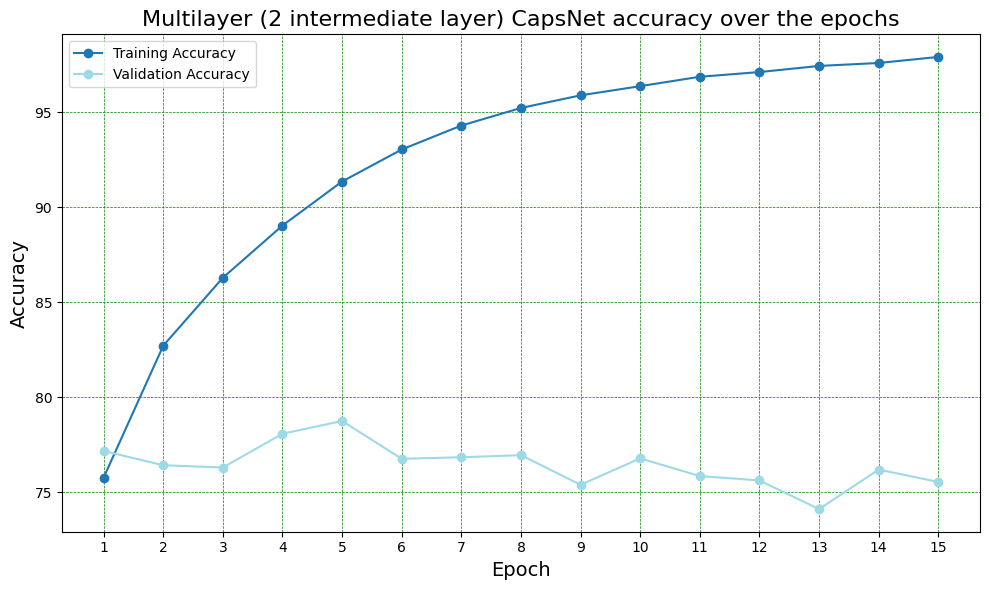

In [ ]:
utils.plot_line_chart(epoch_accuracy, ['Training Accuracy', 'Validation Accuracy'], 'Epoch', 'Accuracy',
                      'Multilayer (2 intermediate layer) CapsNet accuracy over the epochs')

In [ ]:
time.sleep(5)

from google.colab import runtime
runtime.unassign()

## 3 Intermediate Layered CapsNet

In [ ]:
CIFAR10_TRAIN_DIR = TRAIN_DIR+"cifar10/20Caps8Dim/"
batch_size=32
n_epochs=15
n_class=10

n_caps_layers=3
prim_caps_channels=20
prim_caps_dim=8

model_conv_config = {'in_img_h':32,
                     'in_img_w':32,
                     'in_img_c':3,
                     'kernel_size':[3, 3, 3, 3],
                     'stride':[1, 2, 1, 2],
                     'padding':[1, 1, 1, 0]}

train_loader, test_loader = image_dataloader(dataset='cifar10', batch_size=batch_size)

criterion = caps.CapsNetLoss(n_class=n_class)

100%|██████████| 170498071/170498071 [01:16<00:00, 2222466.09it/s]


Extracting ./data/cifar-10-python.tar.gz to ./data
Files already downloaded and verified


In [ ]:
multilayer_inter3_capsnet_cifar10_model = caps.CapsuleNetwork(in_img_c=3, in_img_h=32, in_img_w=32, n_class=n_class,
                                                               model_conv_config=model_conv_config, prim_caps_channels=prim_caps_channels,
                                                               prim_caps_dim=prim_caps_dim, n_caps_layers=n_caps_layers)

multilayer_inter3_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 40, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(40, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(40, 80, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(80, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(80, 160, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(160, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(160, 160, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
  )
  (class_caps): 

### 12.5% Pruned Base CapsNet with Intermediate Layers

In [ ]:
pruned_model_type = 12

best_pruned_base_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_{}pc_base_capsnet_cifar10_model.pt'.format(pruned_model_type))

pruned_multilayer_inter3_capsnet_cifar10_model = ccmp.create_pruned_model_from_state_dict(
    new_model = multilayer_inter3_capsnet_cifar10_model,
    saved_state_dict = best_pruned_base_capsnet_cifar10_model['model_state_dict'],
    model_conv_config_dict = model_conv_config, n_class = n_class, n_caps_layers = n_caps_layers,
    prim_caps_dim = prim_caps_dim, base_capsnet_stdict = True)

pruned_multilayer_inter3_capsnet_cifar10_model.name = 'pruned_{}pc_multilayer_inter3_capsnet_cifar10_model'.format(pruned_model_type)
pruned_multilayer_inter3_capsnet_cifar10_model = pruned_multilayer_inter3_capsnet_cifar10_model.to(device)
pruned_multilayer_inter3_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 72, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(72, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(72, 144, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(144, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(144, 144, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
  )
  (class_caps): 

In [ ]:
%%time
best_trained_model_path, _, _ = mtt.train_capsnet(n_epochs,
                                                  pruned_multilayer_inter3_capsnet_cifar10_model,
                                                  criterion,
                                                  train_loader,
                                                  test_loader,
                                                  CIFAR10_TRAIN_DIR,
                                                  logger,
                                                  device=device)

02/29 02:25:50 PM | pruned_12pc_multilayer_inter3_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.6302, Top 1 Acc=6.25, Top 5 Acc=53.12
INFO:capsnet:pruned_12pc_multilayer_inter3_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.6302, Top 1 Acc=6.25, Top 5 Acc=53.12
02/29 02:25:57 PM | pruned_12pc_multilayer_inter3_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.4665, Top 1 Acc=31.44, Top 5 Acc=77.75
INFO:capsnet:pruned_12pc_multilayer_inter3_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.4665, Top 1 Acc=31.44, Top 5 Acc=77.75
02/29 02:26:04 PM | pruned_12pc_multilayer_inter3_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.3968, Top 1 Acc=44.76, Top 5 Acc=86.35
INFO:capsnet:pruned_12pc_multilayer_inter3_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.3968, Top 1 Acc=44.76, Top 5 Acc=86.35
02/29 02:26:10 PM | pruned_12pc_multilayer_inter3_capsnet_cifar10_model

CPU times: user 1h 15min 52s, sys: 4min 46s, total: 1h 20min 39s
Wall time: 1h 21min 17s


#### Export ConvCaps Activation

In [ ]:
pruned_trained_multilayer_inter3_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_12pc_multilayer_inter3_capsnet_cifar10_model.pt')

pruned_multilayer_inter3_capsnet_cifar10_model.load_state_dict(pruned_trained_multilayer_inter3_capsnet_cifar10_model['model_state_dict'])

pruned_multilayer_inter3_capsnet_cifar10_model.name = 'best_pruned_12pc_multilayer_inter3_capsnet_cifar10_model'
pruned_multilayer_inter3_capsnet_cifar10_model = pruned_multilayer_inter3_capsnet_cifar10_model.to(device)
pruned_multilayer_inter3_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 72, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(72, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(72, 144, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(144, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(144, 144, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
  )
  (class_caps): 

In [ ]:
capsnet_inter3_convcaps_activations = utils.extract_convcaps_activations(pruned_multilayer_inter3_capsnet_cifar10_model,
                                                                         test_loader, logger, CIFAR10_TRAIN_DIR, device)

02/29 03:47:05 PM | best_pruned_12pc_multilayer_inter3_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=87.500, Top 5 Acc=100.000
INFO:capsnet:best_pruned_12pc_multilayer_inter3_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=87.500, Top 5 Acc=100.000
02/29 03:47:05 PM | best_pruned_12pc_multilayer_inter3_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=73.438, Top 5 Acc=96.875
INFO:capsnet:best_pruned_12pc_multilayer_inter3_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=73.438, Top 5 Acc=96.875
02/29 03:47:05 PM | best_pruned_12pc_multilayer_inter3_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=75.000, Top 5 Acc=97.917
INFO:capsnet:best_pruned_12pc_multilayer_inter3_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=75.000, Top 5 Acc=97.917
02/29 03:47:05 PM | best_pruned_12pc_multilayer_inter3_capsnet_cifar10_model - Iterations=4/313, Batch Size=32, Top 1 Acc=78.125, Top 5 A

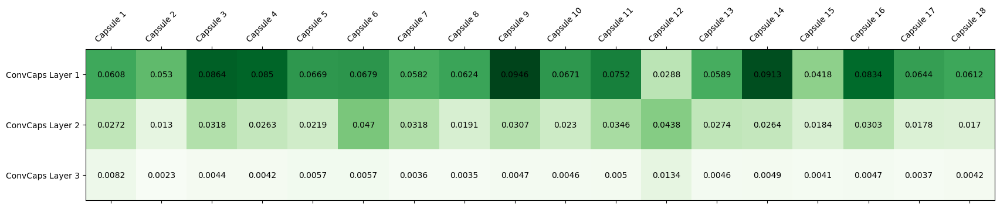

In [ ]:
utils.plot_caps_layers_activations(capsnet_inter3_convcaps_activations,
                                   n_caps=capsnet_inter3_convcaps_activations['intermediate_convcaps_layer_1'].shape[0],
                                   n_caps_layers=n_caps_layers, text_en=1)

#### Plots for losses and accuracies

In [ ]:
multilayer_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Trained_pruned_12pc_multilayer_inter3_capsnet_cifar10_model_Epoch15_of_15.pt')

epoch_loss = multilayer_capsnet_cifar10_model['epoch_loss']
epoch_accuracy = multilayer_capsnet_cifar10_model['epoch_accuracy']

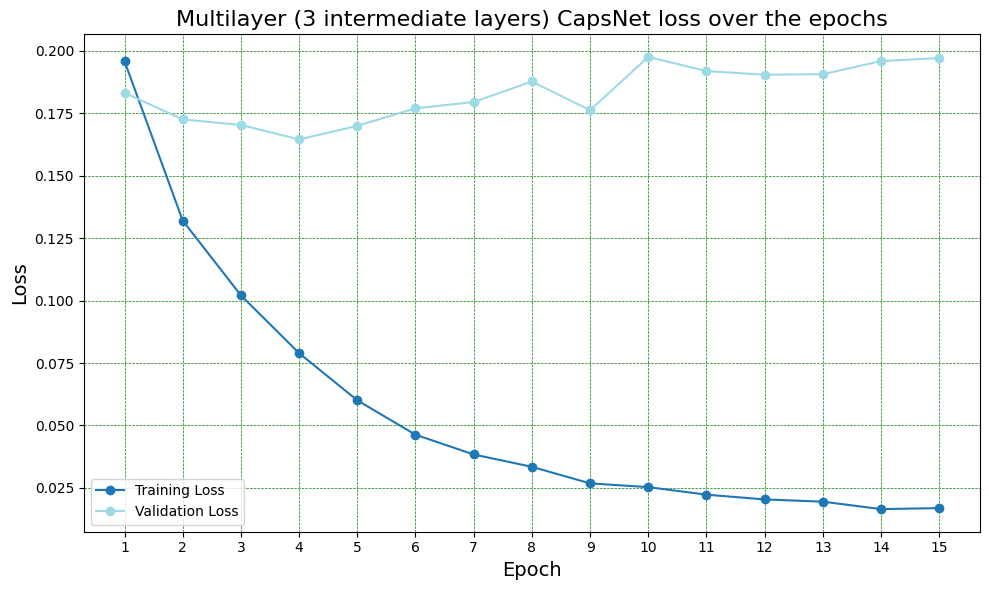

In [ ]:
utils.plot_line_chart(epoch_loss, ['Training Loss', 'Validation Loss'], 'Epoch', 'Loss',
                      'Multilayer (3 intermediate layers) CapsNet loss over the epochs')

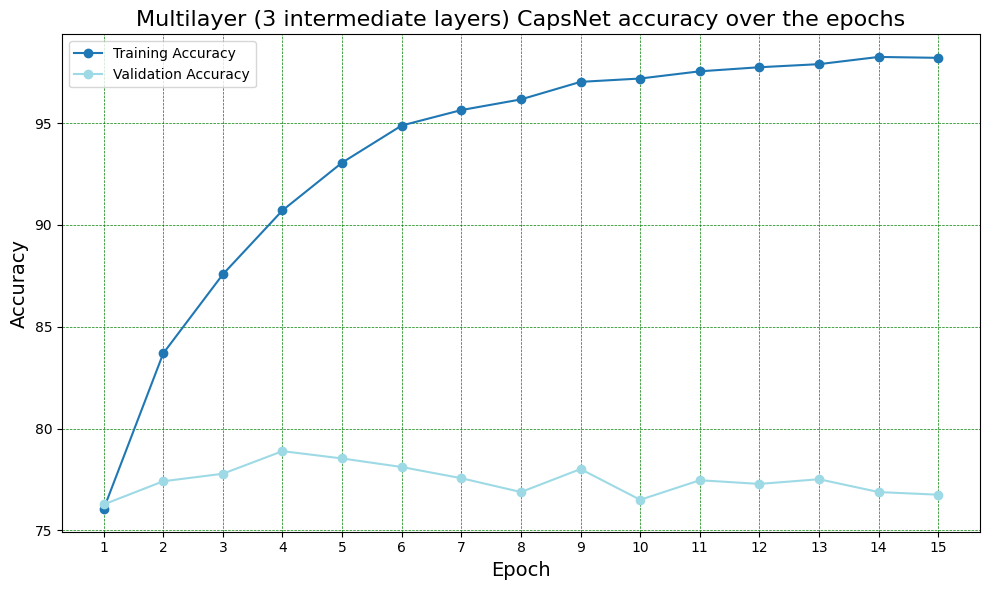

In [ ]:
utils.plot_line_chart(epoch_accuracy, ['Training Accuracy', 'Validation Accuracy'], 'Epoch', 'Accuracy',
                      'Multilayer (3 intermediate layers) CapsNet accuracy over the epochs')

### 25% Pruned Base CapsNet with Intermediate Layers

In [ ]:
pruned_model_type = 25

best_pruned_base_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_{}pc_base_capsnet_cifar10_model.pt'.format(pruned_model_type))

pruned_multilayer_inter3_capsnet_cifar10_model = ccmp.create_pruned_model_from_state_dict(
    new_model = multilayer_inter3_capsnet_cifar10_model,
    saved_state_dict = best_pruned_base_capsnet_cifar10_model['model_state_dict'],
    model_conv_config_dict = model_conv_config, n_class = n_class, n_caps_layers = n_caps_layers,
    prim_caps_dim = prim_caps_dim, base_capsnet_stdict = True)

pruned_multilayer_inter3_capsnet_cifar10_model.name = 'pruned_{}pc_multilayer_inter3_capsnet_cifar10_model'.format(pruned_model_type)
pruned_multilayer_inter3_capsnet_cifar10_model = pruned_multilayer_inter3_capsnet_cifar10_model.to(device)
pruned_multilayer_inter3_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(64, 120, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(120, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(120, 120, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
  )
  (class_caps): 

In [ ]:
%%time
n_epochs = 15
best_trained_model_path, _, _ = mtt.train_capsnet(n_epochs,
                                                  pruned_multilayer_inter3_capsnet_cifar10_model,
                                                  criterion,
                                                  train_loader,
                                                  test_loader,
                                                  CIFAR10_TRAIN_DIR,
                                                  logger,
                                                  device=device)

02/29 03:50:45 PM | pruned_25pc_multilayer_inter3_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.7597, Top 1 Acc=12.50, Top 5 Acc=46.88
INFO:capsnet:pruned_25pc_multilayer_inter3_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.7597, Top 1 Acc=12.50, Top 5 Acc=46.88
02/29 03:50:51 PM | pruned_25pc_multilayer_inter3_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.4551, Top 1 Acc=35.23, Top 5 Acc=80.97
INFO:capsnet:pruned_25pc_multilayer_inter3_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.4551, Top 1 Acc=35.23, Top 5 Acc=80.97
02/29 03:50:56 PM | pruned_25pc_multilayer_inter3_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.3967, Top 1 Acc=45.87, Top 5 Acc=86.54
INFO:capsnet:pruned_25pc_multilayer_inter3_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.3967, Top 1 Acc=45.87, Top 5 Acc=86.54
02/29 03:51:03 PM | pruned_25pc_multilayer_inter3_capsnet_cifar10_mod

CPU times: user 1h 8min 3s, sys: 4min 47s, total: 1h 12min 51s
Wall time: 1h 13min 56s


#### Export ConvCaps Activation

In [ ]:
pruned_trained_multilayer_inter3_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_25pc_multilayer_inter3_capsnet_cifar10_model.pt')

pruned_multilayer_inter3_capsnet_cifar10_model.load_state_dict(pruned_trained_multilayer_inter3_capsnet_cifar10_model['model_state_dict'])

pruned_multilayer_inter3_capsnet_cifar10_model.name = 'best_pruned_25pc_multilayer_inter3_capsnet_cifar10_model'
pruned_multilayer_inter3_capsnet_cifar10_model = pruned_multilayer_inter3_capsnet_cifar10_model.to(device)
pruned_multilayer_inter3_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(64, 120, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(120, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(120, 120, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
  )
  (class_caps): 

In [ ]:
capsnet_inter3_convcaps_activations = utils.extract_convcaps_activations(pruned_multilayer_inter3_capsnet_cifar10_model,
                                                                         test_loader, logger, CIFAR10_TRAIN_DIR, device)

02/29 05:04:41 PM | best_pruned_25pc_multilayer_inter3_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=81.250, Top 5 Acc=100.000
INFO:capsnet:best_pruned_25pc_multilayer_inter3_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=81.250, Top 5 Acc=100.000
02/29 05:04:42 PM | best_pruned_25pc_multilayer_inter3_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=71.875, Top 5 Acc=95.312
INFO:capsnet:best_pruned_25pc_multilayer_inter3_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=71.875, Top 5 Acc=95.312
02/29 05:04:42 PM | best_pruned_25pc_multilayer_inter3_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=73.958, Top 5 Acc=95.833
INFO:capsnet:best_pruned_25pc_multilayer_inter3_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=73.958, Top 5 Acc=95.833
02/29 05:04:42 PM | best_pruned_25pc_multilayer_inter3_capsnet_cifar10_model - Iterations=4/313, Batch Size=32, Top 1 Acc=75.000, Top 5 A

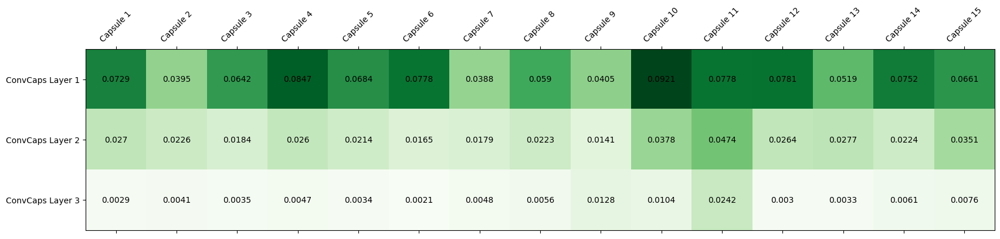

In [ ]:
utils.plot_caps_layers_activations(capsnet_inter3_convcaps_activations,
                                   n_caps=capsnet_inter3_convcaps_activations['intermediate_convcaps_layer_1'].shape[0],
                                   n_caps_layers=n_caps_layers, text_en=1)

#### Plots for losses and accuracies

In [ ]:
multilayer_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Trained_pruned_25pc_multilayer_inter3_capsnet_cifar10_model_Epoch15_of_15.pt')

epoch_loss = multilayer_capsnet_cifar10_model['epoch_loss']
epoch_accuracy = multilayer_capsnet_cifar10_model['epoch_accuracy']

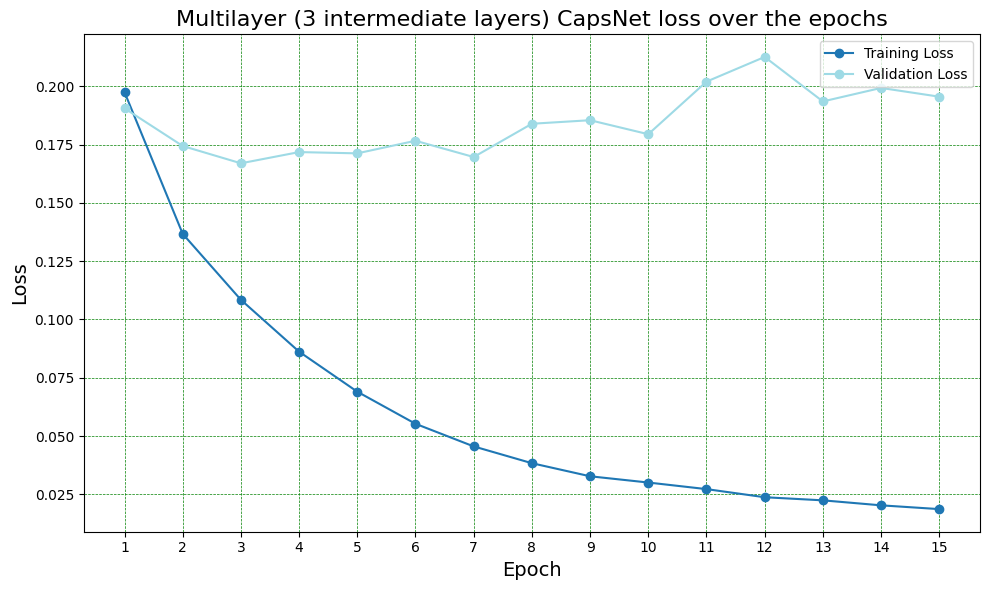

In [ ]:
utils.plot_line_chart(epoch_loss, ['Training Loss', 'Validation Loss'], 'Epoch', 'Loss',
                      'Multilayer (3 intermediate layers) CapsNet loss over the epochs')

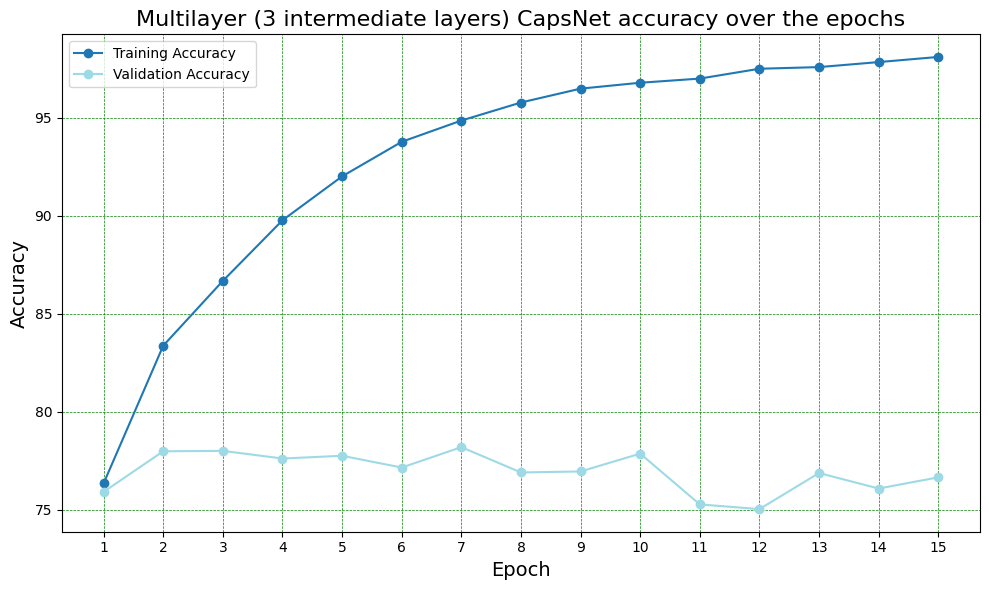

In [ ]:
utils.plot_line_chart(epoch_accuracy, ['Training Accuracy', 'Validation Accuracy'], 'Epoch', 'Accuracy',
                      'Multilayer (3 intermediate layers) CapsNet accuracy over the epochs')

In [ ]:
time.sleep(5)

from google.colab import runtime
runtime.unassign()

## 4 Intermediate Layered CapsNet

In [ ]:
CIFAR10_TRAIN_DIR = TRAIN_DIR+"cifar10/20Caps8Dim/"
batch_size=32
n_epochs=15
n_class=10

n_caps_layers=4
prim_caps_channels=20
prim_caps_dim=8

model_conv_config = {'in_img_h':32,
                     'in_img_w':32,
                     'in_img_c':3,
                     'kernel_size':[3, 3, 3, 3],
                     'stride':[1, 2, 1, 2],
                     'padding':[1, 1, 1, 0]}

train_loader, test_loader = image_dataloader(dataset='cifar10', batch_size=batch_size)

criterion = caps.CapsNetLoss(n_class=n_class)

Files already downloaded and verified
Files already downloaded and verified


In [ ]:
multilayer_inter4_capsnet_cifar10_model = caps.CapsuleNetwork(in_img_c=3, in_img_h=32, in_img_w=32, n_class=n_class,
                                                               model_conv_config=model_conv_config, prim_caps_channels=prim_caps_channels,
                                                               prim_caps_dim=prim_caps_dim, n_caps_layers=n_caps_layers)

multilayer_inter4_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 40, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(40, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(40, 80, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(80, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(80, 160, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(160, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(160, 160, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
    (intermediate_co

### 12.5% Pruned Base CapsNet with Intermediate Layers

In [ ]:
pruned_model_type = 12

best_pruned_base_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_{}pc_base_capsnet_cifar10_model.pt'.format(pruned_model_type))

pruned_multilayer_inter4_capsnet_cifar10_model = ccmp.create_pruned_model_from_state_dict(
    new_model = multilayer_inter4_capsnet_cifar10_model,
    saved_state_dict = best_pruned_base_capsnet_cifar10_model['model_state_dict'],
    model_conv_config_dict = model_conv_config, n_class = n_class, n_caps_layers = n_caps_layers,
    prim_caps_dim = prim_caps_dim, base_capsnet_stdict = True)

pruned_multilayer_inter4_capsnet_cifar10_model.name = 'pruned_{}pc_multilayer_inter{}_capsnet_cifar10_model'.format(pruned_model_type, n_caps_layers)
pruned_multilayer_inter4_capsnet_cifar10_model = pruned_multilayer_inter4_capsnet_cifar10_model.to(device)
pruned_multilayer_inter4_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 72, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(72, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(72, 144, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(144, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(144, 144, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
    (intermediate_co

In [ ]:
%%time
best_trained_model_path, _, _ = mtt.train_capsnet(n_epochs,
                                                  pruned_multilayer_inter4_capsnet_cifar10_model,
                                                  criterion,
                                                  train_loader,
                                                  test_loader,
                                                  CIFAR10_TRAIN_DIR,
                                                  logger,
                                                  device=device)

02/29 05:04:58 PM | pruned_12pc_multilayer_inter4_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.5764, Top 1 Acc=6.25, Top 5 Acc=43.75
INFO:capsnet:pruned_12pc_multilayer_inter4_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.5764, Top 1 Acc=6.25, Top 5 Acc=43.75
02/29 05:05:07 PM | pruned_12pc_multilayer_inter4_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.4485, Top 1 Acc=36.27, Top 5 Acc=80.49
INFO:capsnet:pruned_12pc_multilayer_inter4_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.4485, Top 1 Acc=36.27, Top 5 Acc=80.49
02/29 05:05:15 PM | pruned_12pc_multilayer_inter4_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.3822, Top 1 Acc=48.27, Top 5 Acc=88.08
INFO:capsnet:pruned_12pc_multilayer_inter4_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.3822, Top 1 Acc=48.27, Top 5 Acc=88.08
02/29 05:05:23 PM | pruned_12pc_multilayer_inter4_capsnet_cifar10_model

CPU times: user 1h 38min 31s, sys: 5min 53s, total: 1h 44min 24s
Wall time: 1h 45min 4s


#### Export ConvCaps Activation

In [ ]:
pruned_trained_multilayer_inter4_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_12pc_multilayer_inter4_capsnet_cifar10_model.pt')

pruned_multilayer_inter4_capsnet_cifar10_model.load_state_dict(pruned_trained_multilayer_inter4_capsnet_cifar10_model['model_state_dict'])

pruned_multilayer_inter4_capsnet_cifar10_model.name = 'best_pruned_12pc_multilayer_inter4_capsnet_cifar10_model'
pruned_multilayer_inter4_capsnet_cifar10_model = pruned_multilayer_inter4_capsnet_cifar10_model.to(device)
pruned_multilayer_inter4_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 72, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(72, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(72, 144, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(144, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(144, 144, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
    (intermediate_co

In [ ]:
capsnet_inter4_convcaps_activations = utils.extract_convcaps_activations(pruned_multilayer_inter4_capsnet_cifar10_model,
                                                                         test_loader, logger, CIFAR10_TRAIN_DIR, device)

02/29 06:50:02 PM | best_pruned_12pc_multilayer_inter4_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=93.750, Top 5 Acc=96.875
INFO:capsnet:best_pruned_12pc_multilayer_inter4_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=93.750, Top 5 Acc=96.875
02/29 06:50:02 PM | best_pruned_12pc_multilayer_inter4_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=78.125, Top 5 Acc=93.750
INFO:capsnet:best_pruned_12pc_multilayer_inter4_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=78.125, Top 5 Acc=93.750
02/29 06:50:02 PM | best_pruned_12pc_multilayer_inter4_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=79.167, Top 5 Acc=95.833
INFO:capsnet:best_pruned_12pc_multilayer_inter4_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=79.167, Top 5 Acc=95.833
02/29 06:50:02 PM | best_pruned_12pc_multilayer_inter4_capsnet_cifar10_model - Iterations=4/313, Batch Size=32, Top 1 Acc=81.250, Top 5 Acc

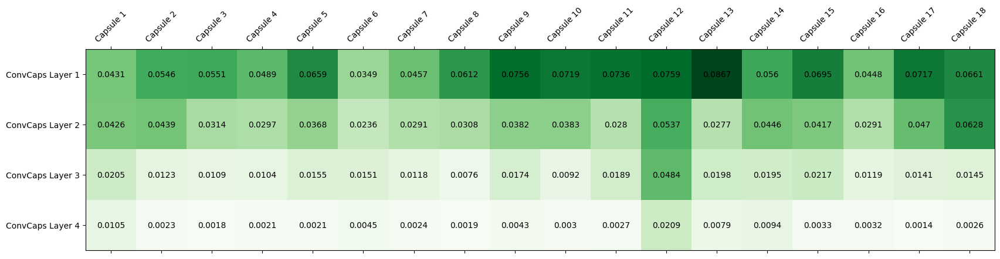

In [ ]:
utils.plot_caps_layers_activations(capsnet_inter4_convcaps_activations,
                                   n_caps=capsnet_inter4_convcaps_activations['intermediate_convcaps_layer_1'].shape[0],
                                   n_caps_layers=n_caps_layers, text_en=1)

#### Plots for losses and accuracies

In [ ]:
multilayer_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Trained_pruned_12pc_multilayer_inter4_capsnet_cifar10_model_Epoch15_of_15.pt')

epoch_loss = multilayer_capsnet_cifar10_model['epoch_loss']
epoch_accuracy = multilayer_capsnet_cifar10_model['epoch_accuracy']

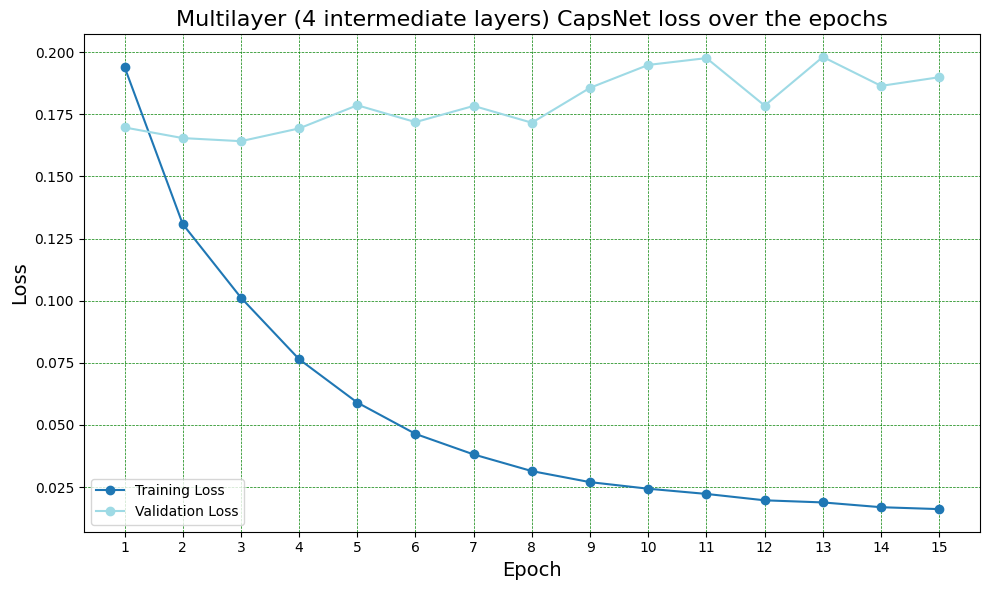

In [ ]:
utils.plot_line_chart(epoch_loss, ['Training Loss', 'Validation Loss'], 'Epoch', 'Loss',
                      'Multilayer (4 intermediate layers) CapsNet loss over the epochs')

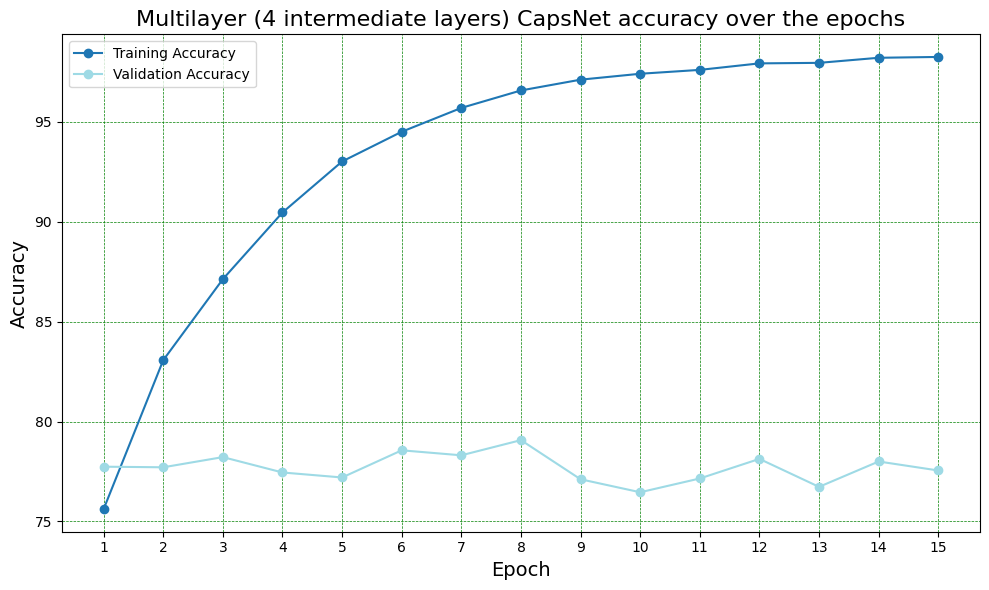

In [ ]:
utils.plot_line_chart(epoch_accuracy, ['Training Accuracy', 'Validation Accuracy'], 'Epoch', 'Accuracy',
                      'Multilayer (4 intermediate layers) CapsNet accuracy over the epochs')

### 25% Pruned Base CapsNet with Intermediate Layers

In [ ]:
pruned_model_type = 25

best_pruned_base_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_{}pc_base_capsnet_cifar10_model.pt'.format(pruned_model_type))

pruned_multilayer_inter4_capsnet_cifar10_model = ccmp.create_pruned_model_from_state_dict(
    new_model = multilayer_inter4_capsnet_cifar10_model,
    saved_state_dict = best_pruned_base_capsnet_cifar10_model['model_state_dict'],
    model_conv_config_dict = model_conv_config, n_class = n_class, n_caps_layers = n_caps_layers,
    prim_caps_dim = prim_caps_dim, base_capsnet_stdict = True)

pruned_multilayer_inter4_capsnet_cifar10_model.name = 'pruned_{}pc_multilayer_inter{}_capsnet_cifar10_model'.format(pruned_model_type, n_caps_layers)
pruned_multilayer_inter4_capsnet_cifar10_model = pruned_multilayer_inter4_capsnet_cifar10_model.to(device)
pruned_multilayer_inter4_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(64, 120, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(120, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(120, 120, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
    (intermediate_co

In [ ]:
%%time
best_trained_model_path, _, _ = mtt.train_capsnet(n_epochs,
                                                  pruned_multilayer_inter4_capsnet_cifar10_model,
                                                  criterion,
                                                  train_loader,
                                                  test_loader,
                                                  CIFAR10_TRAIN_DIR,
                                                  logger,
                                                  device=device)

02/29 06:50:21 PM | pruned_25pc_multilayer_inter4_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.5818, Top 1 Acc=12.50, Top 5 Acc=46.88
INFO:capsnet:pruned_25pc_multilayer_inter4_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.5818, Top 1 Acc=12.50, Top 5 Acc=46.88
02/29 06:50:29 PM | pruned_25pc_multilayer_inter4_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.4406, Top 1 Acc=36.65, Top 5 Acc=82.67
INFO:capsnet:pruned_25pc_multilayer_inter4_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.4406, Top 1 Acc=36.65, Top 5 Acc=82.67
02/29 06:50:36 PM | pruned_25pc_multilayer_inter4_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.3863, Top 1 Acc=46.54, Top 5 Acc=88.27
INFO:capsnet:pruned_25pc_multilayer_inter4_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.3863, Top 1 Acc=46.54, Top 5 Acc=88.27
02/29 06:50:44 PM | pruned_25pc_multilayer_inter4_capsnet_cifar10_mod

CPU times: user 1h 26min 34s, sys: 5min 45s, total: 1h 32min 20s
Wall time: 1h 33min 33s


#### Export ConvCaps Activation

In [ ]:
pruned_trained_multilayer_inter4_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_25pc_multilayer_inter4_capsnet_cifar10_model.pt')

pruned_multilayer_inter4_capsnet_cifar10_model.load_state_dict(pruned_trained_multilayer_inter4_capsnet_cifar10_model['model_state_dict'])

pruned_multilayer_inter4_capsnet_cifar10_model.name = 'best_pruned_25pc_multilayer_inter4_capsnet_cifar10_model'
pruned_multilayer_inter4_capsnet_cifar10_model = pruned_multilayer_inter4_capsnet_cifar10_model.to(device)
pruned_multilayer_inter4_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(64, 120, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(120, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(120, 120, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
    (intermediate_co

In [ ]:
capsnet_inter4_convcaps_activations = utils.extract_convcaps_activations(pruned_multilayer_inter4_capsnet_cifar10_model,
                                                                         test_loader, logger, CIFAR10_TRAIN_DIR, device)

02/29 08:23:55 PM | best_pruned_25pc_multilayer_inter4_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=90.625, Top 5 Acc=100.000
INFO:capsnet:best_pruned_25pc_multilayer_inter4_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=90.625, Top 5 Acc=100.000
02/29 08:23:55 PM | best_pruned_25pc_multilayer_inter4_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=79.688, Top 5 Acc=100.000
INFO:capsnet:best_pruned_25pc_multilayer_inter4_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=79.688, Top 5 Acc=100.000
02/29 08:23:55 PM | best_pruned_25pc_multilayer_inter4_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=78.125, Top 5 Acc=100.000
INFO:capsnet:best_pruned_25pc_multilayer_inter4_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=78.125, Top 5 Acc=100.000
02/29 08:23:55 PM | best_pruned_25pc_multilayer_inter4_capsnet_cifar10_model - Iterations=4/313, Batch Size=32, Top 1 Acc=79.688, Top

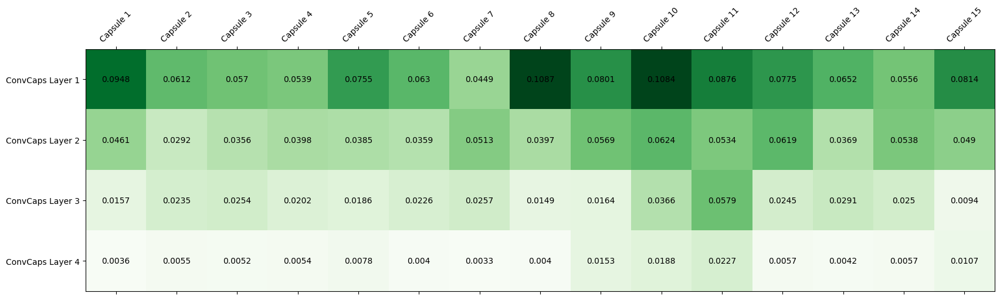

In [ ]:
utils.plot_caps_layers_activations(capsnet_inter4_convcaps_activations,
                                   n_caps=capsnet_inter4_convcaps_activations['intermediate_convcaps_layer_1'].shape[0],
                                   n_caps_layers=n_caps_layers, text_en=1)

#### Plots for losses and accuracies

In [ ]:
multilayer_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Trained_pruned_25pc_multilayer_inter4_capsnet_cifar10_model_Epoch15_of_15.pt')

epoch_loss = multilayer_capsnet_cifar10_model['epoch_loss']
epoch_accuracy = multilayer_capsnet_cifar10_model['epoch_accuracy']

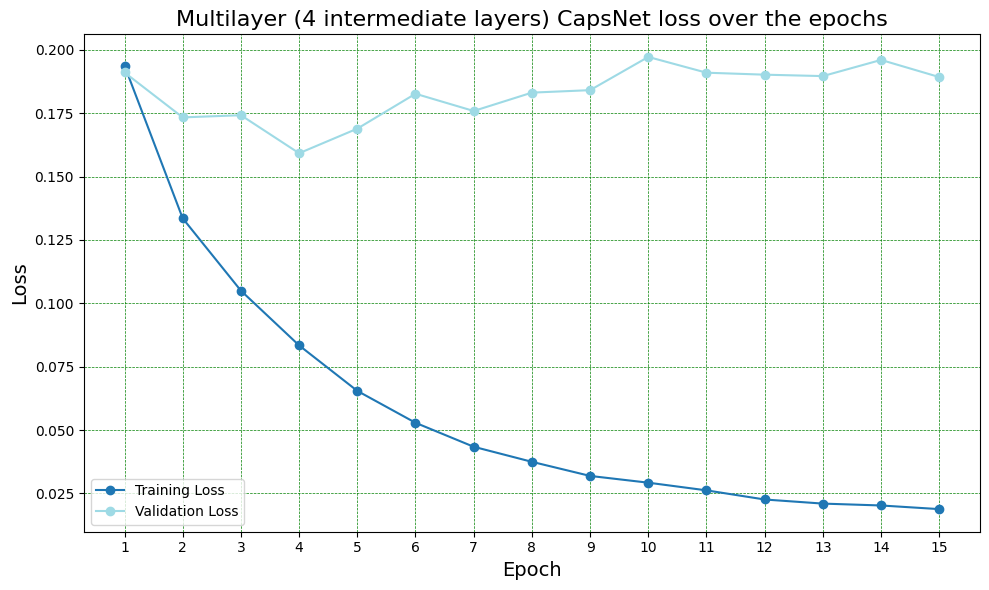

In [ ]:
utils.plot_line_chart(epoch_loss, ['Training Loss', 'Validation Loss'], 'Epoch', 'Loss',
                      'Multilayer (4 intermediate layers) CapsNet loss over the epochs')

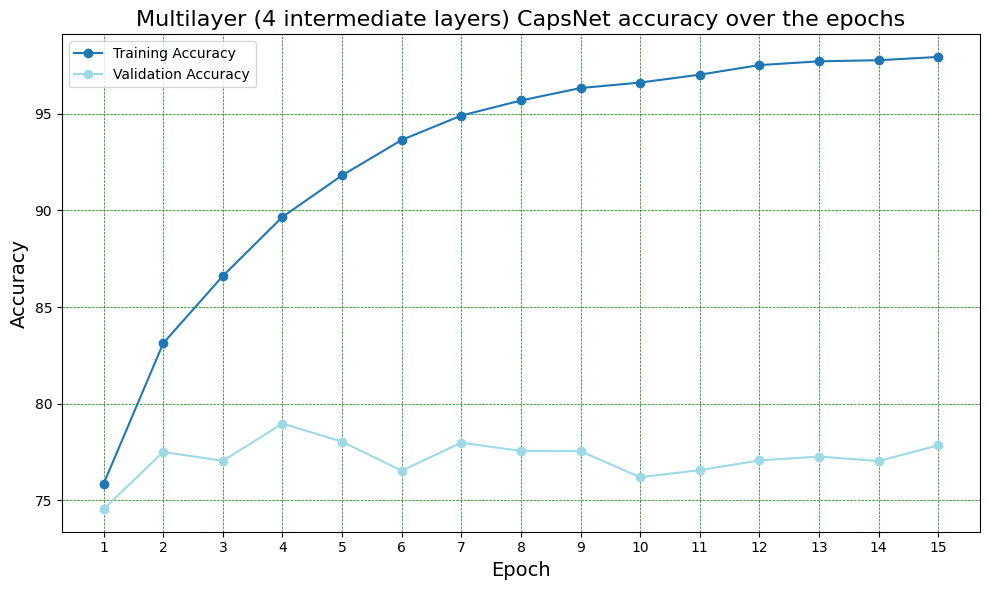

In [ ]:
utils.plot_line_chart(epoch_accuracy, ['Training Accuracy', 'Validation Accuracy'], 'Epoch', 'Accuracy',
                      'Multilayer (4 intermediate layers) CapsNet accuracy over the epochs')

In [ ]:
time.sleep(5)

from google.colab import runtime
runtime.unassign()

## 5 Intermediate Layered CapsNet

In [ ]:
CIFAR10_TRAIN_DIR = TRAIN_DIR+"cifar10/20Caps8Dim/"
batch_size=32
n_epochs=15
n_class=10

n_caps_layers=5
prim_caps_channels=20
prim_caps_dim=8

model_conv_config = {'in_img_h':32,
                     'in_img_w':32,
                     'in_img_c':3,
                     'kernel_size':[3, 3, 3, 3],
                     'stride':[1, 2, 1, 2],
                     'padding':[1, 1, 1, 0]}

train_loader, test_loader = image_dataloader(dataset='cifar10', batch_size=batch_size)

criterion = caps.CapsNetLoss(n_class=n_class)

Files already downloaded and verified
Files already downloaded and verified


In [ ]:
multilayer_inter5_capsnet_cifar10_model = caps.CapsuleNetwork(in_img_c=3, in_img_h=32, in_img_w=32, n_class=n_class,
                                                               model_conv_config=model_conv_config, prim_caps_channels=prim_caps_channels,
                                                               prim_caps_dim=prim_caps_dim, n_caps_layers=n_caps_layers)

multilayer_inter5_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 40, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(40, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(40, 80, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(80, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(80, 160, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(160, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(160, 160, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
    (intermediate_co

### 25% Pruned Base CapsNet with Intermediate Layers

In [ ]:
pruned_model_type = 25

best_pruned_base_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_{}pc_base_capsnet_cifar10_model.pt'.format(pruned_model_type))

pruned_multilayer_inter5_capsnet_cifar10_model = ccmp.create_pruned_model_from_state_dict(
    new_model = multilayer_inter5_capsnet_cifar10_model,
    saved_state_dict = best_pruned_base_capsnet_cifar10_model['model_state_dict'],
    model_conv_config_dict = model_conv_config, n_class = n_class, n_caps_layers = n_caps_layers,
    prim_caps_dim = prim_caps_dim, base_capsnet_stdict = True)

pruned_multilayer_inter5_capsnet_cifar10_model.name = 'pruned_{}pc_multilayer_inter{}_capsnet_cifar10_model'.format(pruned_model_type, n_caps_layers)
pruned_multilayer_inter5_capsnet_cifar10_model = pruned_multilayer_inter5_capsnet_cifar10_model.to(device)
pruned_multilayer_inter5_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(64, 120, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(120, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(120, 120, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
    (intermediate_co

In [ ]:
%%time
best_trained_model_path, _, _ = mtt.train_capsnet(n_epochs,
                                                  pruned_multilayer_inter5_capsnet_cifar10_model,
                                                  criterion,
                                                  train_loader,
                                                  test_loader,
                                                  CIFAR10_TRAIN_DIR,
                                                  logger,
                                                  device=device)

02/29 09:35:34 PM | pruned_25pc_multilayer_inter5_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.5992, Top 1 Acc=12.50, Top 5 Acc=40.62
INFO:capsnet:pruned_25pc_multilayer_inter5_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.5992, Top 1 Acc=12.50, Top 5 Acc=40.62
02/29 09:35:44 PM | pruned_25pc_multilayer_inter5_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.4364, Top 1 Acc=37.22, Top 5 Acc=82.67
INFO:capsnet:pruned_25pc_multilayer_inter5_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.4364, Top 1 Acc=37.22, Top 5 Acc=82.67
02/29 09:35:54 PM | pruned_25pc_multilayer_inter5_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.3775, Top 1 Acc=47.84, Top 5 Acc=88.70
INFO:capsnet:pruned_25pc_multilayer_inter5_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.3775, Top 1 Acc=47.84, Top 5 Acc=88.70
02/29 09:36:04 PM | pruned_25pc_multilayer_inter5_capsnet_cifar10_mod

CPU times: user 1h 41min 22s, sys: 6min 51s, total: 1h 48min 14s
Wall time: 1h 49min 42s


#### Export ConvCaps Activation

In [ ]:
pruned_trained_multilayer_inter5_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_25pc_multilayer_inter5_capsnet_cifar10_model.pt')

pruned_multilayer_inter5_capsnet_cifar10_model.load_state_dict(pruned_trained_multilayer_inter5_capsnet_cifar10_model['model_state_dict'])

pruned_multilayer_inter5_capsnet_cifar10_model.name = 'best_pruned_25pc_multilayer_inter5_capsnet_cifar10_model'
pruned_multilayer_inter5_capsnet_cifar10_model = pruned_multilayer_inter5_capsnet_cifar10_model.to(device)
pruned_multilayer_inter5_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(64, 120, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(120, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(120, 120, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
    (intermediate_co

In [ ]:
capsnet_inter5_convcaps_activations = utils.extract_convcaps_activations(pruned_multilayer_inter5_capsnet_cifar10_model,
                                                                         test_loader, logger, CIFAR10_TRAIN_DIR, device)

02/29 11:25:16 PM | best_pruned_25pc_multilayer_inter5_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=87.500, Top 5 Acc=96.875
INFO:capsnet:best_pruned_25pc_multilayer_inter5_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=87.500, Top 5 Acc=96.875
02/29 11:25:16 PM | best_pruned_25pc_multilayer_inter5_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=76.562, Top 5 Acc=92.188
INFO:capsnet:best_pruned_25pc_multilayer_inter5_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=76.562, Top 5 Acc=92.188
02/29 11:25:16 PM | best_pruned_25pc_multilayer_inter5_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=81.250, Top 5 Acc=94.792
INFO:capsnet:best_pruned_25pc_multilayer_inter5_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=81.250, Top 5 Acc=94.792
02/29 11:25:16 PM | best_pruned_25pc_multilayer_inter5_capsnet_cifar10_model - Iterations=4/313, Batch Size=32, Top 1 Acc=83.594, Top 5 Acc

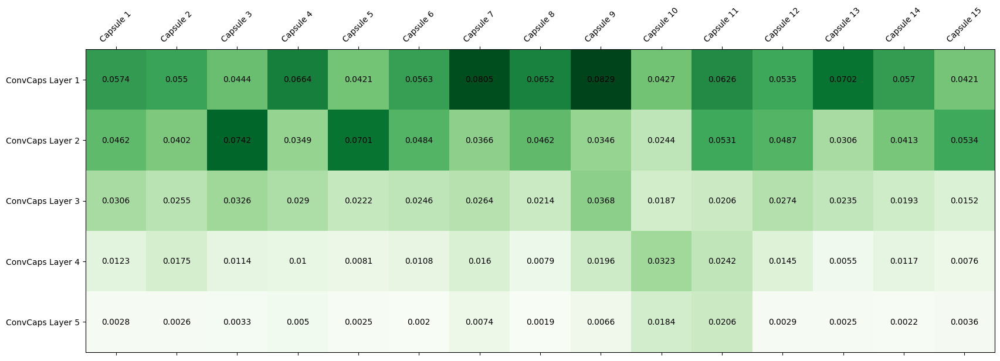

In [ ]:
utils.plot_caps_layers_activations(capsnet_inter5_convcaps_activations,
                                   n_caps=capsnet_inter5_convcaps_activations['intermediate_convcaps_layer_1'].shape[0],
                                   n_caps_layers=n_caps_layers, text_en=1)

#### Plots for losses and accuracies

In [ ]:
multilayer_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Trained_pruned_25pc_multilayer_inter5_capsnet_cifar10_model_Epoch15_of_15.pt')

epoch_loss = multilayer_capsnet_cifar10_model['epoch_loss']
epoch_accuracy = multilayer_capsnet_cifar10_model['epoch_accuracy']

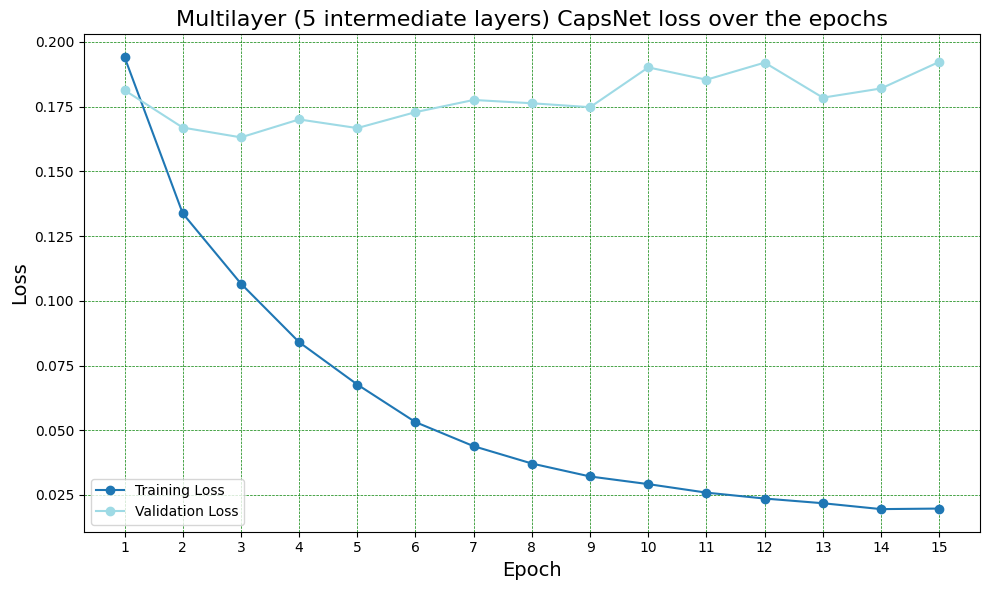

In [ ]:
utils.plot_line_chart(epoch_loss, ['Training Loss', 'Validation Loss'], 'Epoch', 'Loss',
                      'Multilayer (5 intermediate layers) CapsNet loss over the epochs')

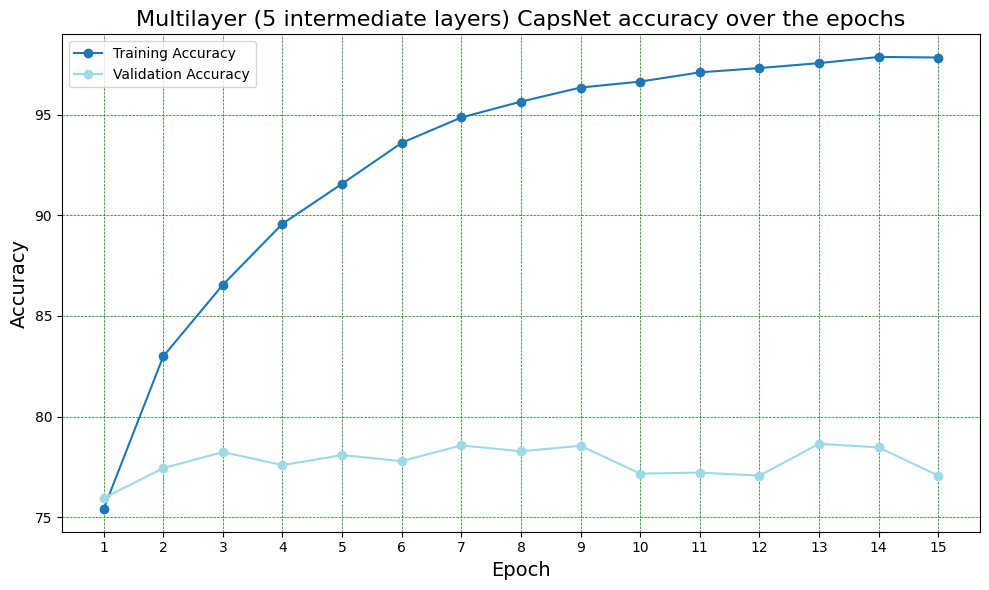

In [ ]:
utils.plot_line_chart(epoch_accuracy, ['Training Accuracy', 'Validation Accuracy'], 'Epoch', 'Accuracy',
                      'Multilayer (5 intermediate layers) CapsNet accuracy over the epochs')

### 37.5% Pruned Base CapsNet with Intermediate Layers

In [ ]:
pruned_model_type = 37

best_pruned_base_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_{}pc_base_capsnet_cifar10_model.pt'.format(pruned_model_type))

pruned_multilayer_inter5_capsnet_cifar10_model = ccmp.create_pruned_model_from_state_dict(
    new_model = multilayer_inter5_capsnet_cifar10_model,
    saved_state_dict = best_pruned_base_capsnet_cifar10_model['model_state_dict'],
    model_conv_config_dict = model_conv_config, n_class = n_class, n_caps_layers = n_caps_layers,
    prim_caps_dim = prim_caps_dim, base_capsnet_stdict = True)

pruned_multilayer_inter5_capsnet_cifar10_model.name = 'pruned_{}pc_multilayer_inter{}_capsnet_cifar10_model'.format(pruned_model_type, n_caps_layers)
pruned_multilayer_inter5_capsnet_cifar10_model = pruned_multilayer_inter5_capsnet_cifar10_model.to(device)
pruned_multilayer_inter5_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 56, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(56, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(56, 104, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(104, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(104, 104, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
    (intermediate_co

In [ ]:
%%time
best_trained_model_path, _, _ = mtt.train_capsnet(n_epochs,
                                                  pruned_multilayer_inter5_capsnet_cifar10_model,
                                                  criterion,
                                                  train_loader,
                                                  test_loader,
                                                  CIFAR10_TRAIN_DIR,
                                                  logger,
                                                  device=device)

02/29 11:25:34 PM | pruned_37pc_multilayer_inter5_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.6413, Top 1 Acc=6.25, Top 5 Acc=65.62
INFO:capsnet:pruned_37pc_multilayer_inter5_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.6413, Top 1 Acc=6.25, Top 5 Acc=65.62
02/29 11:25:43 PM | pruned_37pc_multilayer_inter5_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.4405, Top 1 Acc=36.36, Top 5 Acc=83.33
INFO:capsnet:pruned_37pc_multilayer_inter5_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.4405, Top 1 Acc=36.36, Top 5 Acc=83.33
02/29 11:25:51 PM | pruned_37pc_multilayer_inter5_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.3788, Top 1 Acc=47.84, Top 5 Acc=88.17
INFO:capsnet:pruned_37pc_multilayer_inter5_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.3788, Top 1 Acc=47.84, Top 5 Acc=88.17
02/29 11:25:59 PM | pruned_37pc_multilayer_inter5_capsnet_cifar10_model

CPU times: user 1h 36min 4s, sys: 6min 48s, total: 1h 42min 53s
Wall time: 1h 43min 33s


#### Export ConvCaps Activation

In [ ]:
pruned_trained_multilayer_inter5_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_37pc_multilayer_inter5_capsnet_cifar10_model.pt')

pruned_multilayer_inter5_capsnet_cifar10_model.load_state_dict(pruned_trained_multilayer_inter5_capsnet_cifar10_model['model_state_dict'])

pruned_multilayer_inter5_capsnet_cifar10_model.name = 'best_pruned_37pc_multilayer_inter5_capsnet_cifar10_model'
pruned_multilayer_inter5_capsnet_cifar10_model = pruned_multilayer_inter5_capsnet_cifar10_model.to(device)
pruned_multilayer_inter5_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 56, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(56, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(56, 104, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(104, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(104, 104, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
    (intermediate_co

In [ ]:
capsnet_inter5_convcaps_activations = utils.extract_convcaps_activations(pruned_multilayer_inter5_capsnet_cifar10_model,
                                                                         test_loader, logger, CIFAR10_TRAIN_DIR, device)

03/01 01:13:49 AM | best_pruned_37pc_multilayer_inter5_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=87.500, Top 5 Acc=100.000
INFO:capsnet:best_pruned_37pc_multilayer_inter5_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=87.500, Top 5 Acc=100.000
03/01 01:13:49 AM | best_pruned_37pc_multilayer_inter5_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=76.562, Top 5 Acc=98.438
INFO:capsnet:best_pruned_37pc_multilayer_inter5_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=76.562, Top 5 Acc=98.438
03/01 01:13:49 AM | best_pruned_37pc_multilayer_inter5_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=76.042, Top 5 Acc=98.958
INFO:capsnet:best_pruned_37pc_multilayer_inter5_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=76.042, Top 5 Acc=98.958
03/01 01:13:49 AM | best_pruned_37pc_multilayer_inter5_capsnet_cifar10_model - Iterations=4/313, Batch Size=32, Top 1 Acc=80.469, Top 5 A

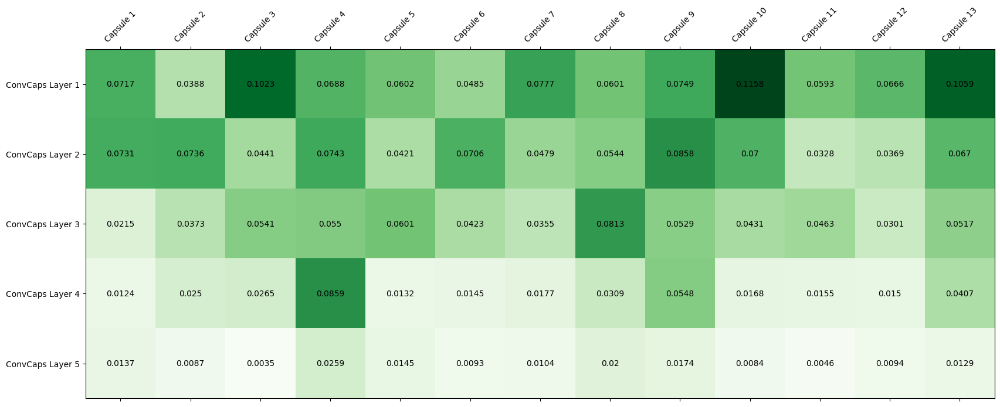

In [ ]:
utils.plot_caps_layers_activations(capsnet_inter5_convcaps_activations,
                                   n_caps=capsnet_inter5_convcaps_activations['intermediate_convcaps_layer_1'].shape[0],
                                   n_caps_layers=n_caps_layers, text_en=1)

#### Plots for losses and accuracies

In [ ]:
multilayer_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Trained_pruned_37pc_multilayer_inter5_capsnet_cifar10_model_Epoch15_of_15.pt')

epoch_loss = multilayer_capsnet_cifar10_model['epoch_loss']
epoch_accuracy = multilayer_capsnet_cifar10_model['epoch_accuracy']

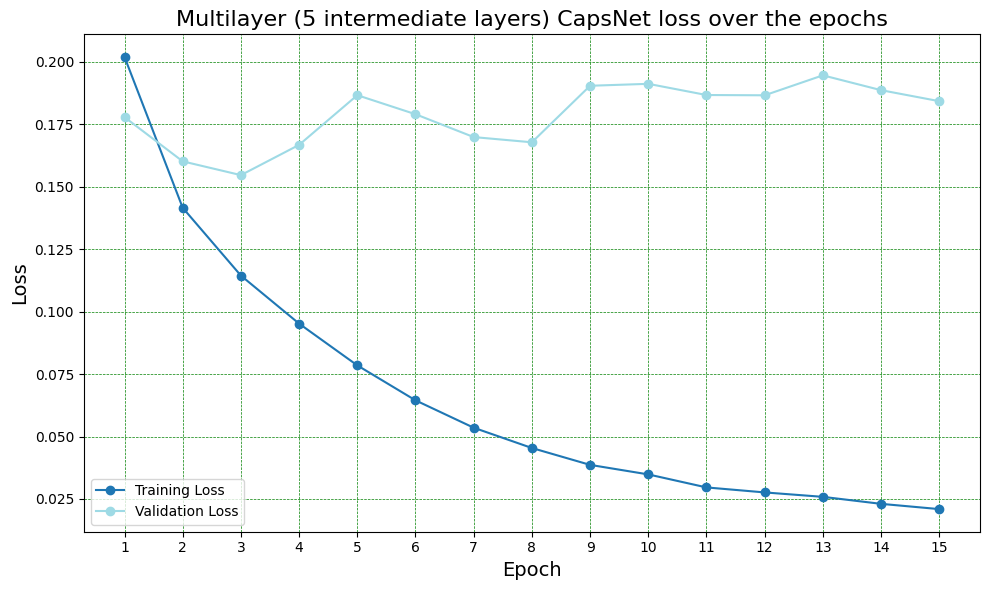

In [ ]:
utils.plot_line_chart(epoch_loss, ['Training Loss', 'Validation Loss'], 'Epoch', 'Loss',
                      'Multilayer (5 intermediate layers) CapsNet loss over the epochs')

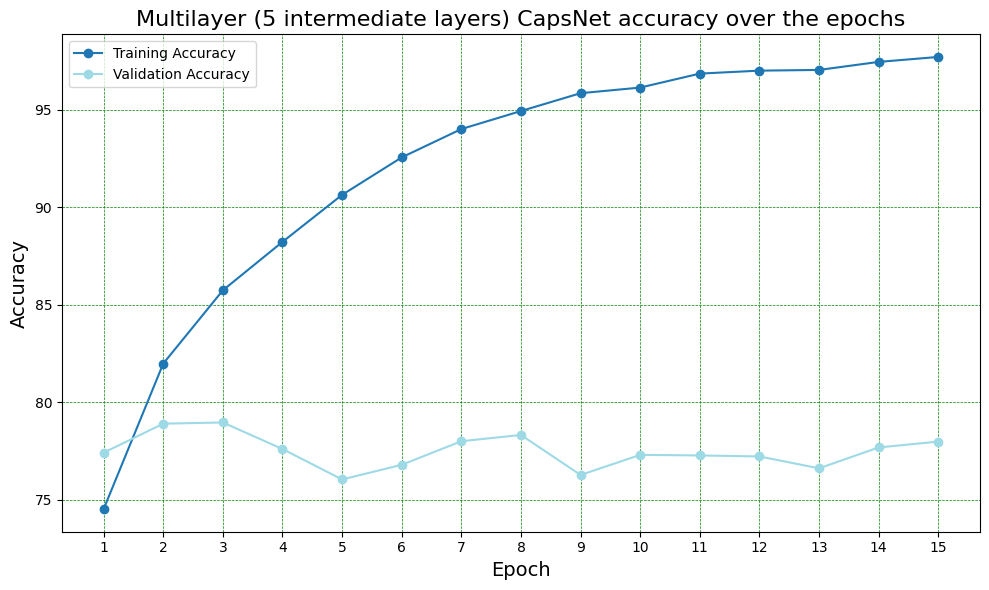

In [ ]:
utils.plot_line_chart(epoch_accuracy, ['Training Accuracy', 'Validation Accuracy'], 'Epoch', 'Accuracy',
                      'Multilayer (5 intermediate layers) CapsNet accuracy over the epochs')

## 6 Intermediate Layered CapsNet

In [ ]:
CIFAR10_TRAIN_DIR = TRAIN_DIR+"cifar10/20Caps8Dim/"
batch_size=32
n_epochs=15
n_class=10

n_caps_layers=6
prim_caps_channels=20
prim_caps_dim=8

model_conv_config = {'in_img_h':32,
                     'in_img_w':32,
                     'in_img_c':3,
                     'kernel_size':[3, 3, 3, 3],
                     'stride':[1, 2, 1, 2],
                     'padding':[1, 1, 1, 0]}

train_loader, test_loader = image_dataloader(dataset='cifar10', batch_size=batch_size)

criterion = caps.CapsNetLoss(n_class=n_class)

100%|██████████| 170498071/170498071 [00:05<00:00, 28552026.67it/s]


Extracting ./data/cifar-10-python.tar.gz to ./data
Files already downloaded and verified


In [ ]:
multilayer_inter6_capsnet_cifar10_model = caps.CapsuleNetwork(in_img_c=3, in_img_h=32, in_img_w=32, n_class=n_class,
                                                               model_conv_config=model_conv_config, prim_caps_channels=prim_caps_channels,
                                                               prim_caps_dim=prim_caps_dim, n_caps_layers=n_caps_layers)

multilayer_inter6_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 40, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(40, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(40, 80, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(80, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(80, 160, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(160, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(160, 160, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
    (intermediate_co

### 12.5% Pruned Base CapsNet with Intermediate Layers

In [ ]:
pruned_model_type = 12

best_pruned_base_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_{}pc_base_capsnet_cifar10_model.pt'.format(pruned_model_type))

pruned_multilayer_inter6_capsnet_cifar10_model = ccmp.create_pruned_model_from_state_dict(
    new_model = multilayer_inter6_capsnet_cifar10_model,
    saved_state_dict = best_pruned_base_capsnet_cifar10_model['model_state_dict'],
    model_conv_config_dict = model_conv_config, n_class = n_class, n_caps_layers = n_caps_layers,
    prim_caps_dim = prim_caps_dim, base_capsnet_stdict = True)

pruned_multilayer_inter6_capsnet_cifar10_model.name = 'pruned_{}pc_multilayer_inter{}_capsnet_cifar10_model'.format(pruned_model_type, n_caps_layers)
pruned_multilayer_inter6_capsnet_cifar10_model = pruned_multilayer_inter6_capsnet_cifar10_model.to(device)
pruned_multilayer_inter6_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 72, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(72, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(72, 144, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(144, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(144, 144, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
    (intermediate_co

In [ ]:
%%time
best_trained_model_path, _, _ = mtt.train_capsnet(n_epochs,
                                                  pruned_multilayer_inter6_capsnet_cifar10_model,
                                                  criterion,
                                                  train_loader,
                                                  test_loader,
                                                  CIFAR10_TRAIN_DIR,
                                                  logger,
                                                  device=device)

03/03 08:17:25 PM | pruned_12pc_multilayer_inter6_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.8074, Top 1 Acc=25.00, Top 5 Acc=59.38
INFO:capsnet:pruned_12pc_multilayer_inter6_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.8074, Top 1 Acc=25.00, Top 5 Acc=59.38
03/03 08:17:36 PM | pruned_12pc_multilayer_inter6_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.5100, Top 1 Acc=27.56, Top 5 Acc=75.00
INFO:capsnet:pruned_12pc_multilayer_inter6_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.5100, Top 1 Acc=27.56, Top 5 Acc=75.00
03/03 08:17:47 PM | pruned_12pc_multilayer_inter6_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.4435, Top 1 Acc=36.54, Top 5 Acc=83.22
INFO:capsnet:pruned_12pc_multilayer_inter6_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.4435, Top 1 Acc=36.54, Top 5 Acc=83.22
03/03 08:17:59 PM | pruned_12pc_multilayer_inter6_capsnet_cifar10_mod

In [20]:
checkpoint_file = CIFAR10_TRAIN_DIR+'Trained_pruned_12pc_multilayer_inter6_capsnet_cifar10_model_Epoch15_of_15.pt'

best_trained_model_path, _, _ = mtt.train_capsnet(n_epochs,
                                                  pruned_multilayer_inter6_capsnet_cifar10_model,
                                                  criterion,
                                                  train_loader,
                                                  test_loader,
                                                  CIFAR10_TRAIN_DIR,
                                                  logger,
                                                  device=device,
                                                  checkpoint_file=checkpoint_file)

03/03 10:44:26 PM | best_pruned_12pc_multilayer_inter6_capsnet_cifar10_model best accuracy=78.930 saved at: /content/drive/MyDrive/MSc_AI/Course/OCOM5300M-AI_Project/code_repository/results/train/cifar10/20Caps8Dim/Trained_pruned_12pc_multilayer_inter6_capsnet_cifar10_model_Epoch4_of_15.pt
INFO:capsnet:best_pruned_12pc_multilayer_inter6_capsnet_cifar10_model best accuracy=78.930 saved at: /content/drive/MyDrive/MSc_AI/Course/OCOM5300M-AI_Project/code_repository/results/train/cifar10/20Caps8Dim/Trained_pruned_12pc_multilayer_inter6_capsnet_cifar10_model_Epoch4_of_15.pt


#### Export ConvCaps Activation

In [ ]:
pruned_trained_multilayer_inter6_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_12pc_multilayer_inter6_capsnet_cifar10_model.pt')

pruned_multilayer_inter6_capsnet_cifar10_model.load_state_dict(pruned_trained_multilayer_inter6_capsnet_cifar10_model['model_state_dict'])

pruned_multilayer_inter6_capsnet_cifar10_model.name = 'best_pruned_12pc_multilayer_inter6_capsnet_cifar10_model'
pruned_multilayer_inter6_capsnet_cifar10_model = pruned_multilayer_inter6_capsnet_cifar10_model.to(device)
pruned_multilayer_inter6_capsnet_cifar10_model.eval()

In [ ]:
capsnet_inter6_convcaps_activations = utils.extract_convcaps_activations(pruned_multilayer_inter6_capsnet_cifar10_model,
                                                                         test_loader, logger, CIFAR10_TRAIN_DIR, device)

03/01 03:04:10 AM | best_pruned_25pc_multilayer_inter6_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=90.625, Top 5 Acc=100.000
INFO:capsnet:best_pruned_25pc_multilayer_inter6_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=90.625, Top 5 Acc=100.000
03/01 03:04:10 AM | best_pruned_25pc_multilayer_inter6_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=81.250, Top 5 Acc=96.875
INFO:capsnet:best_pruned_25pc_multilayer_inter6_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=81.250, Top 5 Acc=96.875
03/01 03:04:10 AM | best_pruned_25pc_multilayer_inter6_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=82.292, Top 5 Acc=96.875
INFO:capsnet:best_pruned_25pc_multilayer_inter6_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=82.292, Top 5 Acc=96.875
03/01 03:04:10 AM | best_pruned_25pc_multilayer_inter6_capsnet_cifar10_model - Iterations=4/313, Batch Size=32, Top 1 Acc=84.375, Top 5 A

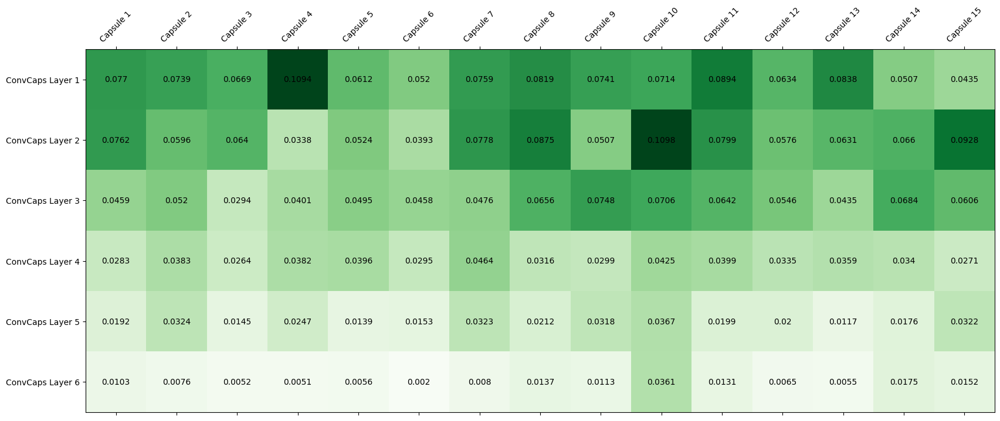

In [ ]:
utils.plot_caps_layers_activations(capsnet_inter6_convcaps_activations,
                                   n_caps=capsnet_inter6_convcaps_activations['intermediate_convcaps_layer_1'].shape[0],
                                   n_caps_layers=n_caps_layers, text_en=1)

In [22]:
n_epochs = 15

for epoch in range(1, n_epochs+1):
    trained_inter6_capsnet_model = torch.load(CIFAR10_TRAIN_DIR+'Trained_pruned_12pc_multilayer_inter6_capsnet_cifar10_model_Epoch{}_of_15.pt'.format(epoch))

    pruned_multilayer_inter6_capsnet_cifar10_model.load_state_dict(trained_inter6_capsnet_model['model_state_dict'])

    pruned_multilayer_inter6_capsnet_cifar10_model.name = 'trained_pruned_12pc_multilayer_inter6_capsnet_cifar10_model_epoch{}'.format(epoch)
    pruned_multilayer_inter6_capsnet_cifar10_model = pruned_multilayer_inter6_capsnet_cifar10_model.to(device)

    utils.extract_convcaps_activations(pruned_multilayer_inter6_capsnet_cifar10_model, test_loader, logger, CIFAR10_TRAIN_DIR, device)

Streaming output truncated to the last 5000 lines.
03/03 10:56:18 PM | trained_pruned_12pc_multilayer_inter6_capsnet_cifar10_model_epoch8 - Iterations=13/313, Batch Size=32, Top 1 Acc=77.885, Top 5 Acc=96.394
INFO:capsnet:trained_pruned_12pc_multilayer_inter6_capsnet_cifar10_model_epoch8 - Iterations=13/313, Batch Size=32, Top 1 Acc=77.885, Top 5 Acc=96.394
03/03 10:56:18 PM | trained_pruned_12pc_multilayer_inter6_capsnet_cifar10_model_epoch8 - Iterations=14/313, Batch Size=32, Top 1 Acc=77.679, Top 5 Acc=96.429
INFO:capsnet:trained_pruned_12pc_multilayer_inter6_capsnet_cifar10_model_epoch8 - Iterations=14/313, Batch Size=32, Top 1 Acc=77.679, Top 5 Acc=96.429
03/03 10:56:18 PM | trained_pruned_12pc_multilayer_inter6_capsnet_cifar10_model_epoch8 - Iterations=15/313, Batch Size=32, Top 1 Acc=77.083, Top 5 Acc=96.667
INFO:capsnet:trained_pruned_12pc_multilayer_inter6_capsnet_cifar10_model_epoch8 - Iterations=15/313, Batch Size=32, Top 1 Acc=77.083, Top 5 Acc=96.667
03/03 10:56:18 PM | tr

#### Plots for losses and accuracies

In [ ]:
multilayer_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Trained_pruned_25pc_multilayer_inter6_capsnet_cifar10_model_Epoch15_of_15.pt')

epoch_loss = multilayer_capsnet_cifar10_model['epoch_loss']
epoch_accuracy = multilayer_capsnet_cifar10_model['epoch_accuracy']

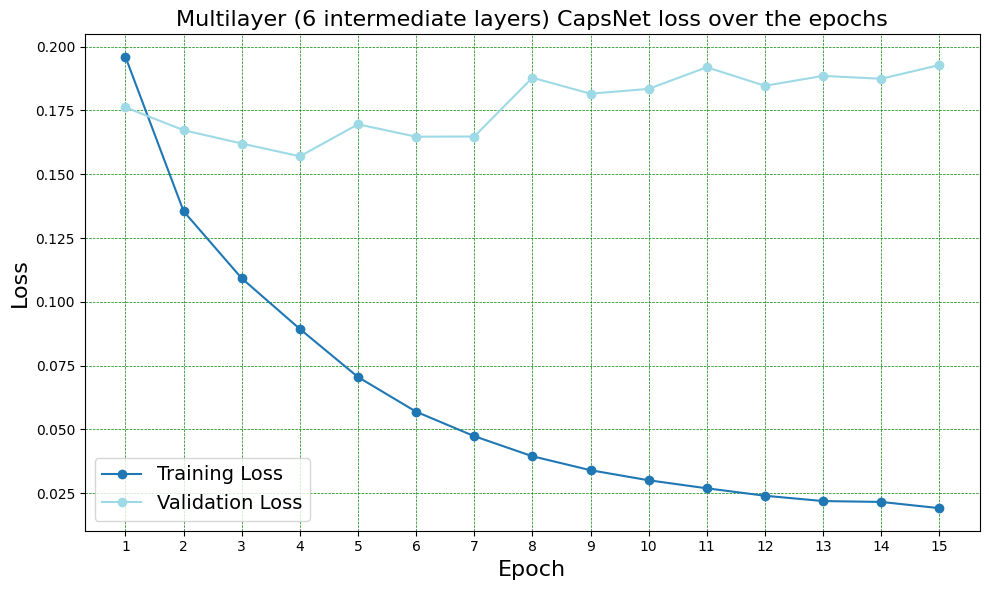

In [ ]:
utils.plot_line_chart(epoch_loss, ['Training Loss', 'Validation Loss'], 'Epoch', 'Loss',
                      'Multilayer (6 intermediate layers) CapsNet loss over the epochs')

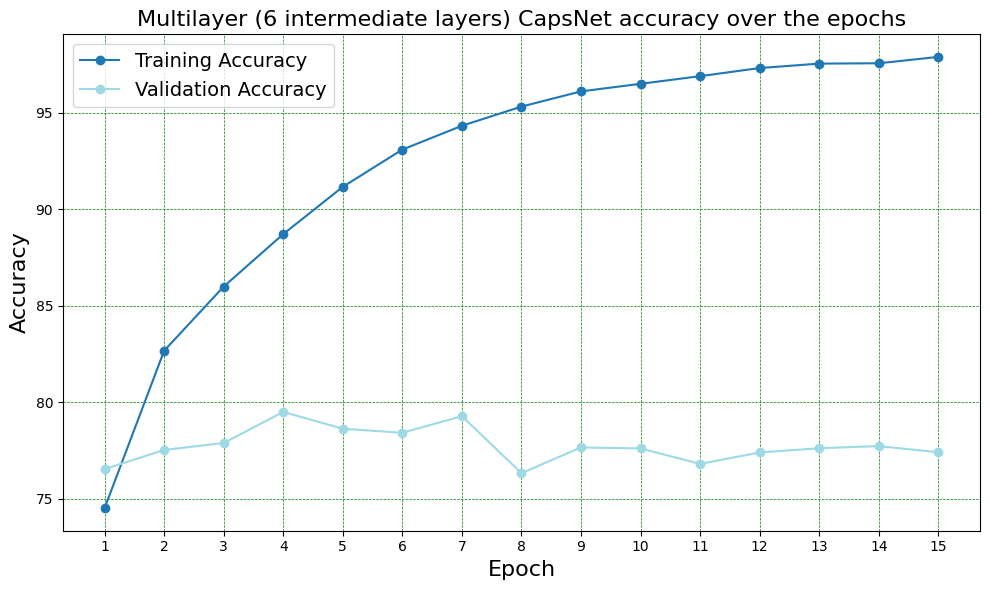

In [ ]:
utils.plot_line_chart(epoch_accuracy, ['Training Accuracy', 'Validation Accuracy'], 'Epoch', 'Accuracy',
                      'Multilayer (6 intermediate layers) CapsNet accuracy over the epochs')

### 25% Pruned Base CapsNet with Intermediate Layers

In [23]:
pruned_model_type = 25

best_pruned_base_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_{}pc_base_capsnet_cifar10_model.pt'.format(pruned_model_type))

pruned_multilayer_inter6_capsnet_cifar10_model = ccmp.create_pruned_model_from_state_dict(
    new_model = multilayer_inter6_capsnet_cifar10_model,
    saved_state_dict = best_pruned_base_capsnet_cifar10_model['model_state_dict'],
    model_conv_config_dict = model_conv_config, n_class = n_class, n_caps_layers = n_caps_layers,
    prim_caps_dim = prim_caps_dim, base_capsnet_stdict = True)

pruned_multilayer_inter6_capsnet_cifar10_model.name = 'pruned_{}pc_multilayer_inter{}_capsnet_cifar10_model'.format(pruned_model_type, n_caps_layers)
pruned_multilayer_inter6_capsnet_cifar10_model = pruned_multilayer_inter6_capsnet_cifar10_model.to(device)
pruned_multilayer_inter6_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(64, 120, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(120, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(120, 120, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
    (intermediate_co

In [ ]:
%%time
best_trained_model_path, _, _ = mtt.train_capsnet(n_epochs,
                                                  pruned_multilayer_inter6_capsnet_cifar10_model,
                                                  criterion,
                                                  train_loader,
                                                  test_loader,
                                                  CIFAR10_TRAIN_DIR,
                                                  logger,
                                                  device=device)

03/01 01:18:51 AM | pruned_25pc_multilayer_inter6_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.6909, Top 1 Acc=21.88, Top 5 Acc=62.50
INFO:capsnet:pruned_25pc_multilayer_inter6_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.6909, Top 1 Acc=21.88, Top 5 Acc=62.50
03/01 01:19:00 AM | pruned_25pc_multilayer_inter6_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.4542, Top 1 Acc=34.19, Top 5 Acc=81.53
INFO:capsnet:pruned_25pc_multilayer_inter6_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.4542, Top 1 Acc=34.19, Top 5 Acc=81.53
03/01 01:19:08 AM | pruned_25pc_multilayer_inter6_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.3850, Top 1 Acc=46.20, Top 5 Acc=87.93
INFO:capsnet:pruned_25pc_multilayer_inter6_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.3850, Top 1 Acc=46.20, Top 5 Acc=87.93
03/01 01:19:16 AM | pruned_25pc_multilayer_inter6_capsnet_cifar10_mod

CPU times: user 1h 38min 24s, sys: 7min 11s, total: 1h 45min 36s
Wall time: 1h 45min 21s


#### Export ConvCaps Activation

In [ ]:
pruned_trained_multilayer_inter6_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_25pc_multilayer_inter6_capsnet_cifar10_model.pt')

pruned_multilayer_inter6_capsnet_cifar10_model.load_state_dict(pruned_trained_multilayer_inter6_capsnet_cifar10_model['model_state_dict'])

pruned_multilayer_inter6_capsnet_cifar10_model.name = 'best_pruned_25pc_multilayer_inter6_capsnet_cifar10_model'
pruned_multilayer_inter6_capsnet_cifar10_model = pruned_multilayer_inter6_capsnet_cifar10_model.to(device)
pruned_multilayer_inter6_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(64, 120, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(120, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(120, 120, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
    (intermediate_co

In [ ]:
capsnet_inter6_convcaps_activations = utils.extract_convcaps_activations(pruned_multilayer_inter6_capsnet_cifar10_model,
                                                                         test_loader, logger, CIFAR10_TRAIN_DIR, device)

03/01 03:04:10 AM | best_pruned_25pc_multilayer_inter6_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=90.625, Top 5 Acc=100.000
INFO:capsnet:best_pruned_25pc_multilayer_inter6_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=90.625, Top 5 Acc=100.000
03/01 03:04:10 AM | best_pruned_25pc_multilayer_inter6_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=81.250, Top 5 Acc=96.875
INFO:capsnet:best_pruned_25pc_multilayer_inter6_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=81.250, Top 5 Acc=96.875
03/01 03:04:10 AM | best_pruned_25pc_multilayer_inter6_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=82.292, Top 5 Acc=96.875
INFO:capsnet:best_pruned_25pc_multilayer_inter6_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=82.292, Top 5 Acc=96.875
03/01 03:04:10 AM | best_pruned_25pc_multilayer_inter6_capsnet_cifar10_model - Iterations=4/313, Batch Size=32, Top 1 Acc=84.375, Top 5 A

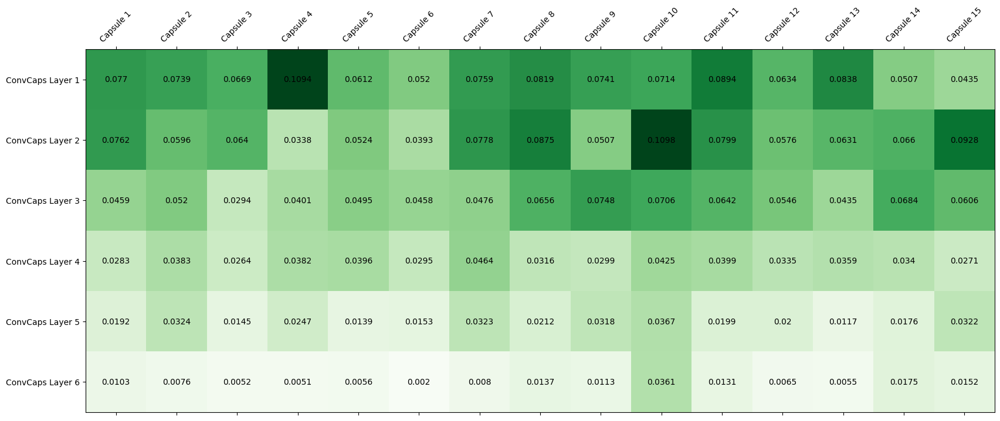

In [ ]:
utils.plot_caps_layers_activations(capsnet_inter6_convcaps_activations,
                                   n_caps=capsnet_inter6_convcaps_activations['intermediate_convcaps_layer_1'].shape[0],
                                   n_caps_layers=n_caps_layers, text_en=1)

In [24]:
n_epochs = 15

for epoch in range(1, n_epochs+1):
    trained_inter6_capsnet_model = torch.load(CIFAR10_TRAIN_DIR+'Trained_pruned_25pc_multilayer_inter6_capsnet_cifar10_model_Epoch{}_of_15.pt'.format(epoch))

    pruned_multilayer_inter6_capsnet_cifar10_model.load_state_dict(trained_inter6_capsnet_model['model_state_dict'])

    pruned_multilayer_inter6_capsnet_cifar10_model.name = 'trained_pruned_25pc_multilayer_inter6_capsnet_cifar10_model_epoch{}'.format(epoch)
    pruned_multilayer_inter6_capsnet_cifar10_model = pruned_multilayer_inter6_capsnet_cifar10_model.to(device)

    utils.extract_convcaps_activations(pruned_multilayer_inter6_capsnet_cifar10_model, test_loader, logger, CIFAR10_TRAIN_DIR, device)

Streaming output truncated to the last 5000 lines.
03/03 11:03:40 PM | trained_pruned_25pc_multilayer_inter6_capsnet_cifar10_model_epoch8 - Iterations=13/313, Batch Size=32, Top 1 Acc=77.885, Top 5 Acc=95.913
INFO:capsnet:trained_pruned_25pc_multilayer_inter6_capsnet_cifar10_model_epoch8 - Iterations=13/313, Batch Size=32, Top 1 Acc=77.885, Top 5 Acc=95.913
03/03 11:03:40 PM | trained_pruned_25pc_multilayer_inter6_capsnet_cifar10_model_epoch8 - Iterations=14/313, Batch Size=32, Top 1 Acc=77.232, Top 5 Acc=95.982
INFO:capsnet:trained_pruned_25pc_multilayer_inter6_capsnet_cifar10_model_epoch8 - Iterations=14/313, Batch Size=32, Top 1 Acc=77.232, Top 5 Acc=95.982
03/03 11:03:40 PM | trained_pruned_25pc_multilayer_inter6_capsnet_cifar10_model_epoch8 - Iterations=15/313, Batch Size=32, Top 1 Acc=76.667, Top 5 Acc=96.042
INFO:capsnet:trained_pruned_25pc_multilayer_inter6_capsnet_cifar10_model_epoch8 - Iterations=15/313, Batch Size=32, Top 1 Acc=76.667, Top 5 Acc=96.042
03/03 11:03:40 PM | tr

#### Plots for losses and accuracies

In [ ]:
multilayer_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Trained_pruned_25pc_multilayer_inter6_capsnet_cifar10_model_Epoch15_of_15.pt')

epoch_loss = multilayer_capsnet_cifar10_model['epoch_loss']
epoch_accuracy = multilayer_capsnet_cifar10_model['epoch_accuracy']

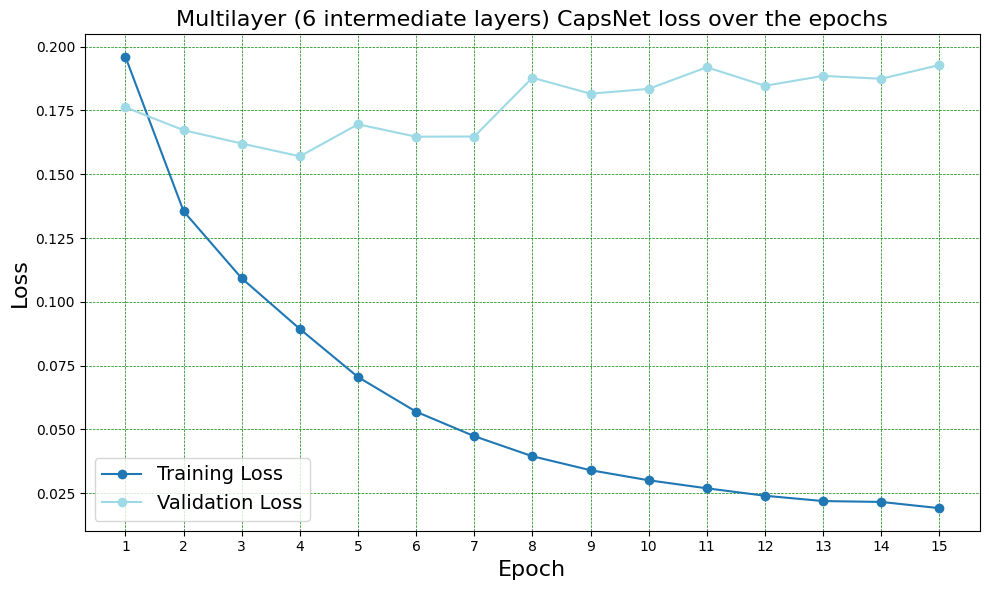

In [ ]:
utils.plot_line_chart(epoch_loss, ['Training Loss', 'Validation Loss'], 'Epoch', 'Loss',
                      'Multilayer (6 intermediate layers) CapsNet loss over the epochs')

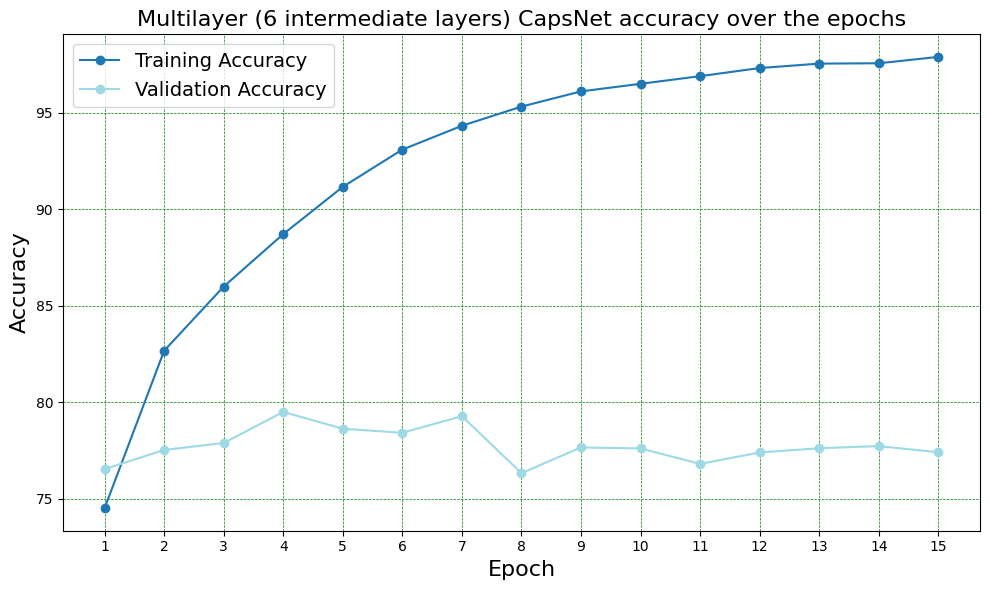

In [ ]:
utils.plot_line_chart(epoch_accuracy, ['Training Accuracy', 'Validation Accuracy'], 'Epoch', 'Accuracy',
                      'Multilayer (6 intermediate layers) CapsNet accuracy over the epochs')

### 37.5% Pruned Base CapsNet with Intermediate Layers

In [25]:
pruned_model_type = 37

best_pruned_base_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_{}pc_base_capsnet_cifar10_model.pt'.format(pruned_model_type))

pruned_multilayer_inter6_capsnet_cifar10_model = ccmp.create_pruned_model_from_state_dict(
    new_model = multilayer_inter6_capsnet_cifar10_model,
    saved_state_dict = best_pruned_base_capsnet_cifar10_model['model_state_dict'],
    model_conv_config_dict = model_conv_config, n_class = n_class, n_caps_layers = n_caps_layers,
    prim_caps_dim = prim_caps_dim, base_capsnet_stdict = True)

pruned_multilayer_inter6_capsnet_cifar10_model.name = 'pruned_{}pc_multilayer_inter{}_capsnet_cifar10_model'.format(pruned_model_type, n_caps_layers)
pruned_multilayer_inter6_capsnet_cifar10_model = pruned_multilayer_inter6_capsnet_cifar10_model.to(device)
pruned_multilayer_inter6_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 56, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(56, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(56, 104, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(104, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(104, 104, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
    (intermediate_co

In [ ]:
%%time
best_trained_model_path, _, _ = mtt.train_capsnet(n_epochs,
                                                  pruned_multilayer_inter6_capsnet_cifar10_model,
                                                  criterion,
                                                  train_loader,
                                                  test_loader,
                                                  CIFAR10_TRAIN_DIR,
                                                  logger,
                                                  device=device)

03/01 03:04:27 AM | pruned_37pc_multilayer_inter6_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.7812, Top 1 Acc=6.25, Top 5 Acc=50.00
INFO:capsnet:pruned_37pc_multilayer_inter6_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.7812, Top 1 Acc=6.25, Top 5 Acc=50.00
03/01 03:04:35 AM | pruned_37pc_multilayer_inter6_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.4887, Top 1 Acc=28.88, Top 5 Acc=78.31
INFO:capsnet:pruned_37pc_multilayer_inter6_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.4887, Top 1 Acc=28.88, Top 5 Acc=78.31
03/01 03:04:44 AM | pruned_37pc_multilayer_inter6_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.4095, Top 1 Acc=42.50, Top 5 Acc=86.63
INFO:capsnet:pruned_37pc_multilayer_inter6_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.4095, Top 1 Acc=42.50, Top 5 Acc=86.63
03/01 03:04:52 AM | pruned_37pc_multilayer_inter6_capsnet_cifar10_model

CPU times: user 1h 33min 54s, sys: 7min 14s, total: 1h 41min 9s
Wall time: 1h 40min 54s


#### Export ConvCaps Activation

In [ ]:
pruned_trained_multilayer_inter6_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_37pc_multilayer_inter6_capsnet_cifar10_model.pt')

pruned_multilayer_inter6_capsnet_cifar10_model.load_state_dict(pruned_trained_multilayer_inter6_capsnet_cifar10_model['model_state_dict'])

pruned_multilayer_inter6_capsnet_cifar10_model.name = 'best_pruned_37pc_multilayer_inter6_capsnet_cifar10_model'
pruned_multilayer_inter6_capsnet_cifar10_model = pruned_multilayer_inter6_capsnet_cifar10_model.to(device)
pruned_multilayer_inter6_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 56, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(56, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(56, 104, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(104, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(104, 104, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
    (intermediate_co

In [ ]:
capsnet_inter6_convcaps_activations = utils.extract_convcaps_activations(pruned_multilayer_inter6_capsnet_cifar10_model,
                                                                         test_loader, logger, CIFAR10_TRAIN_DIR, device)

03/01 04:45:21 AM | best_pruned_37pc_multilayer_inter6_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=96.875, Top 5 Acc=100.000
INFO:capsnet:best_pruned_37pc_multilayer_inter6_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=96.875, Top 5 Acc=100.000
03/01 04:45:21 AM | best_pruned_37pc_multilayer_inter6_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=82.812, Top 5 Acc=96.875
INFO:capsnet:best_pruned_37pc_multilayer_inter6_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=82.812, Top 5 Acc=96.875
03/01 04:45:22 AM | best_pruned_37pc_multilayer_inter6_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=83.333, Top 5 Acc=97.917
INFO:capsnet:best_pruned_37pc_multilayer_inter6_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=83.333, Top 5 Acc=97.917
03/01 04:45:22 AM | best_pruned_37pc_multilayer_inter6_capsnet_cifar10_model - Iterations=4/313, Batch Size=32, Top 1 Acc=85.938, Top 5 A

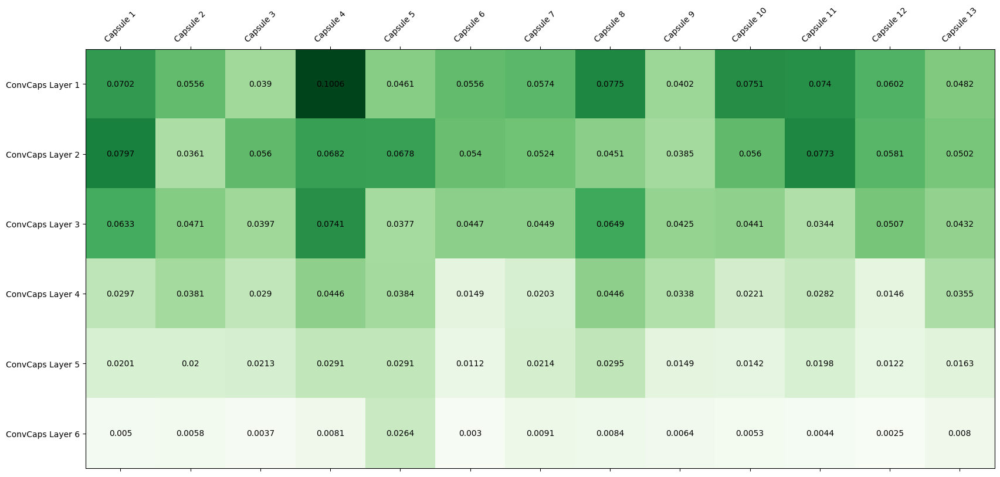

In [ ]:
utils.plot_caps_layers_activations(capsnet_inter6_convcaps_activations,
                                   n_caps=capsnet_inter6_convcaps_activations['intermediate_convcaps_layer_1'].shape[0],
                                   n_caps_layers=n_caps_layers, text_en=1)

In [28]:
n_epochs = 15

for epoch in range(10, n_epochs+1):
    trained_inter6_capsnet_model = torch.load(CIFAR10_TRAIN_DIR+'Trained_pruned_37pc_multilayer_inter6_capsnet_cifar10_model_Epoch{}_of_15.pt'.format(epoch))

    pruned_multilayer_inter6_capsnet_cifar10_model.load_state_dict(trained_inter6_capsnet_model['model_state_dict'])

    pruned_multilayer_inter6_capsnet_cifar10_model.name = 'trained_pruned_37pc_multilayer_inter6_capsnet_cifar10_model_epoch{}'.format(epoch)
    pruned_multilayer_inter6_capsnet_cifar10_model = pruned_multilayer_inter6_capsnet_cifar10_model.to(device)

    utils.extract_convcaps_activations(pruned_multilayer_inter6_capsnet_cifar10_model, test_loader, logger, CIFAR10_TRAIN_DIR, device)

03/03 11:15:37 PM | trained_pruned_37pc_multilayer_inter6_capsnet_cifar10_model_epoch10 - Iterations=1/313, Batch Size=32, Top 1 Acc=90.625, Top 5 Acc=100.000
INFO:capsnet:trained_pruned_37pc_multilayer_inter6_capsnet_cifar10_model_epoch10 - Iterations=1/313, Batch Size=32, Top 1 Acc=90.625, Top 5 Acc=100.000
03/03 11:15:37 PM | trained_pruned_37pc_multilayer_inter6_capsnet_cifar10_model_epoch10 - Iterations=2/313, Batch Size=32, Top 1 Acc=79.688, Top 5 Acc=93.750
INFO:capsnet:trained_pruned_37pc_multilayer_inter6_capsnet_cifar10_model_epoch10 - Iterations=2/313, Batch Size=32, Top 1 Acc=79.688, Top 5 Acc=93.750
03/03 11:15:37 PM | trained_pruned_37pc_multilayer_inter6_capsnet_cifar10_model_epoch10 - Iterations=3/313, Batch Size=32, Top 1 Acc=83.333, Top 5 Acc=95.833
INFO:capsnet:trained_pruned_37pc_multilayer_inter6_capsnet_cifar10_model_epoch10 - Iterations=3/313, Batch Size=32, Top 1 Acc=83.333, Top 5 Acc=95.833
03/03 11:15:37 PM | trained_pruned_37pc_multilayer_inter6_capsnet_cifar

#### Plots for losses and accuracies

In [ ]:
multilayer_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Trained_pruned_37pc_multilayer_inter6_capsnet_cifar10_model_Epoch15_of_15.pt')

epoch_loss = multilayer_capsnet_cifar10_model['epoch_loss']
epoch_accuracy = multilayer_capsnet_cifar10_model['epoch_accuracy']

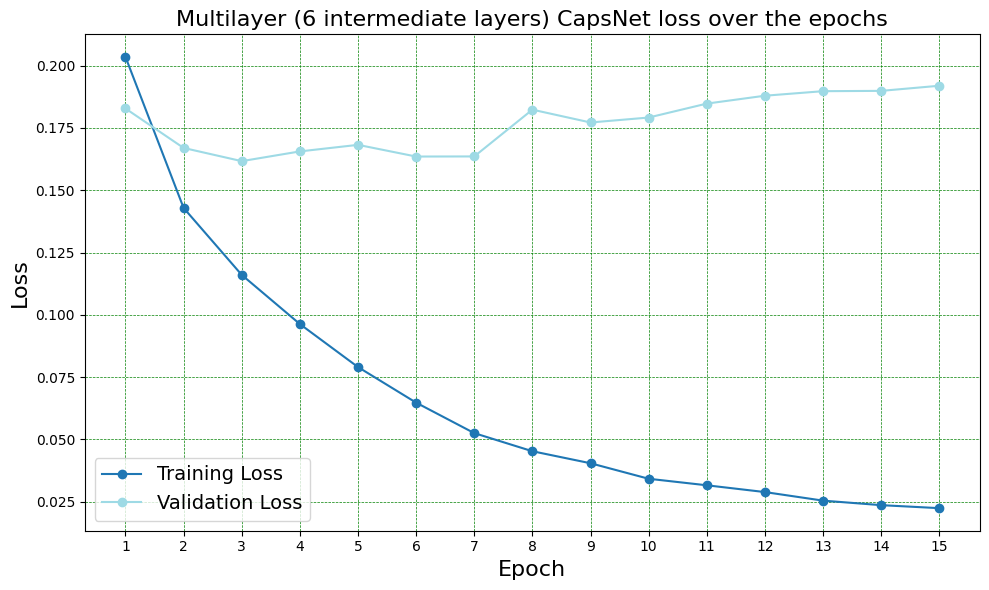

In [ ]:
utils.plot_line_chart(epoch_loss, ['Training Loss', 'Validation Loss'], 'Epoch', 'Loss',
                      'Multilayer (6 intermediate layers) CapsNet loss over the epochs')

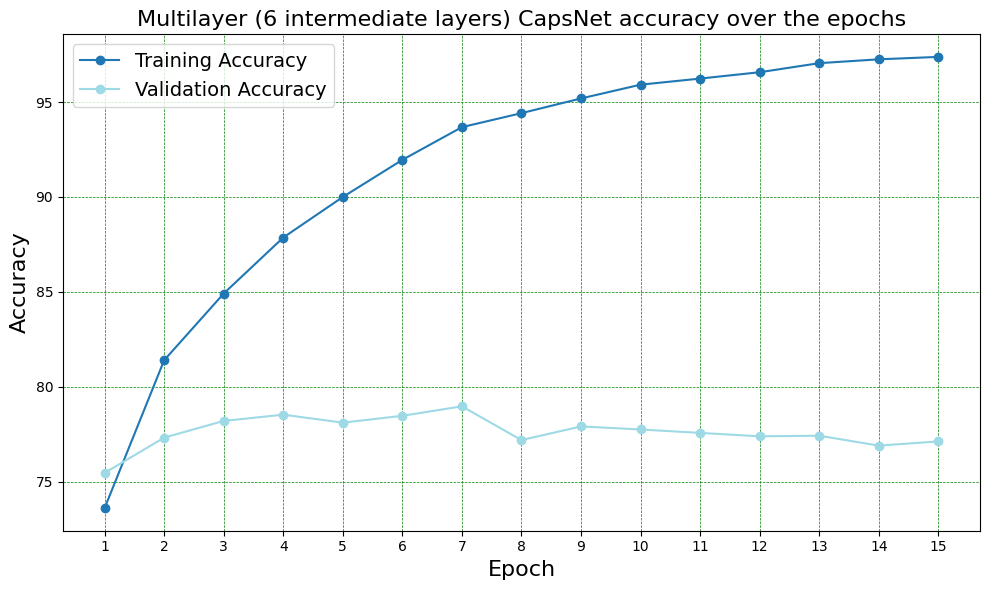

In [ ]:
utils.plot_line_chart(epoch_accuracy, ['Training Accuracy', 'Validation Accuracy'], 'Epoch', 'Accuracy',
                      'Multilayer (6 intermediate layers) CapsNet accuracy over the epochs')

In [ ]:
time.sleep(5)

from google.colab import runtime
runtime.unassign()

## 7 Intermediate Layered CapsNet

In [33]:
CIFAR10_TRAIN_DIR = TRAIN_DIR+"cifar10/20Caps8Dim/"
batch_size=32
n_epochs=15
n_class=10

n_caps_layers=7
prim_caps_channels=20
prim_caps_dim=8

model_conv_config = {'in_img_h':32,
                     'in_img_w':32,
                     'in_img_c':3,
                     'kernel_size':[3, 3, 3, 3],
                     'stride':[1, 2, 1, 2],
                     'padding':[1, 1, 1, 0]}

train_loader, test_loader = image_dataloader(dataset='cifar10', batch_size=batch_size)

criterion = caps.CapsNetLoss(n_class=n_class)

Files already downloaded and verified
Files already downloaded and verified


In [34]:
multilayer_inter7_capsnet_cifar10_model = caps.CapsuleNetwork(in_img_c=3, in_img_h=32, in_img_w=32, n_class=n_class,
                                                               model_conv_config=model_conv_config, prim_caps_channels=prim_caps_channels,
                                                               prim_caps_dim=prim_caps_dim, n_caps_layers=n_caps_layers)

multilayer_inter7_capsnet_cifar10_model.name = 'multilayer_inter7_capsnet_cifar10_model'
multilayer_inter7_capsnet_cifar10_model = multilayer_inter7_capsnet_cifar10_model.to(device)
multilayer_inter7_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 40, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(40, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(40, 80, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(80, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(80, 160, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(160, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(160, 160, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
    (intermediate_co

### 12.5% Pruned Base CapsNet with Intermediate Layers

In [40]:
pruned_model_type = 12

best_pruned_base_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_{}pc_base_capsnet_cifar10_model.pt'.format(pruned_model_type))

pruned_multilayer_inter7_capsnet_cifar10_model = ccmp.create_pruned_model_from_state_dict(
    new_model = multilayer_inter7_capsnet_cifar10_model,
    saved_state_dict = best_pruned_base_capsnet_cifar10_model['model_state_dict'],
    model_conv_config_dict = model_conv_config, n_class = n_class, n_caps_layers = n_caps_layers,
    prim_caps_dim = prim_caps_dim, base_capsnet_stdict = True)

pruned_multilayer_inter7_capsnet_cifar10_model.name = 'pruned_{}pc_multilayer_inter{}_capsnet_cifar10_model'.format(pruned_model_type, n_caps_layers)
pruned_multilayer_inter7_capsnet_cifar10_model = pruned_multilayer_inter7_capsnet_cifar10_model.to(device)
pruned_multilayer_inter7_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 72, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(72, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(72, 144, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(144, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(144, 144, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
    (intermediate_co

In [41]:
%%time
best_trained_model_path, _, _ = mtt.train_capsnet(n_epochs,
                                                  pruned_multilayer_inter7_capsnet_cifar10_model,
                                                  criterion,
                                                  train_loader,
                                                  test_loader,
                                                  CIFAR10_TRAIN_DIR,
                                                  logger,
                                                  device=device)

03/03 11:44:54 PM | pruned_12pc_multilayer_inter7_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.8098, Top 1 Acc=6.25, Top 5 Acc=40.62
INFO:capsnet:pruned_12pc_multilayer_inter7_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.8098, Top 1 Acc=6.25, Top 5 Acc=40.62
03/03 11:45:07 PM | pruned_12pc_multilayer_inter7_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.5617, Top 1 Acc=13.16, Top 5 Acc=57.77
INFO:capsnet:pruned_12pc_multilayer_inter7_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.5617, Top 1 Acc=13.16, Top 5 Acc=57.77
03/03 11:45:24 PM | pruned_12pc_multilayer_inter7_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.4922, Top 1 Acc=22.88, Top 5 Acc=73.32
INFO:capsnet:pruned_12pc_multilayer_inter7_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.4922, Top 1 Acc=22.88, Top 5 Acc=73.32
03/03 11:45:42 PM | pruned_12pc_multilayer_inter7_capsnet_cifar10_model

CPU times: user 2h 36min 41s, sys: 9min 29s, total: 2h 46min 10s
Wall time: 2h 47min 28s


#### Export ConvCaps Activation

In [42]:
pruned_trained_multilayer_inter7_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_12pc_multilayer_inter7_capsnet_cifar10_model.pt')

pruned_multilayer_inter7_capsnet_cifar10_model.load_state_dict(pruned_trained_multilayer_inter7_capsnet_cifar10_model['model_state_dict'])

pruned_multilayer_inter7_capsnet_cifar10_model.name = 'best_pruned_12pc_multilayer_inter7_capsnet_cifar10_model'
pruned_multilayer_inter7_capsnet_cifar10_model = pruned_multilayer_inter7_capsnet_cifar10_model.to(device)
pruned_multilayer_inter7_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 72, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(72, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(72, 144, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(144, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(144, 144, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
    (intermediate_co

In [43]:
capsnet_inter7_convcaps_activations = utils.extract_convcaps_activations(pruned_multilayer_inter7_capsnet_cifar10_model,
                                                                         test_loader, logger, CIFAR10_TRAIN_DIR, device)

03/04 02:32:22 AM | best_pruned_12pc_multilayer_inter7_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=93.750, Top 5 Acc=100.000
INFO:capsnet:best_pruned_12pc_multilayer_inter7_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=93.750, Top 5 Acc=100.000
03/04 02:32:22 AM | best_pruned_12pc_multilayer_inter7_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=79.688, Top 5 Acc=96.875
INFO:capsnet:best_pruned_12pc_multilayer_inter7_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=79.688, Top 5 Acc=96.875
03/04 02:32:22 AM | best_pruned_12pc_multilayer_inter7_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=80.208, Top 5 Acc=97.917
INFO:capsnet:best_pruned_12pc_multilayer_inter7_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=80.208, Top 5 Acc=97.917
03/04 02:32:22 AM | best_pruned_12pc_multilayer_inter7_capsnet_cifar10_model - Iterations=4/313, Batch Size=32, Top 1 Acc=83.594, Top 5 A

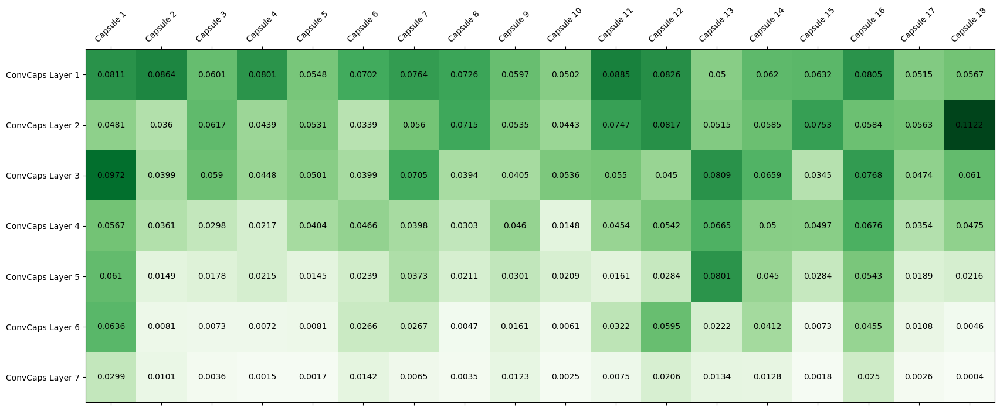

In [44]:
utils.plot_caps_layers_activations(capsnet_inter7_convcaps_activations,
                                   n_caps=capsnet_inter7_convcaps_activations['intermediate_convcaps_layer_1'].shape[0],
                                   n_caps_layers=n_caps_layers, text_en=1)

In [45]:
n_epochs = 15

for epoch in range(1, n_epochs+1):
    trained_inter7_capsnet_model = torch.load(CIFAR10_TRAIN_DIR+'Trained_pruned_12pc_multilayer_inter7_capsnet_cifar10_model_Epoch{}_of_15.pt'.format(epoch))

    pruned_multilayer_inter7_capsnet_cifar10_model.load_state_dict(trained_inter7_capsnet_model['model_state_dict'])

    pruned_multilayer_inter7_capsnet_cifar10_model.name = 'trained_pruned_12pc_multilayer_inter7_capsnet_cifar10_model_epoch{}'.format(epoch)
    pruned_multilayer_inter7_capsnet_cifar10_model = pruned_multilayer_inter7_capsnet_cifar10_model.to(device)

    utils.extract_convcaps_activations(pruned_multilayer_inter7_capsnet_cifar10_model, test_loader, logger, CIFAR10_TRAIN_DIR, device)

Streaming output truncated to the last 5000 lines.
03/04 02:35:51 AM | trained_pruned_12pc_multilayer_inter7_capsnet_cifar10_model_epoch8 - Iterations=13/313, Batch Size=32, Top 1 Acc=79.567, Top 5 Acc=96.154
INFO:capsnet:trained_pruned_12pc_multilayer_inter7_capsnet_cifar10_model_epoch8 - Iterations=13/313, Batch Size=32, Top 1 Acc=79.567, Top 5 Acc=96.154
03/04 02:35:51 AM | trained_pruned_12pc_multilayer_inter7_capsnet_cifar10_model_epoch8 - Iterations=14/313, Batch Size=32, Top 1 Acc=79.018, Top 5 Acc=95.759
INFO:capsnet:trained_pruned_12pc_multilayer_inter7_capsnet_cifar10_model_epoch8 - Iterations=14/313, Batch Size=32, Top 1 Acc=79.018, Top 5 Acc=95.759
03/04 02:35:51 AM | trained_pruned_12pc_multilayer_inter7_capsnet_cifar10_model_epoch8 - Iterations=15/313, Batch Size=32, Top 1 Acc=79.167, Top 5 Acc=96.042
INFO:capsnet:trained_pruned_12pc_multilayer_inter7_capsnet_cifar10_model_epoch8 - Iterations=15/313, Batch Size=32, Top 1 Acc=79.167, Top 5 Acc=96.042
03/04 02:35:51 AM | tr

#### Plots for losses and accuracies

In [46]:
multilayer_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Trained_pruned_12pc_multilayer_inter7_capsnet_cifar10_model_Epoch15_of_15.pt')

epoch_loss = multilayer_capsnet_cifar10_model['epoch_loss']
epoch_accuracy = multilayer_capsnet_cifar10_model['epoch_accuracy']

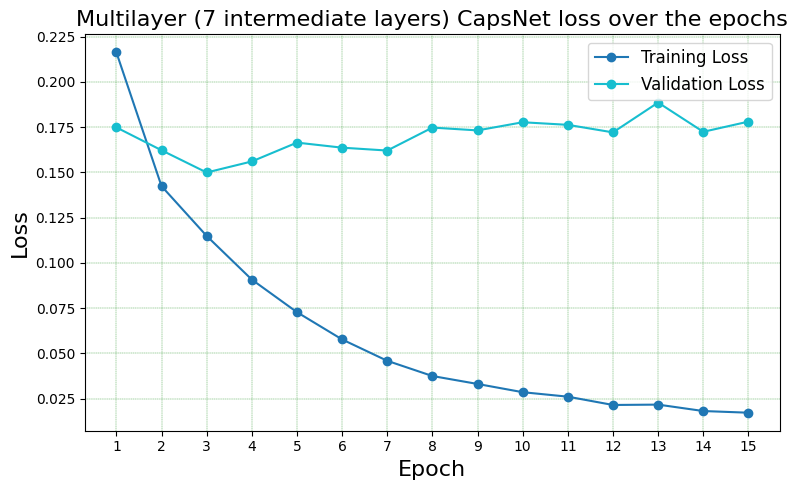

In [47]:
utils.plot_line_chart(epoch_loss, ['Training Loss', 'Validation Loss'], 'Epoch', 'Loss',
                      'Multilayer (7 intermediate layers) CapsNet loss over the epochs')

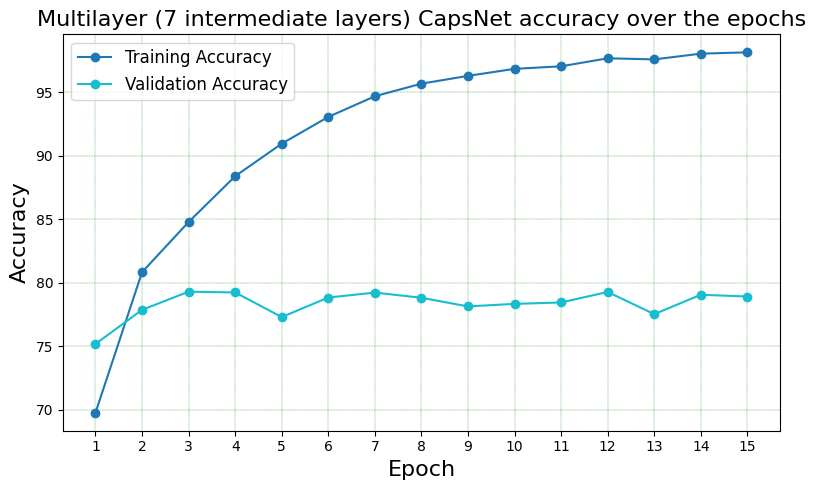

In [48]:
utils.plot_line_chart(epoch_accuracy, ['Training Accuracy', 'Validation Accuracy'], 'Epoch', 'Accuracy',
                      'Multilayer (7 intermediate layers) CapsNet accuracy over the epochs')

### 25% Pruned Base CapsNet with Intermediate Layers

In [35]:
pruned_model_type = 25

best_pruned_base_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_{}pc_base_capsnet_cifar10_model.pt'.format(pruned_model_type))

pruned_multilayer_inter7_capsnet_cifar10_model = ccmp.create_pruned_model_from_state_dict(
    new_model = multilayer_inter7_capsnet_cifar10_model,
    saved_state_dict = best_pruned_base_capsnet_cifar10_model['model_state_dict'],
    model_conv_config_dict = model_conv_config, n_class = n_class, n_caps_layers = n_caps_layers,
    prim_caps_dim = prim_caps_dim, base_capsnet_stdict = True)

pruned_multilayer_inter7_capsnet_cifar10_model.name = 'pruned_{}pc_multilayer_inter{}_capsnet_cifar10_model'.format(pruned_model_type, n_caps_layers)
pruned_multilayer_inter7_capsnet_cifar10_model = pruned_multilayer_inter7_capsnet_cifar10_model.to(device)
pruned_multilayer_inter7_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(64, 120, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(120, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(120, 120, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
    (intermediate_co

In [ ]:
%%time
best_trained_model_path, _, _ = mtt.train_capsnet(n_epochs,
                                                  pruned_multilayer_inter7_capsnet_cifar10_model,
                                                  criterion,
                                                  train_loader,
                                                  test_loader,
                                                  CIFAR10_TRAIN_DIR,
                                                  logger,
                                                  device=device)

03/01 02:04:20 PM | pruned_25pc_multilayer_inter7_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.7967, Top 1 Acc=18.75, Top 5 Acc=50.00
INFO:capsnet:pruned_25pc_multilayer_inter7_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.7967, Top 1 Acc=18.75, Top 5 Acc=50.00
03/01 02:04:29 PM | pruned_25pc_multilayer_inter7_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.4839, Top 1 Acc=30.21, Top 5 Acc=76.42
INFO:capsnet:pruned_25pc_multilayer_inter7_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.4839, Top 1 Acc=30.21, Top 5 Acc=76.42
03/01 02:04:39 PM | pruned_25pc_multilayer_inter7_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.4114, Top 1 Acc=41.15, Top 5 Acc=85.53
INFO:capsnet:pruned_25pc_multilayer_inter7_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.4114, Top 1 Acc=41.15, Top 5 Acc=85.53
03/01 02:04:48 PM | pruned_25pc_multilayer_inter7_capsnet_cifar10_mod

CPU times: user 1h 51min 41s, sys: 8min 2s, total: 1h 59min 43s
Wall time: 1h 59min 27s


#### Export ConvCaps Activation

In [ ]:
pruned_trained_multilayer_inter7_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_25pc_multilayer_inter7_capsnet_cifar10_model.pt')

pruned_multilayer_inter7_capsnet_cifar10_model.load_state_dict(pruned_trained_multilayer_inter7_capsnet_cifar10_model['model_state_dict'])

pruned_multilayer_inter7_capsnet_cifar10_model.name = 'best_pruned_25pc_multilayer_inter7_capsnet_cifar10_model'
pruned_multilayer_inter7_capsnet_cifar10_model = pruned_multilayer_inter7_capsnet_cifar10_model.to(device)
pruned_multilayer_inter7_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(64, 120, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(120, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(120, 120, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
    (intermediate_co

In [ ]:
capsnet_inter7_convcaps_activations = utils.extract_convcaps_activations(pruned_multilayer_inter7_capsnet_cifar10_model,
                                                                         test_loader, logger, CIFAR10_TRAIN_DIR, device)

03/01 04:03:44 PM | best_pruned_25pc_multilayer_inter7_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=90.625, Top 5 Acc=100.000
INFO:capsnet:best_pruned_25pc_multilayer_inter7_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=90.625, Top 5 Acc=100.000
03/01 04:03:45 PM | best_pruned_25pc_multilayer_inter7_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=78.125, Top 5 Acc=100.000
INFO:capsnet:best_pruned_25pc_multilayer_inter7_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=78.125, Top 5 Acc=100.000
03/01 04:03:45 PM | best_pruned_25pc_multilayer_inter7_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=79.167, Top 5 Acc=98.958
INFO:capsnet:best_pruned_25pc_multilayer_inter7_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=79.167, Top 5 Acc=98.958
03/01 04:03:45 PM | best_pruned_25pc_multilayer_inter7_capsnet_cifar10_model - Iterations=4/313, Batch Size=32, Top 1 Acc=81.250, Top 5

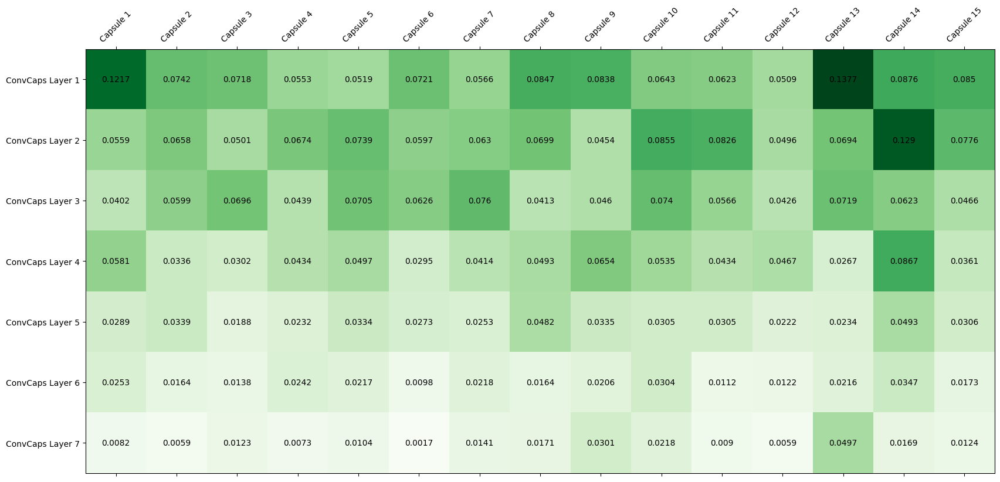

In [ ]:
utils.plot_caps_layers_activations(capsnet_inter7_convcaps_activations,
                                   n_caps=capsnet_inter7_convcaps_activations['intermediate_convcaps_layer_1'].shape[0],
                                   n_caps_layers=n_caps_layers, text_en=1)

In [37]:
n_epochs = 15

for epoch in range(1, n_epochs+1):
    trained_inter7_capsnet_model = torch.load(CIFAR10_TRAIN_DIR+'Trained_pruned_25pc_multilayer_inter7_capsnet_cifar10_model_Epoch{}_of_15.pt'.format(epoch))

    pruned_multilayer_inter7_capsnet_cifar10_model.load_state_dict(trained_inter7_capsnet_model['model_state_dict'])

    pruned_multilayer_inter7_capsnet_cifar10_model.name = 'trained_pruned_25pc_multilayer_inter7_capsnet_cifar10_model_epoch{}'.format(epoch)
    pruned_multilayer_inter7_capsnet_cifar10_model = pruned_multilayer_inter7_capsnet_cifar10_model.to(device)

    utils.extract_convcaps_activations(pruned_multilayer_inter7_capsnet_cifar10_model, test_loader, logger, CIFAR10_TRAIN_DIR, device)

Streaming output truncated to the last 5000 lines.
03/03 11:26:57 PM | trained_pruned_25pc_multilayer_inter7_capsnet_cifar10_model_epoch8 - Iterations=13/313, Batch Size=32, Top 1 Acc=77.163, Top 5 Acc=96.875
INFO:capsnet:trained_pruned_25pc_multilayer_inter7_capsnet_cifar10_model_epoch8 - Iterations=13/313, Batch Size=32, Top 1 Acc=77.163, Top 5 Acc=96.875
03/03 11:26:57 PM | trained_pruned_25pc_multilayer_inter7_capsnet_cifar10_model_epoch8 - Iterations=14/313, Batch Size=32, Top 1 Acc=76.562, Top 5 Acc=96.652
INFO:capsnet:trained_pruned_25pc_multilayer_inter7_capsnet_cifar10_model_epoch8 - Iterations=14/313, Batch Size=32, Top 1 Acc=76.562, Top 5 Acc=96.652
03/03 11:26:57 PM | trained_pruned_25pc_multilayer_inter7_capsnet_cifar10_model_epoch8 - Iterations=15/313, Batch Size=32, Top 1 Acc=76.667, Top 5 Acc=96.875
INFO:capsnet:trained_pruned_25pc_multilayer_inter7_capsnet_cifar10_model_epoch8 - Iterations=15/313, Batch Size=32, Top 1 Acc=76.667, Top 5 Acc=96.875
03/03 11:26:57 PM | tr

#### Plots for losses and accuracies

In [ ]:
multilayer_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Trained_pruned_25pc_multilayer_inter7_capsnet_cifar10_model_Epoch15_of_15.pt')

epoch_loss = multilayer_capsnet_cifar10_model['epoch_loss']
epoch_accuracy = multilayer_capsnet_cifar10_model['epoch_accuracy']

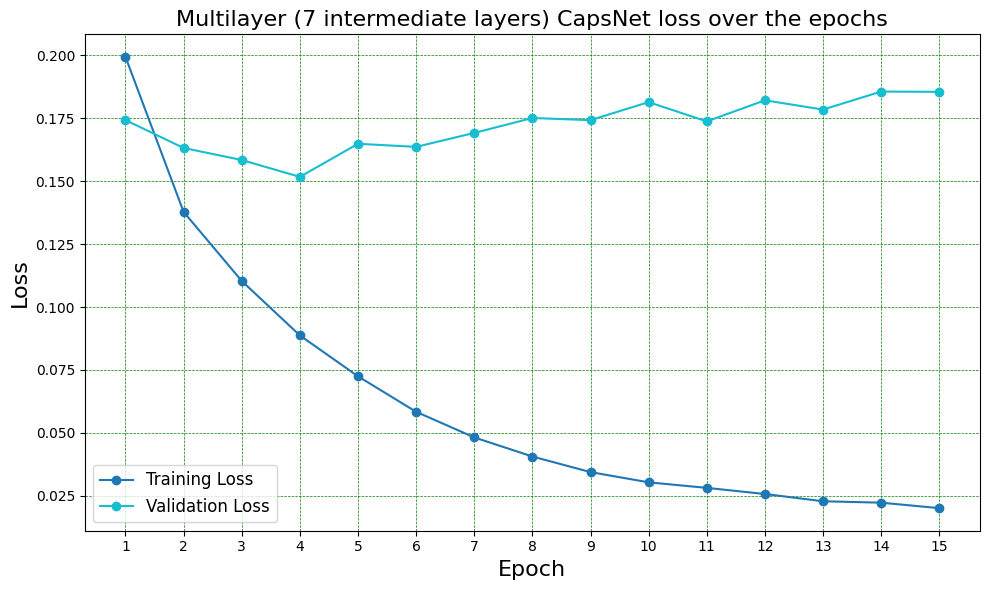

In [ ]:
utils.plot_line_chart(epoch_loss, ['Training Loss', 'Validation Loss'], 'Epoch', 'Loss',
                      'Multilayer (7 intermediate layers) CapsNet loss over the epochs')

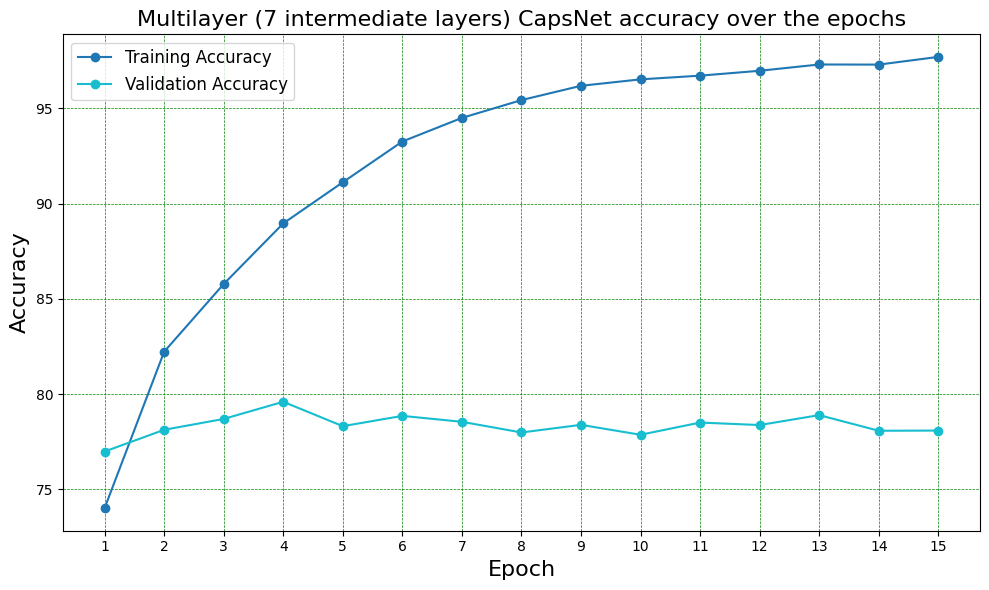

In [ ]:
utils.plot_line_chart(epoch_accuracy, ['Training Accuracy', 'Validation Accuracy'], 'Epoch', 'Accuracy',
                      'Multilayer (7 intermediate layers) CapsNet accuracy over the epochs')

### 37.5% Pruned Base CapsNet with Intermediate Layers

In [38]:
pruned_model_type = 37

best_pruned_base_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_{}pc_base_capsnet_cifar10_model.pt'.format(pruned_model_type))

pruned_multilayer_inter7_capsnet_cifar10_model = ccmp.create_pruned_model_from_state_dict(
    new_model = multilayer_inter7_capsnet_cifar10_model,
    saved_state_dict = best_pruned_base_capsnet_cifar10_model['model_state_dict'],
    model_conv_config_dict = model_conv_config, n_class = n_class, n_caps_layers = n_caps_layers,
    prim_caps_dim = prim_caps_dim, base_capsnet_stdict = True)

pruned_multilayer_inter7_capsnet_cifar10_model.name = 'pruned_{}pc_multilayer_inter{}_capsnet_cifar10_model'.format(pruned_model_type, n_caps_layers)
pruned_multilayer_inter7_capsnet_cifar10_model = pruned_multilayer_inter7_capsnet_cifar10_model.to(device)
pruned_multilayer_inter7_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 56, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(56, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(56, 104, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(104, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(104, 104, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
    (intermediate_co

In [ ]:
%%time
best_trained_model_path, _, _ = mtt.train_capsnet(n_epochs,
                                                  pruned_multilayer_inter7_capsnet_cifar10_model,
                                                  criterion,
                                                  train_loader,
                                                  test_loader,
                                                  CIFAR10_TRAIN_DIR,
                                                  logger,
                                                  device=device)

03/01 04:04:04 PM | pruned_37pc_multilayer_inter7_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.7760, Top 1 Acc=6.25, Top 5 Acc=62.50
INFO:capsnet:pruned_37pc_multilayer_inter7_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.7760, Top 1 Acc=6.25, Top 5 Acc=62.50
03/01 04:04:13 PM | pruned_37pc_multilayer_inter7_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.4849, Top 1 Acc=27.27, Top 5 Acc=79.26
INFO:capsnet:pruned_37pc_multilayer_inter7_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.4849, Top 1 Acc=27.27, Top 5 Acc=79.26
03/01 04:04:22 PM | pruned_37pc_multilayer_inter7_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.4138, Top 1 Acc=39.86, Top 5 Acc=86.25
INFO:capsnet:pruned_37pc_multilayer_inter7_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.4138, Top 1 Acc=39.86, Top 5 Acc=86.25
03/01 04:04:31 PM | pruned_37pc_multilayer_inter7_capsnet_cifar10_model

CPU times: user 1h 47min 18s, sys: 8min 8s, total: 1h 55min 26s
Wall time: 1h 55min 8s


#### Export ConvCaps Activation

In [ ]:
pruned_trained_multilayer_inter7_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_37pc_multilayer_inter7_capsnet_cifar10_model.pt')

pruned_multilayer_inter7_capsnet_cifar10_model.load_state_dict(pruned_trained_multilayer_inter7_capsnet_cifar10_model['model_state_dict'])

pruned_multilayer_inter7_capsnet_cifar10_model.name = 'best_pruned_37pc_multilayer_inter7_capsnet_cifar10_model'
pruned_multilayer_inter7_capsnet_cifar10_model = pruned_multilayer_inter7_capsnet_cifar10_model.to(device)
pruned_multilayer_inter7_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 56, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(56, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(56, 104, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(104, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(104, 104, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
    (intermediate_co

In [ ]:
capsnet_inter7_convcaps_activations = utils.extract_convcaps_activations(pruned_multilayer_inter7_capsnet_cifar10_model,
                                                                         test_loader, logger, CIFAR10_TRAIN_DIR, device)

03/01 05:59:12 PM | best_pruned_37pc_multilayer_inter7_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=87.500, Top 5 Acc=96.875
INFO:capsnet:best_pruned_37pc_multilayer_inter7_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=87.500, Top 5 Acc=96.875
03/01 05:59:12 PM | best_pruned_37pc_multilayer_inter7_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=75.000, Top 5 Acc=98.438
INFO:capsnet:best_pruned_37pc_multilayer_inter7_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=75.000, Top 5 Acc=98.438
03/01 05:59:12 PM | best_pruned_37pc_multilayer_inter7_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=75.000, Top 5 Acc=96.875
INFO:capsnet:best_pruned_37pc_multilayer_inter7_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=75.000, Top 5 Acc=96.875
03/01 05:59:12 PM | best_pruned_37pc_multilayer_inter7_capsnet_cifar10_model - Iterations=4/313, Batch Size=32, Top 1 Acc=79.688, Top 5 Acc

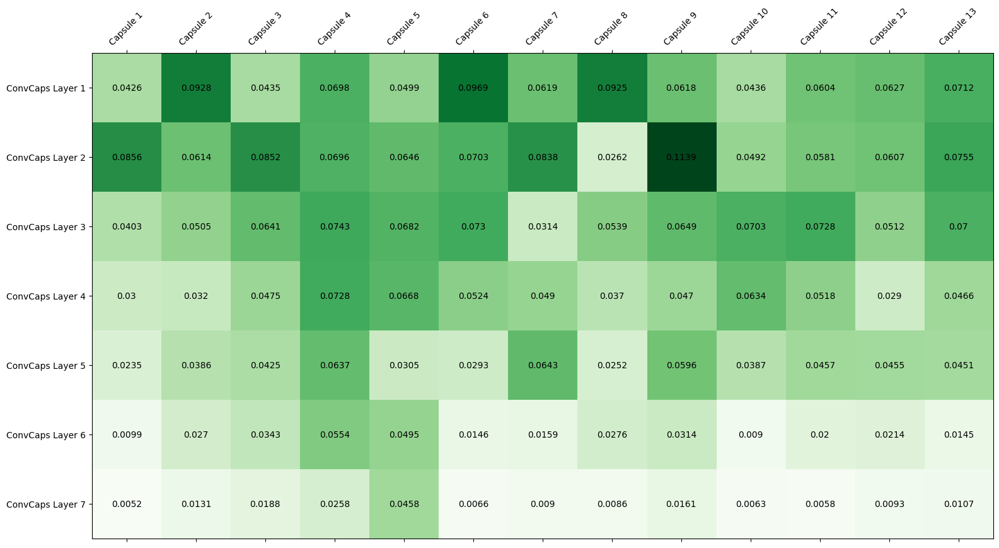

In [ ]:
utils.plot_caps_layers_activations(capsnet_inter7_convcaps_activations,
                                   n_caps=capsnet_inter7_convcaps_activations['intermediate_convcaps_layer_1'].shape[0],
                                   n_caps_layers=n_caps_layers, text_en=1)

In [39]:
n_epochs = 15

for epoch in range(1, n_epochs+1):
    trained_inter7_capsnet_model = torch.load(CIFAR10_TRAIN_DIR+'Trained_pruned_37pc_multilayer_inter7_capsnet_cifar10_model_Epoch{}_of_15.pt'.format(epoch))

    pruned_multilayer_inter7_capsnet_cifar10_model.load_state_dict(trained_inter7_capsnet_model['model_state_dict'])

    pruned_multilayer_inter7_capsnet_cifar10_model.name = 'trained_pruned_37pc_multilayer_inter7_capsnet_cifar10_model_epoch{}'.format(epoch)
    pruned_multilayer_inter7_capsnet_cifar10_model = pruned_multilayer_inter7_capsnet_cifar10_model.to(device)

    utils.extract_convcaps_activations(pruned_multilayer_inter7_capsnet_cifar10_model, test_loader, logger, CIFAR10_TRAIN_DIR, device)

Streaming output truncated to the last 5000 lines.
03/03 11:40:38 PM | trained_pruned_37pc_multilayer_inter7_capsnet_cifar10_model_epoch8 - Iterations=13/313, Batch Size=32, Top 1 Acc=79.087, Top 5 Acc=96.635
INFO:capsnet:trained_pruned_37pc_multilayer_inter7_capsnet_cifar10_model_epoch8 - Iterations=13/313, Batch Size=32, Top 1 Acc=79.087, Top 5 Acc=96.635
03/03 11:40:38 PM | trained_pruned_37pc_multilayer_inter7_capsnet_cifar10_model_epoch8 - Iterations=14/313, Batch Size=32, Top 1 Acc=78.571, Top 5 Acc=96.652
INFO:capsnet:trained_pruned_37pc_multilayer_inter7_capsnet_cifar10_model_epoch8 - Iterations=14/313, Batch Size=32, Top 1 Acc=78.571, Top 5 Acc=96.652
03/03 11:40:38 PM | trained_pruned_37pc_multilayer_inter7_capsnet_cifar10_model_epoch8 - Iterations=15/313, Batch Size=32, Top 1 Acc=78.750, Top 5 Acc=96.667
INFO:capsnet:trained_pruned_37pc_multilayer_inter7_capsnet_cifar10_model_epoch8 - Iterations=15/313, Batch Size=32, Top 1 Acc=78.750, Top 5 Acc=96.667
03/03 11:40:38 PM | tr

#### Plots for losses and accuracies

In [ ]:
multilayer_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Trained_pruned_37pc_multilayer_inter7_capsnet_cifar10_model_Epoch15_of_15.pt')

epoch_loss = multilayer_capsnet_cifar10_model['epoch_loss']
epoch_accuracy = multilayer_capsnet_cifar10_model['epoch_accuracy']

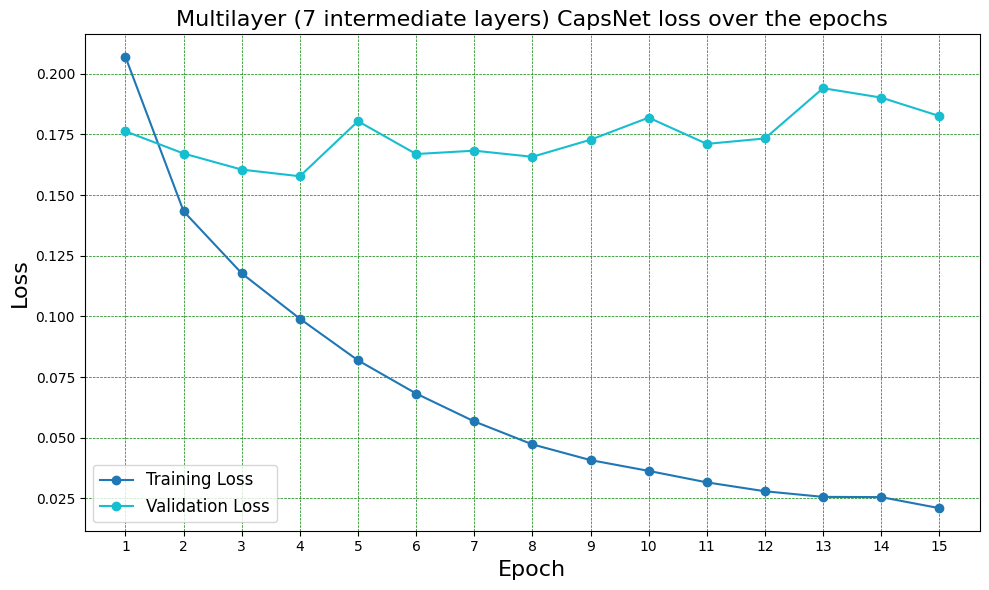

In [ ]:
utils.plot_line_chart(epoch_loss, ['Training Loss', 'Validation Loss'], 'Epoch', 'Loss',
                      'Multilayer (7 intermediate layers) CapsNet loss over the epochs')

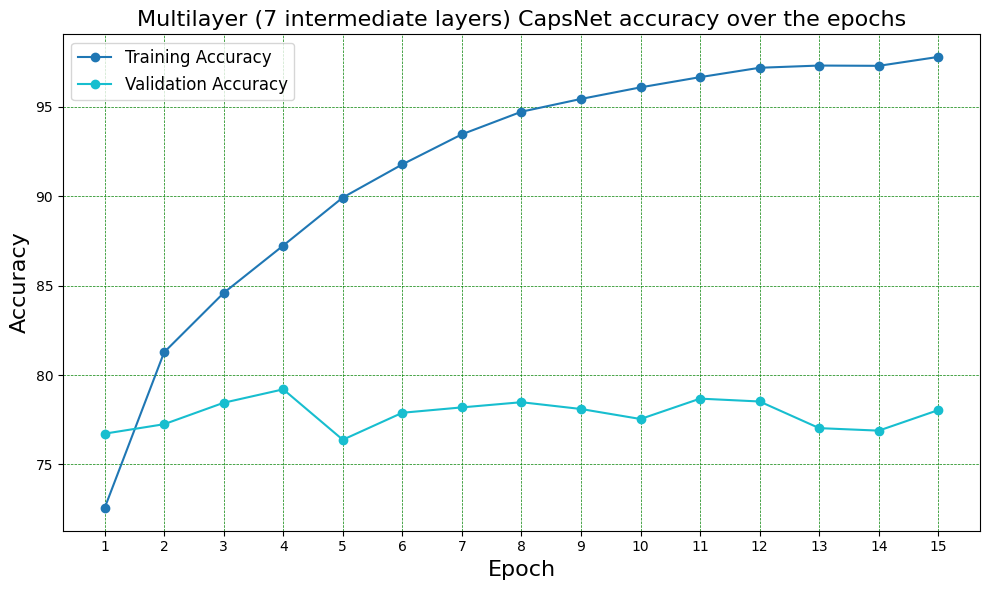

In [ ]:
utils.plot_line_chart(epoch_accuracy, ['Training Accuracy', 'Validation Accuracy'], 'Epoch', 'Accuracy',
                      'Multilayer (7 intermediate layers) CapsNet accuracy over the epochs')

## 8 Intermediate Layered CapsNet

In [49]:
CIFAR10_TRAIN_DIR = TRAIN_DIR+"cifar10/20Caps8Dim/"
batch_size=32
n_epochs=15
n_class=10

n_caps_layers=8
prim_caps_channels=20
prim_caps_dim=8

model_conv_config = {'in_img_h':32,
                     'in_img_w':32,
                     'in_img_c':3,
                     'kernel_size':[3, 3, 3, 3],
                     'stride':[1, 2, 1, 2],
                     'padding':[1, 1, 1, 0]}

train_loader, test_loader = image_dataloader(dataset='cifar10', batch_size=batch_size)

criterion = caps.CapsNetLoss(n_class=n_class)

Files already downloaded and verified
Files already downloaded and verified


In [50]:
multilayer_inter8_capsnet_cifar10_model = caps.CapsuleNetwork(in_img_c=3, in_img_h=32, in_img_w=32, n_class=n_class,
                                                               model_conv_config=model_conv_config, prim_caps_channels=prim_caps_channels,
                                                               prim_caps_dim=prim_caps_dim, n_caps_layers=n_caps_layers)

multilayer_inter8_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 40, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(40, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(40, 80, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(80, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(80, 160, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(160, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(160, 160, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
    (intermediate_co

### 12.5% Pruned Base CapsNet with Intermediate Layers

In [51]:
pruned_model_type = 12

best_pruned_base_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_{}pc_base_capsnet_cifar10_model.pt'.format(pruned_model_type))

pruned_multilayer_inter8_capsnet_cifar10_model = ccmp.create_pruned_model_from_state_dict(
    new_model = multilayer_inter8_capsnet_cifar10_model,
    saved_state_dict = best_pruned_base_capsnet_cifar10_model['model_state_dict'],
    model_conv_config_dict = model_conv_config, n_class = n_class, n_caps_layers = n_caps_layers,
    prim_caps_dim = prim_caps_dim, base_capsnet_stdict = True)

pruned_multilayer_inter8_capsnet_cifar10_model.name = 'pruned_{}pc_multilayer_inter{}_capsnet_cifar10_model'.format(pruned_model_type, n_caps_layers)
pruned_multilayer_inter8_capsnet_cifar10_model = pruned_multilayer_inter8_capsnet_cifar10_model.to(device)
pruned_multilayer_inter8_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 72, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(72, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(72, 144, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(144, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(144, 144, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
    (intermediate_co

In [52]:
%%time
best_trained_model_path, _, _ = mtt.train_capsnet(n_epochs,
                                                  pruned_multilayer_inter8_capsnet_cifar10_model,
                                                  criterion,
                                                  train_loader,
                                                  test_loader,
                                                  CIFAR10_TRAIN_DIR,
                                                  logger,
                                                  device=device)

03/04 02:46:26 AM | pruned_12pc_multilayer_inter8_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.8100, Top 1 Acc=21.88, Top 5 Acc=53.12
INFO:capsnet:pruned_12pc_multilayer_inter8_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.8100, Top 1 Acc=21.88, Top 5 Acc=53.12
03/04 02:46:41 AM | pruned_12pc_multilayer_inter8_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.8100, Top 1 Acc=11.65, Top 5 Acc=48.77
INFO:capsnet:pruned_12pc_multilayer_inter8_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.8100, Top 1 Acc=11.65, Top 5 Acc=48.77
03/04 02:46:56 AM | pruned_12pc_multilayer_inter8_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.8100, Top 1 Acc=10.91, Top 5 Acc=49.57
INFO:capsnet:pruned_12pc_multilayer_inter8_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.8100, Top 1 Acc=10.91, Top 5 Acc=49.57
03/04 02:47:11 AM | pruned_12pc_multilayer_inter8_capsnet_cifar10_mod

KeyboardInterrupt: 

### 25% Pruned Base CapsNet with Intermediate Layers

In [ ]:
pruned_model_type = 25

best_pruned_base_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_{}pc_base_capsnet_cifar10_model.pt'.format(pruned_model_type))

pruned_multilayer_inter8_capsnet_cifar10_model = ccmp.create_pruned_model_from_state_dict(
    new_model = multilayer_inter8_capsnet_cifar10_model,
    saved_state_dict = best_pruned_base_capsnet_cifar10_model['model_state_dict'],
    model_conv_config_dict = model_conv_config, n_class = n_class, n_caps_layers = n_caps_layers,
    prim_caps_dim = prim_caps_dim, base_capsnet_stdict = True)

pruned_multilayer_inter8_capsnet_cifar10_model.name = 'pruned_{}pc_multilayer_inter{}_capsnet_cifar10_model'.format(pruned_model_type, n_caps_layers)
pruned_multilayer_inter8_capsnet_cifar10_model = pruned_multilayer_inter8_capsnet_cifar10_model.to(device)
pruned_multilayer_inter8_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(64, 120, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(120, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(120, 120, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
    (intermediate_co

In [ ]:
%%time
best_trained_model_path, _, _ = mtt.train_capsnet(n_epochs,
                                                  pruned_multilayer_inter8_capsnet_cifar10_model,
                                                  criterion,
                                                  train_loader,
                                                  test_loader,
                                                  CIFAR10_TRAIN_DIR,
                                                  logger,
                                                  device=device)

03/01 06:01:32 PM | pruned_25pc_multilayer_inter8_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.8093, Top 1 Acc=9.38, Top 5 Acc=59.38
INFO:capsnet:pruned_25pc_multilayer_inter8_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.8093, Top 1 Acc=9.38, Top 5 Acc=59.38
03/01 06:01:43 PM | pruned_25pc_multilayer_inter8_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.5182, Top 1 Acc=20.93, Top 5 Acc=71.88
INFO:capsnet:pruned_25pc_multilayer_inter8_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.5182, Top 1 Acc=20.93, Top 5 Acc=71.88
03/01 06:01:54 PM | pruned_25pc_multilayer_inter8_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.4463, Top 1 Acc=33.08, Top 5 Acc=81.54
INFO:capsnet:pruned_25pc_multilayer_inter8_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.4463, Top 1 Acc=33.08, Top 5 Acc=81.54
03/01 06:02:05 PM | pruned_25pc_multilayer_inter8_capsnet_cifar10_model

CPU times: user 2h 7min 3s, sys: 9min 3s, total: 2h 16min 7s
Wall time: 2h 15min 46s


#### Export ConvCaps Activation

In [ ]:
pruned_trained_multilayer_inter8_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_25pc_multilayer_inter8_capsnet_cifar10_model.pt')

pruned_multilayer_inter8_capsnet_cifar10_model.load_state_dict(pruned_trained_multilayer_inter8_capsnet_cifar10_model['model_state_dict'])

pruned_multilayer_inter8_capsnet_cifar10_model.name = 'best_pruned_25pc_multilayer_inter8_capsnet_cifar10_model'
pruned_multilayer_inter8_capsnet_cifar10_model = pruned_multilayer_inter8_capsnet_cifar10_model.to(device)
pruned_multilayer_inter8_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(64, 120, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(120, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(120, 120, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
    (intermediate_co

In [ ]:
capsnet_inter8_convcaps_activations = utils.extract_convcaps_activations(pruned_multilayer_inter8_capsnet_cifar10_model,
                                                                         test_loader, logger, CIFAR10_TRAIN_DIR, device)

03/01 08:17:19 PM | best_pruned_25pc_multilayer_inter8_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=87.500, Top 5 Acc=100.000
INFO:capsnet:best_pruned_25pc_multilayer_inter8_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=87.500, Top 5 Acc=100.000
03/01 08:17:19 PM | best_pruned_25pc_multilayer_inter8_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=79.688, Top 5 Acc=95.312
INFO:capsnet:best_pruned_25pc_multilayer_inter8_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=79.688, Top 5 Acc=95.312
03/01 08:17:19 PM | best_pruned_25pc_multilayer_inter8_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=78.125, Top 5 Acc=96.875
INFO:capsnet:best_pruned_25pc_multilayer_inter8_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=78.125, Top 5 Acc=96.875
03/01 08:17:19 PM | best_pruned_25pc_multilayer_inter8_capsnet_cifar10_model - Iterations=4/313, Batch Size=32, Top 1 Acc=82.031, Top 5 A

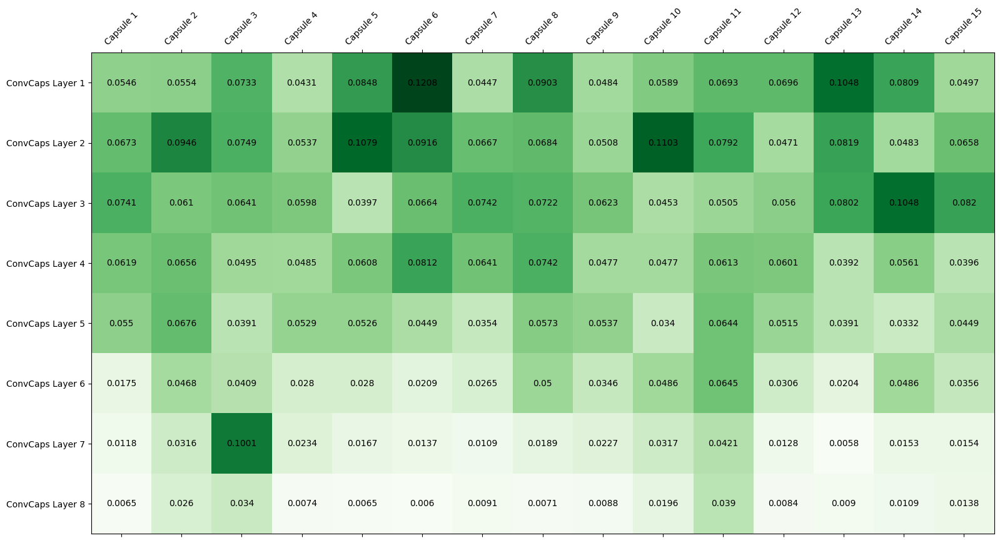

In [ ]:
utils.plot_caps_layers_activations(capsnet_inter8_convcaps_activations,
                                   n_caps=capsnet_inter8_convcaps_activations['intermediate_convcaps_layer_1'].shape[0],
                                   n_caps_layers=n_caps_layers, text_en=1)

#### Plots for losses and accuracies

In [ ]:
multilayer_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Trained_pruned_25pc_multilayer_inter8_capsnet_cifar10_model_Epoch15_of_15.pt')

epoch_loss = multilayer_capsnet_cifar10_model['epoch_loss']
epoch_accuracy = multilayer_capsnet_cifar10_model['epoch_accuracy']

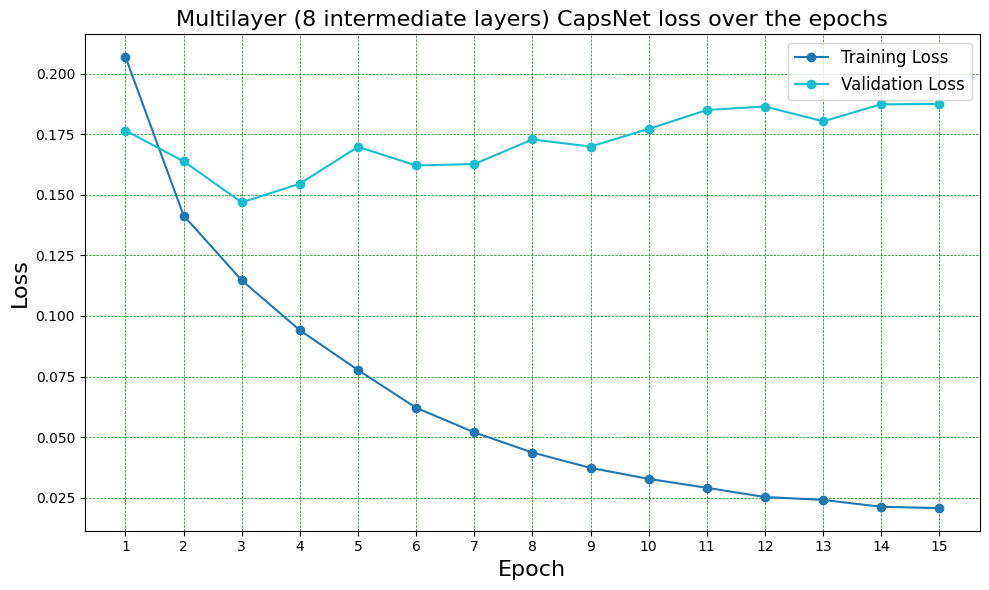

In [ ]:
utils.plot_line_chart(epoch_loss, ['Training Loss', 'Validation Loss'], 'Epoch', 'Loss',
                      'Multilayer (8 intermediate layers) CapsNet loss over the epochs')

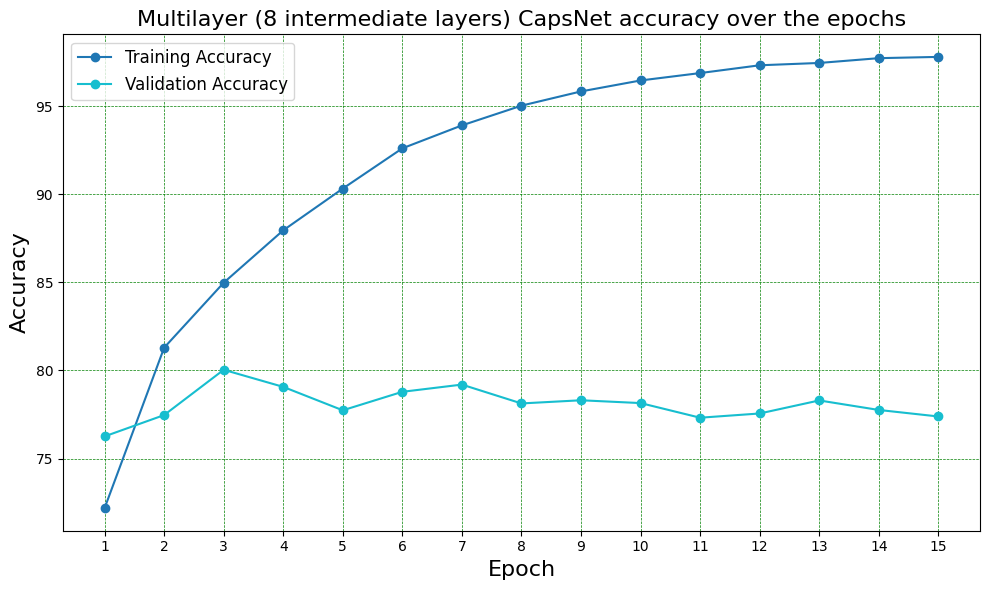

In [ ]:
utils.plot_line_chart(epoch_accuracy, ['Training Accuracy', 'Validation Accuracy'], 'Epoch', 'Accuracy',
                      'Multilayer (8 intermediate layers) CapsNet accuracy over the epochs')

### 37.5% Pruned Base CapsNet with Intermediate Layers

In [ ]:
pruned_model_type = 37

best_pruned_base_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_{}pc_base_capsnet_cifar10_model.pt'.format(pruned_model_type))

pruned_multilayer_inter8_capsnet_cifar10_model = ccmp.create_pruned_model_from_state_dict(
    new_model = multilayer_inter8_capsnet_cifar10_model,
    saved_state_dict = best_pruned_base_capsnet_cifar10_model['model_state_dict'],
    model_conv_config_dict = model_conv_config, n_class = n_class, n_caps_layers = n_caps_layers,
    prim_caps_dim = prim_caps_dim, base_capsnet_stdict = True)

pruned_multilayer_inter8_capsnet_cifar10_model.name = 'pruned_{}pc_multilayer_inter{}_capsnet_cifar10_model'.format(pruned_model_type, n_caps_layers)
pruned_multilayer_inter8_capsnet_cifar10_model = pruned_multilayer_inter8_capsnet_cifar10_model.to(device)
pruned_multilayer_inter8_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 56, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(56, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(56, 104, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(104, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(104, 104, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
    (intermediate_co

In [ ]:
%%time
best_trained_model_path, _, _ = mtt.train_capsnet(n_epochs,
                                                  pruned_multilayer_inter8_capsnet_cifar10_model,
                                                  criterion,
                                                  train_loader,
                                                  test_loader,
                                                  CIFAR10_TRAIN_DIR,
                                                  logger,
                                                  device=device)

03/01 08:17:37 PM | pruned_37pc_multilayer_inter8_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.7959, Top 1 Acc=6.25, Top 5 Acc=53.12
INFO:capsnet:pruned_37pc_multilayer_inter8_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.7959, Top 1 Acc=6.25, Top 5 Acc=53.12
03/01 08:17:47 PM | pruned_37pc_multilayer_inter8_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.5141, Top 1 Acc=23.39, Top 5 Acc=73.67
INFO:capsnet:pruned_37pc_multilayer_inter8_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.5141, Top 1 Acc=23.39, Top 5 Acc=73.67
03/01 08:17:58 PM | pruned_37pc_multilayer_inter8_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.4474, Top 1 Acc=33.94, Top 5 Acc=82.21
INFO:capsnet:pruned_37pc_multilayer_inter8_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.4474, Top 1 Acc=33.94, Top 5 Acc=82.21
03/01 08:18:08 PM | pruned_37pc_multilayer_inter8_capsnet_cifar10_model

CPU times: user 2h 1min 48s, sys: 9min 9s, total: 2h 10min 57s
Wall time: 2h 10min 38s


#### Export ConvCaps Activation

In [ ]:
pruned_trained_multilayer_inter8_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_37pc_multilayer_inter8_capsnet_cifar10_model.pt')

pruned_multilayer_inter8_capsnet_cifar10_model.load_state_dict(pruned_trained_multilayer_inter8_capsnet_cifar10_model['model_state_dict'])

pruned_multilayer_inter8_capsnet_cifar10_model.name = 'best_pruned_37pc_multilayer_inter8_capsnet_cifar10_model'
pruned_multilayer_inter8_capsnet_cifar10_model = pruned_multilayer_inter8_capsnet_cifar10_model.to(device)
pruned_multilayer_inter8_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 56, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(56, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(56, 104, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(104, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(104, 104, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
    (intermediate_co

In [ ]:
capsnet_inter8_convcaps_activations = utils.extract_convcaps_activations(pruned_multilayer_inter8_capsnet_cifar10_model,
                                                                         test_loader, logger, CIFAR10_TRAIN_DIR, device)

03/01 10:28:15 PM | best_pruned_37pc_multilayer_inter8_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=84.375, Top 5 Acc=100.000
INFO:capsnet:best_pruned_37pc_multilayer_inter8_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=84.375, Top 5 Acc=100.000
03/01 10:28:15 PM | best_pruned_37pc_multilayer_inter8_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=76.562, Top 5 Acc=95.312
INFO:capsnet:best_pruned_37pc_multilayer_inter8_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=76.562, Top 5 Acc=95.312
03/01 10:28:15 PM | best_pruned_37pc_multilayer_inter8_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=77.083, Top 5 Acc=96.875
INFO:capsnet:best_pruned_37pc_multilayer_inter8_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=77.083, Top 5 Acc=96.875
03/01 10:28:15 PM | best_pruned_37pc_multilayer_inter8_capsnet_cifar10_model - Iterations=4/313, Batch Size=32, Top 1 Acc=81.250, Top 5 A

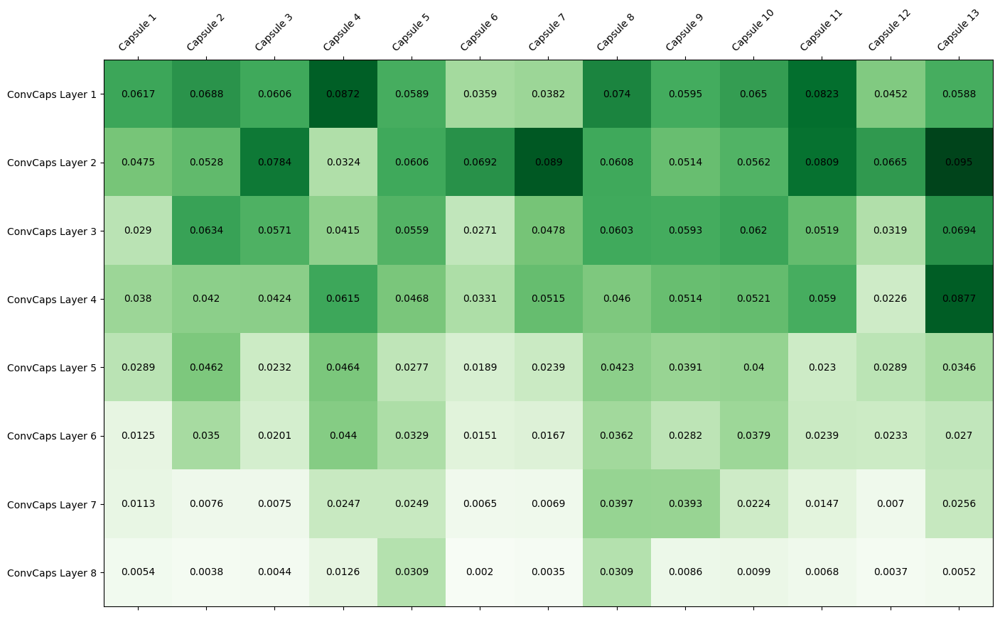

In [ ]:
utils.plot_caps_layers_activations(capsnet_inter8_convcaps_activations,
                                   n_caps=capsnet_inter8_convcaps_activations['intermediate_convcaps_layer_1'].shape[0],
                                   n_caps_layers=n_caps_layers, text_en=1)

#### Plots for losses and accuracies

In [ ]:
multilayer_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Trained_pruned_37pc_multilayer_inter8_capsnet_cifar10_model_Epoch15_of_15.pt')

epoch_loss = multilayer_capsnet_cifar10_model['epoch_loss']
epoch_accuracy = multilayer_capsnet_cifar10_model['epoch_accuracy']

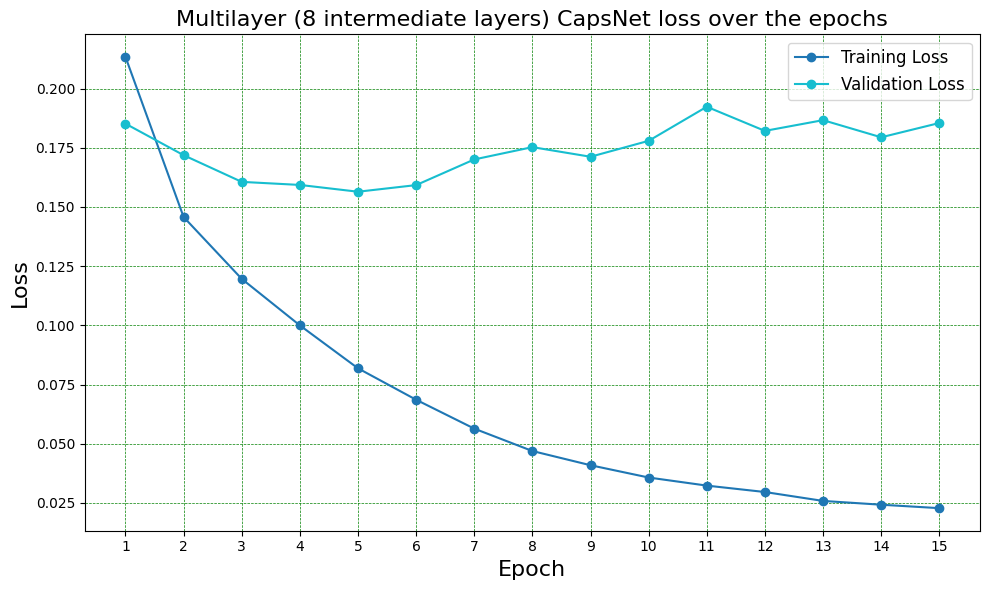

In [ ]:
utils.plot_line_chart(epoch_loss, ['Training Loss', 'Validation Loss'], 'Epoch', 'Loss',
                      'Multilayer (8 intermediate layers) CapsNet loss over the epochs')

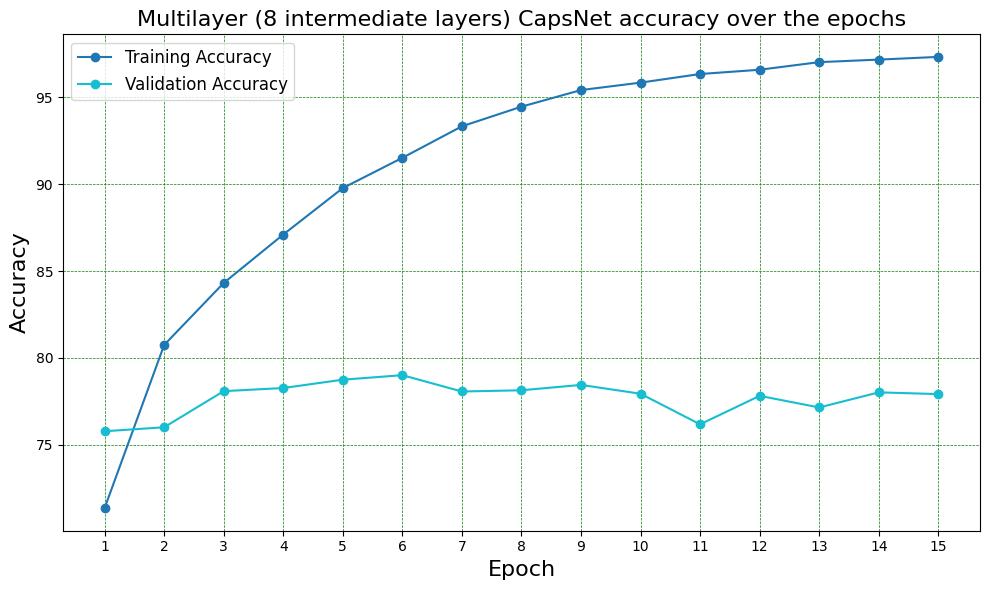

In [ ]:
utils.plot_line_chart(epoch_accuracy, ['Training Accuracy', 'Validation Accuracy'], 'Epoch', 'Accuracy',
                      'Multilayer (8 intermediate layers) CapsNet accuracy over the epochs')

## 9 Intermediate Layered CapsNet

In [ ]:
CIFAR10_TRAIN_DIR = TRAIN_DIR+"cifar10/20Caps8Dim/"
batch_size=32
n_epochs=15
n_class=10

n_caps_layers=9
prim_caps_channels=20
prim_caps_dim=8

model_conv_config = {'in_img_h':32,
                     'in_img_w':32,
                     'in_img_c':3,
                     'kernel_size':[3, 3, 3, 3],
                     'stride':[1, 2, 1, 2],
                     'padding':[1, 1, 1, 0]}

train_loader, test_loader = image_dataloader(dataset='cifar10', batch_size=batch_size)

criterion = caps.CapsNetLoss(n_class=n_class)

100%|██████████| 170498071/170498071 [00:13<00:00, 12801509.52it/s]


Extracting ./data/cifar-10-python.tar.gz to ./data
Files already downloaded and verified


In [ ]:
multilayer_inter9_capsnet_cifar10_model = caps.CapsuleNetwork(in_img_c=3, in_img_h=32, in_img_w=32, n_class=n_class,
                                                               model_conv_config=model_conv_config, prim_caps_channels=prim_caps_channels,
                                                               prim_caps_dim=prim_caps_dim, n_caps_layers=n_caps_layers)

multilayer_inter9_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 40, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(40, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(40, 80, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(80, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(80, 160, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(160, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(160, 160, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
    (intermediate_co

### 12.5% Pruned Base CapsNet with Intermediate Layers

In [ ]:
pruned_model_type = 12

best_pruned_base_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_{}pc_base_capsnet_cifar10_model.pt'.format(pruned_model_type))

pruned_multilayer_inter9_capsnet_cifar10_model = ccmp.create_pruned_model_from_state_dict(
    new_model = multilayer_inter9_capsnet_cifar10_model,
    saved_state_dict = best_pruned_base_capsnet_cifar10_model['model_state_dict'],
    model_conv_config_dict = model_conv_config, n_class = n_class, n_caps_layers = n_caps_layers,
    prim_caps_dim = prim_caps_dim, base_capsnet_stdict = True)

pruned_multilayer_inter9_capsnet_cifar10_model.name = 'pruned_{}pc_multilayer_inter9_capsnet_cifar10_model'.format(pruned_model_type)
pruned_multilayer_inter9_capsnet_cifar10_model = pruned_multilayer_inter9_capsnet_cifar10_model.to(device)
pruned_multilayer_inter9_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 72, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(72, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(72, 144, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(144, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(144, 144, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
    (intermediate_co

In [ ]:
%%time
best_trained_model_path, _, _ = mtt.train_capsnet(n_epochs,
                                                  pruned_multilayer_inter9_capsnet_cifar10_model,
                                                  criterion,
                                                  train_loader,
                                                  test_loader,
                                                  CIFAR10_TRAIN_DIR,
                                                  logger,
                                                  device=device)

02/28 01:49:51 AM | pruned_12pc_multilayer_inter9_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.8100, Top 1 Acc=9.38, Top 5 Acc=50.00
INFO:capsnet:pruned_12pc_multilayer_inter9_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.8100, Top 1 Acc=9.38, Top 5 Acc=50.00
02/28 01:50:04 AM | pruned_12pc_multilayer_inter9_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.8100, Top 1 Acc=7.95, Top 5 Acc=48.77
INFO:capsnet:pruned_12pc_multilayer_inter9_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.8100, Top 1 Acc=7.95, Top 5 Acc=48.77
02/28 01:50:18 AM | pruned_12pc_multilayer_inter9_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.8100, Top 1 Acc=8.41, Top 5 Acc=50.38
INFO:capsnet:pruned_12pc_multilayer_inter9_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.8100, Top 1 Acc=8.41, Top 5 Acc=50.38
02/28 01:50:32 AM | pruned_12pc_multilayer_inter9_capsnet_cifar10_model Tra

KeyboardInterrupt: 

### 25% Pruned Base CapsNet with Intermediate Layers

In [ ]:
pruned_model_type = 25

best_pruned_base_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_{}pc_base_capsnet_cifar10_model.pt'.format(pruned_model_type))

pruned_multilayer_inter9_capsnet_cifar10_model = ccmp.create_pruned_model_from_state_dict(
    new_model = multilayer_inter9_capsnet_cifar10_model,
    saved_state_dict = best_pruned_base_capsnet_cifar10_model['model_state_dict'],
    model_conv_config_dict = model_conv_config, n_class = n_class, n_caps_layers = n_caps_layers,
    prim_caps_dim = prim_caps_dim, base_capsnet_stdict = True)

pruned_multilayer_inter9_capsnet_cifar10_model.name = 'pruned_{}pc_multilayer_inter9_capsnet_cifar10_model'.format(pruned_model_type)
pruned_multilayer_inter9_capsnet_cifar10_model = pruned_multilayer_inter9_capsnet_cifar10_model.to(device)
pruned_multilayer_inter9_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(64, 120, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(120, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(120, 120, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
    (intermediate_co

In [ ]:
%%time
best_trained_model_path, _, _ = mtt.train_capsnet(n_epochs,
                                                  pruned_multilayer_inter9_capsnet_cifar10_model,
                                                  criterion,
                                                  train_loader,
                                                  test_loader,
                                                  CIFAR10_TRAIN_DIR,
                                                  logger,
                                                  device=device)

02/28 02:02:24 AM | pruned_25pc_multilayer_inter9_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.8100, Top 1 Acc=15.62, Top 5 Acc=62.50
INFO:capsnet:pruned_25pc_multilayer_inter9_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.8100, Top 1 Acc=15.62, Top 5 Acc=62.50
02/28 02:02:36 AM | pruned_25pc_multilayer_inter9_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.5427, Top 1 Acc=19.03, Top 5 Acc=68.84
INFO:capsnet:pruned_25pc_multilayer_inter9_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.5427, Top 1 Acc=19.03, Top 5 Acc=68.84
02/28 02:02:48 AM | pruned_25pc_multilayer_inter9_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.4795, Top 1 Acc=27.02, Top 5 Acc=78.17
INFO:capsnet:pruned_25pc_multilayer_inter9_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.4795, Top 1 Acc=27.02, Top 5 Acc=78.17
02/28 02:03:00 AM | pruned_25pc_multilayer_inter9_capsnet_cifar10_mod

CPU times: user 2h 21min 38s, sys: 10min 11s, total: 2h 31min 50s
Wall time: 2h 31min 28s


#### Export ConvCaps Activation

In [ ]:
pruned_trained_multilayer_inter9_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_25pc_multilayer_inter9_capsnet_cifar10_model.pt')

pruned_multilayer_inter9_capsnet_cifar10_model.load_state_dict(pruned_trained_multilayer_inter9_capsnet_cifar10_model['model_state_dict'])

pruned_multilayer_inter9_capsnet_cifar10_model.name = 'best_pruned_25pc_multilayer_inter9_capsnet_cifar10_model'
pruned_multilayer_inter9_capsnet_cifar10_model = pruned_multilayer_inter9_capsnet_cifar10_model.to(device)
pruned_multilayer_inter9_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(64, 120, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(120, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(120, 120, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
    (intermediate_co

In [ ]:
capsnet_inter9_convcaps_activations = utils.extract_convcaps_activations(pruned_multilayer_inter9_capsnet_cifar10_model,
                                                                         test_loader, logger, CIFAR10_TRAIN_DIR, device)

02/28 04:33:53 AM | best_pruned_25pc_multilayer_inter9_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=87.500, Top 5 Acc=100.000
INFO:capsnet:best_pruned_25pc_multilayer_inter9_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=87.500, Top 5 Acc=100.000
02/28 04:33:53 AM | best_pruned_25pc_multilayer_inter9_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=79.688, Top 5 Acc=98.438
INFO:capsnet:best_pruned_25pc_multilayer_inter9_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=79.688, Top 5 Acc=98.438
02/28 04:33:53 AM | best_pruned_25pc_multilayer_inter9_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=80.208, Top 5 Acc=97.917
INFO:capsnet:best_pruned_25pc_multilayer_inter9_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=80.208, Top 5 Acc=97.917
02/28 04:33:53 AM | best_pruned_25pc_multilayer_inter9_capsnet_cifar10_model - Iterations=4/313, Batch Size=32, Top 1 Acc=80.469, Top 5 A

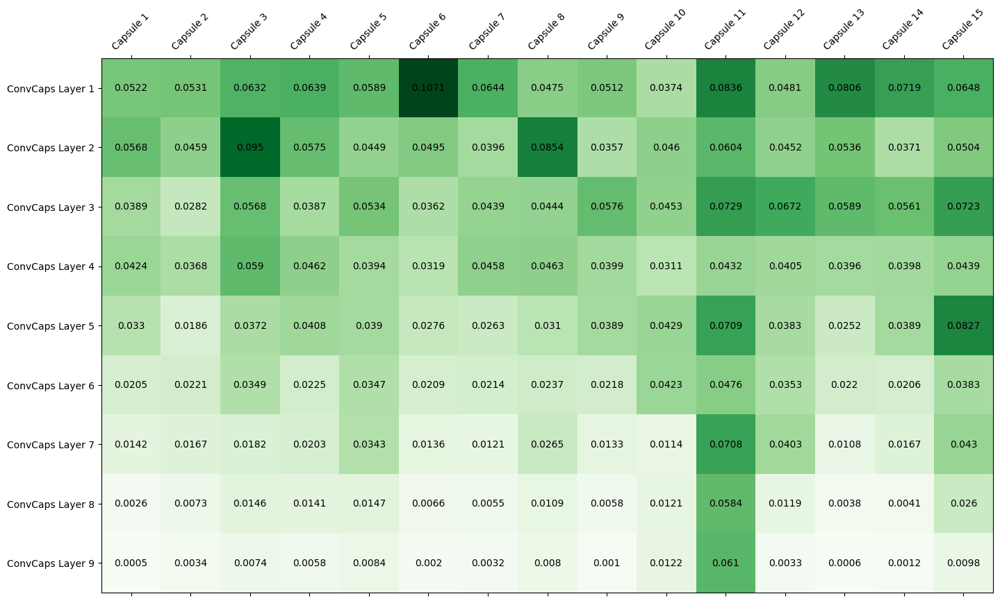

In [ ]:
utils.plot_caps_layers_activations(capsnet_inter9_convcaps_activations,
                                   n_caps=capsnet_inter9_convcaps_activations['intermediate_convcaps_layer_1'].shape[0],
                                   n_caps_layers=n_caps_layers, text_en=1)

#### Plots for losses and accuracies

In [ ]:
multilayer_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Trained_pruned_25pc_multilayer_inter9_capsnet_cifar10_model_Epoch15_of_15.pt')

epoch_loss = multilayer_capsnet_cifar10_model['epoch_loss']
epoch_accuracy = multilayer_capsnet_cifar10_model['epoch_accuracy']

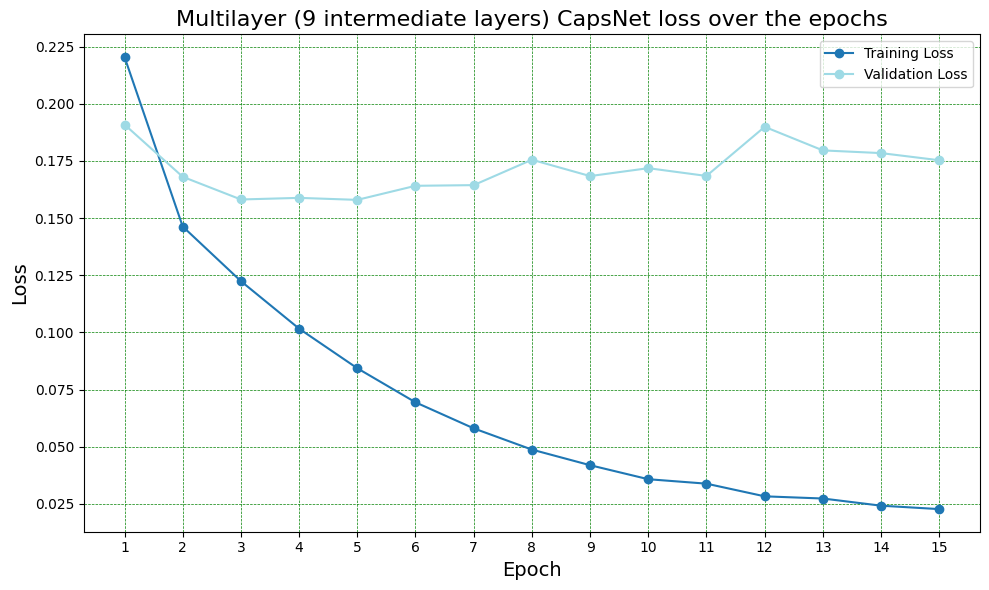

In [ ]:
utils.plot_line_chart(epoch_loss, ['Training Loss', 'Validation Loss'], 'Epoch', 'Loss',
                      'Multilayer (9 intermediate layers) CapsNet loss over the epochs')

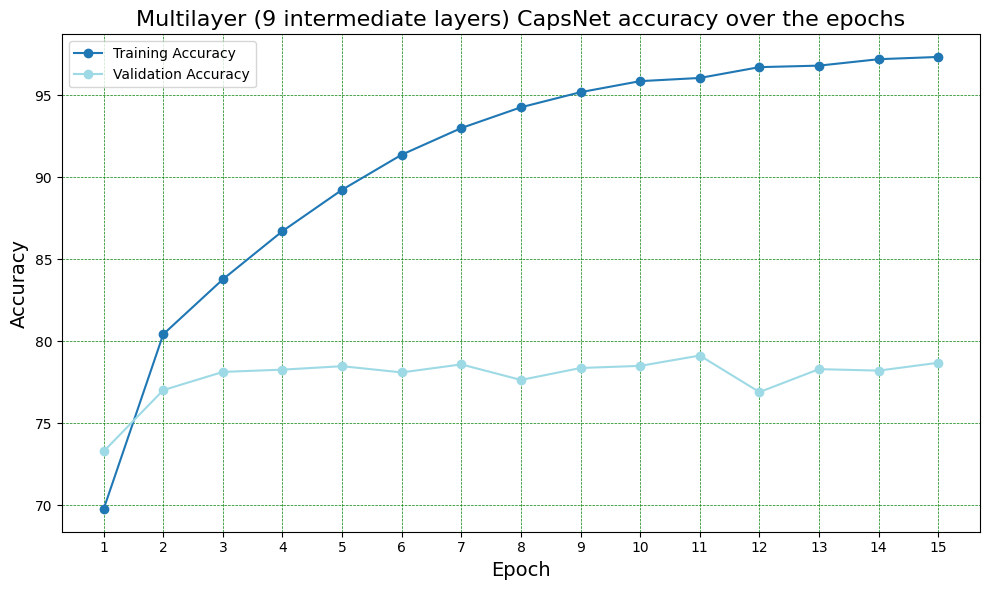

In [ ]:
utils.plot_line_chart(epoch_accuracy, ['Training Accuracy', 'Validation Accuracy'], 'Epoch', 'Accuracy',
                      'Multilayer (9 intermediate layers) CapsNet accuracy over the epochs')

### 37.5% Pruned Base CapsNet with Intermediate Layers

In [ ]:
pruned_model_type = 37

best_pruned_base_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_{}pc_base_capsnet_cifar10_model.pt'.format(pruned_model_type))

pruned_multilayer_inter9_capsnet_cifar10_model = ccmp.create_pruned_model_from_state_dict(
    new_model = multilayer_inter9_capsnet_cifar10_model,
    saved_state_dict = best_pruned_base_capsnet_cifar10_model['model_state_dict'],
    model_conv_config_dict = model_conv_config, n_class = n_class, n_caps_layers = n_caps_layers,
    prim_caps_dim = prim_caps_dim, base_capsnet_stdict = True)

pruned_multilayer_inter9_capsnet_cifar10_model.name = 'pruned_{}pc_multilayer_inter9_capsnet_cifar10_model'.format(pruned_model_type)
pruned_multilayer_inter9_capsnet_cifar10_model = pruned_multilayer_inter9_capsnet_cifar10_model.to(device)
pruned_multilayer_inter9_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 56, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(56, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(56, 104, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(104, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(104, 104, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
    (intermediate_co

In [ ]:
%%time
best_trained_model_path, _, _ = mtt.train_capsnet(n_epochs,
                                                  pruned_multilayer_inter9_capsnet_cifar10_model,
                                                  criterion,
                                                  train_loader,
                                                  test_loader,
                                                  CIFAR10_TRAIN_DIR,
                                                  logger,
                                                  device=device)

02/28 04:48:33 AM | pruned_37pc_multilayer_inter9_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.8093, Top 1 Acc=6.25, Top 5 Acc=56.25
INFO:capsnet:pruned_37pc_multilayer_inter9_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.8093, Top 1 Acc=6.25, Top 5 Acc=56.25
02/28 04:48:45 AM | pruned_37pc_multilayer_inter9_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.5359, Top 1 Acc=21.78, Top 5 Acc=69.51
INFO:capsnet:pruned_37pc_multilayer_inter9_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.5359, Top 1 Acc=21.78, Top 5 Acc=69.51
02/28 04:48:56 AM | pruned_37pc_multilayer_inter9_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.4619, Top 1 Acc=33.03, Top 5 Acc=78.89
INFO:capsnet:pruned_37pc_multilayer_inter9_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.4619, Top 1 Acc=33.03, Top 5 Acc=78.89
02/28 04:49:07 AM | pruned_37pc_multilayer_inter9_capsnet_cifar10_model

CPU times: user 2h 11min 25s, sys: 10min 6s, total: 2h 21min 31s
Wall time: 2h 21min 13s


#### Export ConvCaps Activation

For 37.5% Pruned Base CapsNet

In [ ]:
pruned_trained_multilayer_inter9_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_37pc_multilayer_inter9_capsnet_cifar10_model.pt')

pruned_multilayer_inter9_capsnet_cifar10_model.load_state_dict(pruned_trained_multilayer_inter9_capsnet_cifar10_model['model_state_dict'])

pruned_multilayer_inter9_capsnet_cifar10_model.name = 'best_pruned_37pc_multilayer_inter9_capsnet_cifar10_model'
pruned_multilayer_inter9_capsnet_cifar10_model = pruned_multilayer_inter9_capsnet_cifar10_model.to(device)
pruned_multilayer_inter9_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 56, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(56, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(56, 104, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(104, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(104, 104, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
    (intermediate_co

In [ ]:
capsnet_inter9_convcaps_activations = utils.extract_convcaps_activations(pruned_multilayer_inter9_capsnet_cifar10_model,
                                                                         test_loader, logger, CIFAR10_TRAIN_DIR, device)

02/28 01:38:11 PM | best_pruned_37pc_multilayer_inter9_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=90.625, Top 5 Acc=96.875
INFO:capsnet:best_pruned_37pc_multilayer_inter9_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=90.625, Top 5 Acc=96.875
02/28 01:38:12 PM | best_pruned_37pc_multilayer_inter9_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=78.125, Top 5 Acc=93.750
INFO:capsnet:best_pruned_37pc_multilayer_inter9_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=78.125, Top 5 Acc=93.750
02/28 01:38:12 PM | best_pruned_37pc_multilayer_inter9_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=80.208, Top 5 Acc=94.792
INFO:capsnet:best_pruned_37pc_multilayer_inter9_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=80.208, Top 5 Acc=94.792
02/28 01:38:12 PM | best_pruned_37pc_multilayer_inter9_capsnet_cifar10_model - Iterations=4/313, Batch Size=32, Top 1 Acc=83.594, Top 5 Acc

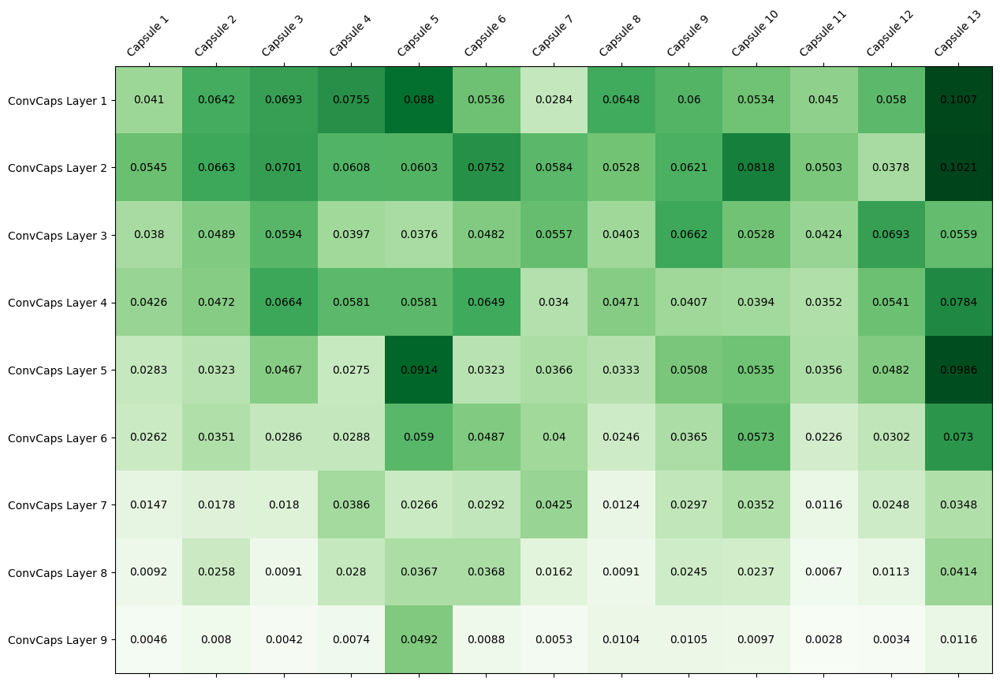

In [ ]:
utils.plot_caps_layers_activations(capsnet_inter9_convcaps_activations,
                                   n_caps=capsnet_inter9_convcaps_activations['intermediate_convcaps_layer_1'].shape[0],
                                   n_caps_layers=n_caps_layers, text_en=1)

#### Plots for losses and accuracies

In [ ]:
multilayer_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Trained_pruned_37pc_multilayer_inter9_capsnet_cifar10_model_Epoch15_of_15.pt')

epoch_loss = multilayer_capsnet_cifar10_model['epoch_loss']
epoch_accuracy = multilayer_capsnet_cifar10_model['epoch_accuracy']

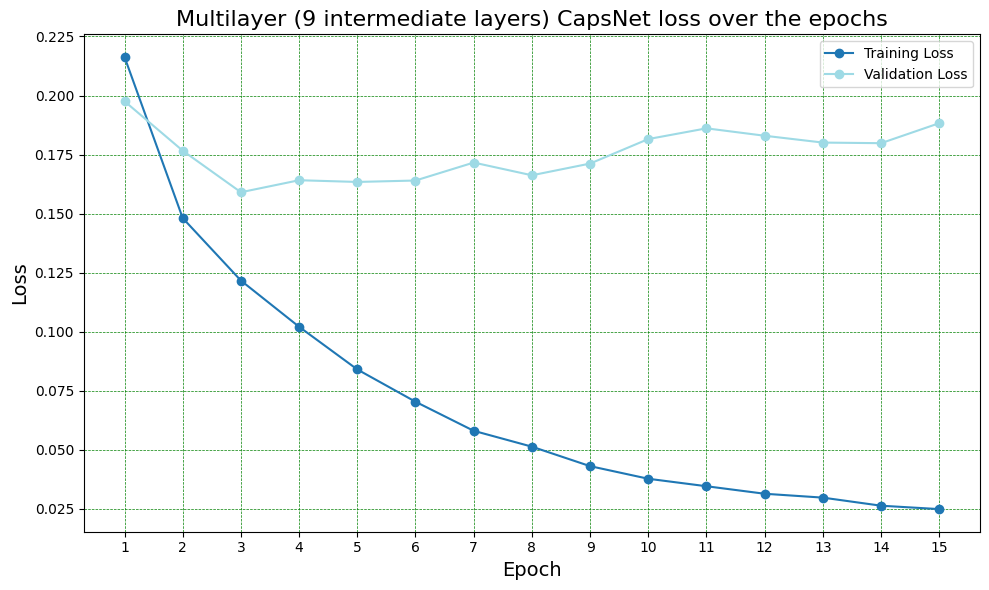

In [ ]:
utils.plot_line_chart(epoch_loss, ['Training Loss', 'Validation Loss'], 'Epoch', 'Loss',
                      'Multilayer (9 intermediate layers) CapsNet loss over the epochs')

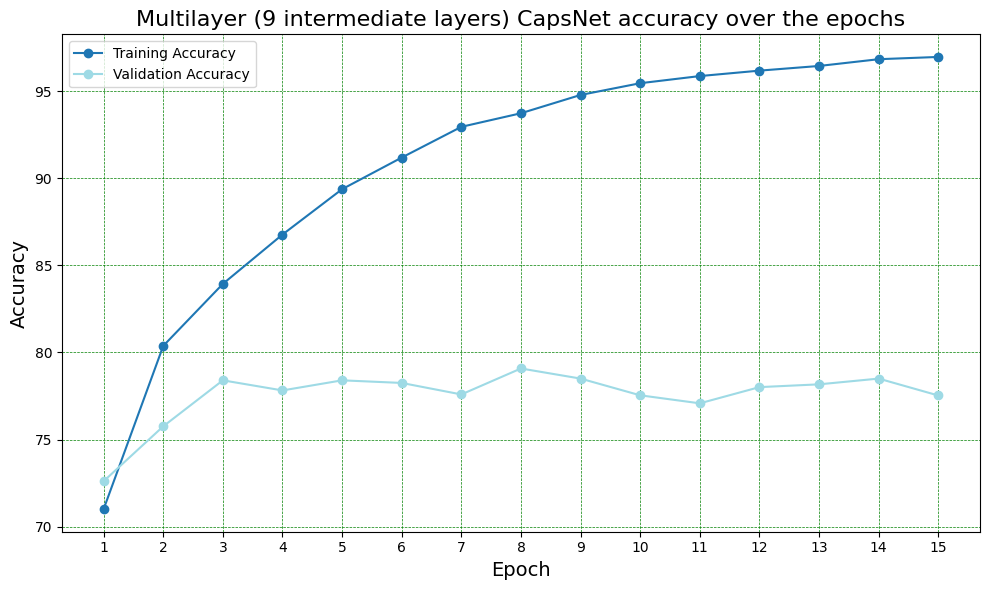

In [ ]:
utils.plot_line_chart(epoch_accuracy, ['Training Accuracy', 'Validation Accuracy'], 'Epoch', 'Accuracy',
                      'Multilayer (9 intermediate layers) CapsNet accuracy over the epochs')

In [ ]:
# time.sleep(5)

# from google.colab import runtime
# runtime.unassign()

## 10 Intermediate Layered CapsNet

In [ ]:
CIFAR10_TRAIN_DIR = TRAIN_DIR+"cifar10/20Caps8Dim/"
batch_size=32
n_epochs=15
n_class=10

n_caps_layers=10
prim_caps_channels=20
prim_caps_dim=8

model_conv_config = {'in_img_h':32,
                     'in_img_w':32,
                     'in_img_c':3,
                     'kernel_size': [3, 3, 3, 3],
                     'stride': [1, 2, 1, 2],
                     'padding': [1, 1, 1, 0]}

train_loader, test_loader = image_dataloader(dataset='cifar10', batch_size=batch_size)

criterion = caps.CapsNetLoss(n_class=n_class)

Files already downloaded and verified
Files already downloaded and verified


In [ ]:
multilayer_inter10_capsnet_cifar10_model = caps.CapsuleNetwork(in_img_c=3, in_img_h=32, in_img_w=32, n_class=n_class,
                                                               model_conv_config=model_conv_config,
                                                               prim_caps_channels=prim_caps_channels,
                                                               prim_caps_dim=prim_caps_dim, n_caps_layers=n_caps_layers)

multilayer_inter10_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 40, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(40, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(40, 80, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(80, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(80, 160, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(160, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(160, 160, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
    (intermediate_co

### 25% Pruned Base CapsNet with Intermediate Layers

In [ ]:
pruned_model_type = 25

best_pruned_base_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_{}pc_base_capsnet_cifar10_model.pt'.format(pruned_model_type))

pruned_multilayer_inter10_capsnet_cifar10_model = ccmp.create_pruned_model_from_state_dict(
    new_model = multilayer_inter10_capsnet_cifar10_model,
    saved_state_dict = best_pruned_base_capsnet_cifar10_model['model_state_dict'],
    model_conv_config_dict = model_conv_config, n_class = n_class, n_caps_layers = n_caps_layers,
    prim_caps_dim = prim_caps_dim, base_capsnet_stdict = True)

pruned_multilayer_inter10_capsnet_cifar10_model.name = 'pruned_{}pc_multilayer_inter10_capsnet_cifar10_model'.format(pruned_model_type)
pruned_multilayer_inter10_capsnet_cifar10_model = pruned_multilayer_inter10_capsnet_cifar10_model.to(device)
pruned_multilayer_inter10_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(64, 120, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(120, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(120, 120, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
    (intermediate_co

In [ ]:
%%time
best_trained_model_path, _, _ = mtt.train_capsnet(n_epochs,
                                                  pruned_multilayer_inter10_capsnet_cifar10_model,
                                                  criterion,
                                                  train_loader,
                                                  test_loader,
                                                  CIFAR10_TRAIN_DIR,
                                                  logger,
                                                  device=device)

02/27 04:09:22 AM | pruned_25pc_multilayer_inter10_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.8100, Top 1 Acc=3.12, Top 5 Acc=34.38
INFO:capsnet:pruned_25pc_multilayer_inter10_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.8100, Top 1 Acc=3.12, Top 5 Acc=34.38
02/27 04:09:35 AM | pruned_25pc_multilayer_inter10_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.8100, Top 1 Acc=10.98, Top 5 Acc=51.42
INFO:capsnet:pruned_25pc_multilayer_inter10_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.8100, Top 1 Acc=10.98, Top 5 Acc=51.42
02/27 04:09:48 AM | pruned_25pc_multilayer_inter10_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.8100, Top 1 Acc=10.00, Top 5 Acc=50.43
INFO:capsnet:pruned_25pc_multilayer_inter10_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.8100, Top 1 Acc=10.00, Top 5 Acc=50.43
02/27 04:10:02 AM | pruned_25pc_multilayer_inter10_capsnet_cifar1

KeyboardInterrupt: 

In [ ]:
# time.sleep(10)

# from google.colab import runtime
# runtime.unassign()

### 37.5% Pruned Base CapsNet with Intermediate Layers

In [ ]:
pruned_model_type = 37

best_pruned_base_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_{}pc_base_capsnet_cifar10_model.pt'.format(pruned_model_type))

pruned_multilayer_inter10_capsnet_cifar10_model = ccmp.create_pruned_model_from_state_dict(
    new_model = multilayer_inter10_capsnet_cifar10_model,
    saved_state_dict = best_pruned_base_capsnet_cifar10_model['model_state_dict'],
    model_conv_config_dict = model_conv_config, n_class = n_class, n_caps_layers = n_caps_layers,
    prim_caps_dim = prim_caps_dim, base_capsnet_stdict = True)

pruned_multilayer_inter10_capsnet_cifar10_model.name = 'pruned_{}pc_multilayer_inter10_capsnet_cifar10_model'.format(pruned_model_type)
pruned_multilayer_inter10_capsnet_cifar10_model = pruned_multilayer_inter10_capsnet_cifar10_model.to(device)
pruned_multilayer_inter10_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 56, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(56, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(56, 104, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(104, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(104, 104, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
    (intermediate_co

In [ ]:
%%time
best_trained_model_path, _, _ = mtt.train_capsnet(n_epochs,
                                                  pruned_multilayer_inter10_capsnet_cifar10_model,
                                                  criterion,
                                                  train_loader,
                                                  test_loader,
                                                  CIFAR10_TRAIN_DIR,
                                                  logger,
                                                  device=device)

02/27 01:37:32 AM | pruned_37pc_multilayer_inter10_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.8097, Top 1 Acc=0.00, Top 5 Acc=56.25
INFO:capsnet:pruned_37pc_multilayer_inter10_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.8097, Top 1 Acc=0.00, Top 5 Acc=56.25
02/27 01:37:44 AM | pruned_37pc_multilayer_inter10_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.5379, Top 1 Acc=18.84, Top 5 Acc=71.88
INFO:capsnet:pruned_37pc_multilayer_inter10_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.5379, Top 1 Acc=18.84, Top 5 Acc=71.88
02/27 01:37:56 AM | pruned_37pc_multilayer_inter10_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.4776, Top 1 Acc=26.83, Top 5 Acc=79.95
INFO:capsnet:pruned_37pc_multilayer_inter10_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.4776, Top 1 Acc=26.83, Top 5 Acc=79.95
02/27 01:38:08 AM | pruned_37pc_multilayer_inter10_capsnet_cifar1

CPU times: user 2h 21min 5s, sys: 11min 7s, total: 2h 32min 12s
Wall time: 2h 31min 49s


#### Export ConvCaps Activation

In [ ]:
pruned_trained_multilayer_inter10_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_37pc_multilayer_inter10_capsnet_cifar10_model.pt')

pruned_multilayer_inter10_capsnet_cifar10_model.load_state_dict(pruned_trained_multilayer_inter10_capsnet_cifar10_model['model_state_dict'])

pruned_multilayer_inter10_capsnet_cifar10_model.name = 'best_pruned_37pc_multilayer_inter10_capsnet_cifar10_model'
pruned_multilayer_inter10_capsnet_cifar10_model = pruned_multilayer_inter10_capsnet_cifar10_model.to(device)
pruned_multilayer_inter10_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(32, 56, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(56, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(56, 104, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(104, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(104, 104, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
    (intermediate_co

In [ ]:
capsnet_inter10_convcaps_activations = utils.extract_convcaps_activations(pruned_multilayer_inter10_capsnet_cifar10_model,
                                                                          test_loader, logger, CIFAR10_TRAIN_DIR, device)

02/28 01:41:11 AM | best_pruned_37pc_multilayer_inter10_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=84.375, Top 5 Acc=100.000
INFO:capsnet:best_pruned_37pc_multilayer_inter10_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=84.375, Top 5 Acc=100.000
02/28 01:41:11 AM | best_pruned_37pc_multilayer_inter10_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=78.125, Top 5 Acc=96.875
INFO:capsnet:best_pruned_37pc_multilayer_inter10_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=78.125, Top 5 Acc=96.875
02/28 01:41:11 AM | best_pruned_37pc_multilayer_inter10_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=82.292, Top 5 Acc=97.917
INFO:capsnet:best_pruned_37pc_multilayer_inter10_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=82.292, Top 5 Acc=97.917
02/28 01:41:11 AM | best_pruned_37pc_multilayer_inter10_capsnet_cifar10_model - Iterations=4/313, Batch Size=32, Top 1 Acc=82.812, 

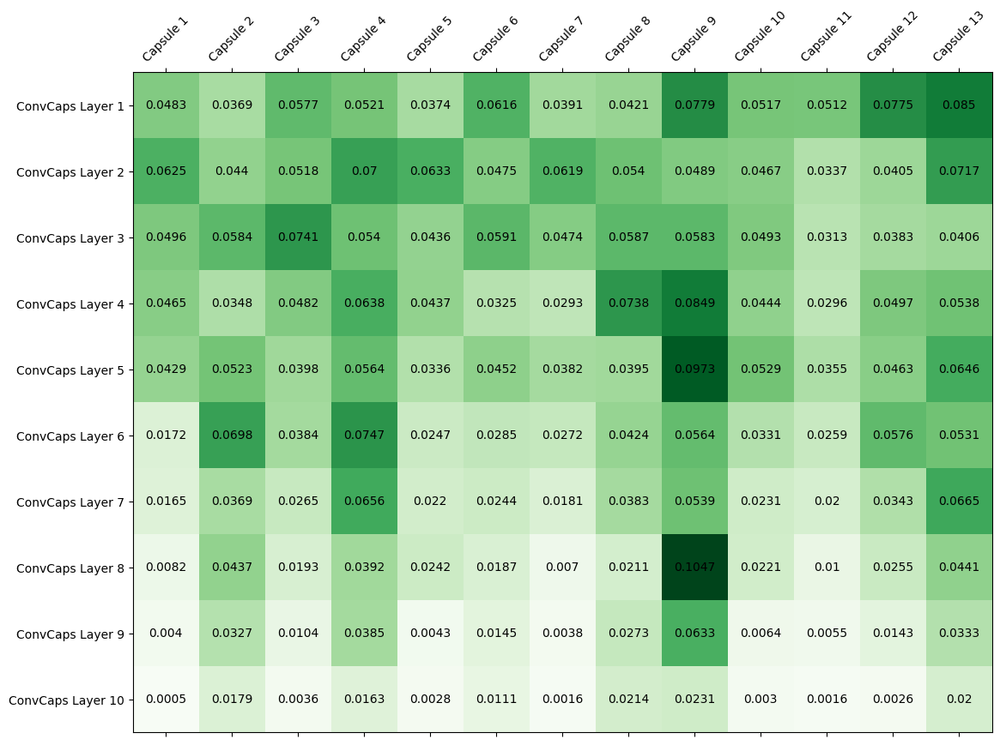

In [ ]:
utils.plot_caps_layers_activations(capsnet_inter10_convcaps_activations,
                                   n_caps=capsnet_inter10_convcaps_activations['intermediate_convcaps_layer_1'].shape[0],
                                   n_caps_layers=n_caps_layers, text_en=1)

#### Plots for losses and accuracies

In [ ]:
multilayer_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Trained_pruned_37pc_multilayer_inter10_capsnet_cifar10_model_Epoch15_of_15.pt')

epoch_loss = multilayer_capsnet_cifar10_model['epoch_loss']
epoch_accuracy = multilayer_capsnet_cifar10_model['epoch_accuracy']

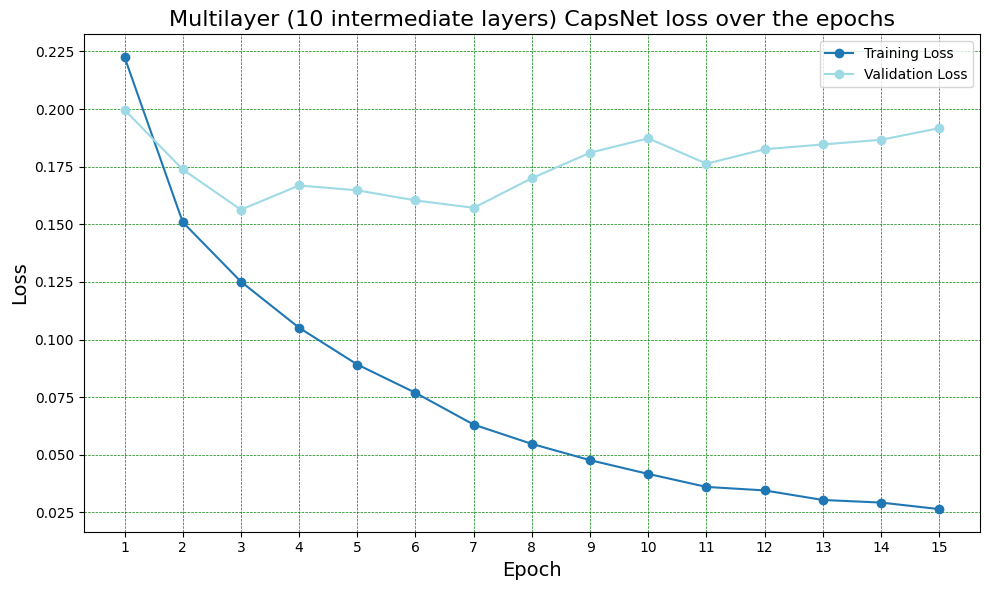

In [ ]:
utils.plot_line_chart(epoch_loss, ['Training Loss', 'Validation Loss'], 'Epoch', 'Loss',
                      'Multilayer (10 intermediate layers) CapsNet loss over the epochs')

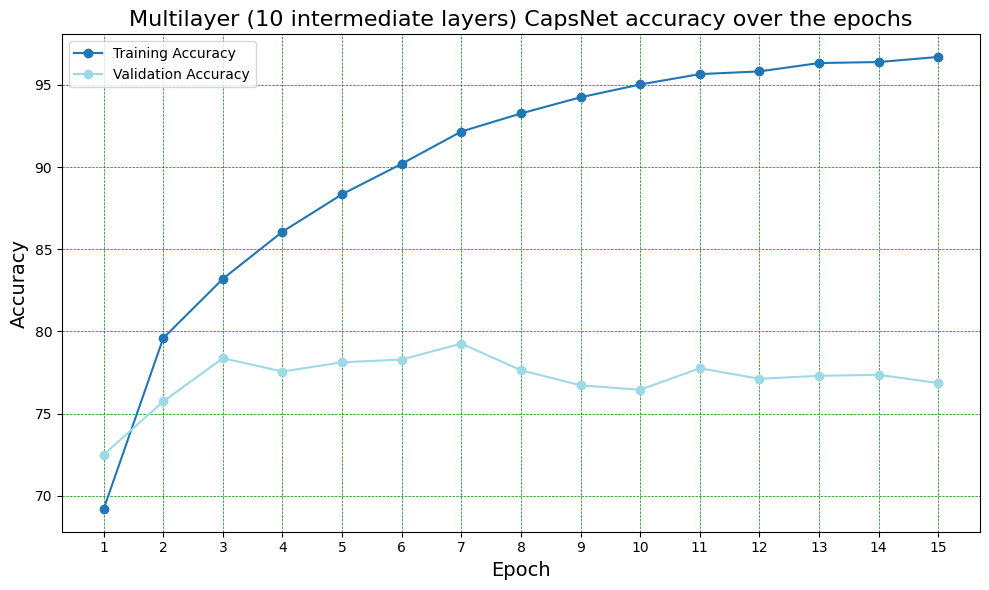

In [ ]:
utils.plot_line_chart(epoch_accuracy, ['Training Accuracy', 'Validation Accuracy'], 'Epoch', 'Accuracy',
                      'Multilayer (10 intermediate layers) CapsNet accuracy over the epochs')

In [ ]:
# from google.colab import runtime
# runtime.unassign()

### 50% Pruned Base CapsNet with Intermediate Layers

In [ ]:
pruned_model_type = 50

best_pruned_base_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_{}pc_base_capsnet_cifar10_model.pt'.format(pruned_model_type))

pruned_multilayer_inter10_capsnet_cifar10_model = ccmp.create_pruned_model_from_state_dict(
    new_model = multilayer_inter10_capsnet_cifar10_model,
    saved_state_dict = best_pruned_base_capsnet_cifar10_model['model_state_dict'],
    model_conv_config_dict = model_conv_config, n_class = n_class, n_caps_layers = n_caps_layers,
    prim_caps_dim = prim_caps_dim, base_capsnet_stdict = True)

pruned_multilayer_inter10_capsnet_cifar10_model.name = 'pruned_{}pc_multilayer_inter10_capsnet_cifar10_model'.format(pruned_model_type)
pruned_multilayer_inter10_capsnet_cifar10_model = pruned_multilayer_inter10_capsnet_cifar10_model.to(device)
pruned_multilayer_inter10_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 24, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(24, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(24, 40, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(40, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(40, 80, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(80, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(80, 80, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
    (intermediate_convca

In [ ]:
%%time
best_trained_model_path, _, _ = mtt.train_capsnet(n_epochs,
                                                  pruned_multilayer_inter10_capsnet_cifar10_model,
                                                  criterion,
                                                  train_loader,
                                                  test_loader,
                                                  CIFAR10_TRAIN_DIR,
                                                  logger,
                                                  device=device)

03/01 10:35:57 PM | pruned_50pc_multilayer_inter10_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.8088, Top 1 Acc=9.38, Top 5 Acc=56.25
INFO:capsnet:pruned_50pc_multilayer_inter10_capsnet_cifar10_model Training - Epoch=1, Iteration=(0/1563), Loss=0.8088, Top 1 Acc=9.38, Top 5 Acc=56.25
03/01 10:36:08 PM | pruned_50pc_multilayer_inter10_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.5444, Top 1 Acc=20.27, Top 5 Acc=72.06
INFO:capsnet:pruned_50pc_multilayer_inter10_capsnet_cifar10_model Training - Epoch=1, Iteration=(32/1563), Loss=0.5444, Top 1 Acc=20.27, Top 5 Acc=72.06
03/01 10:36:20 PM | pruned_50pc_multilayer_inter10_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.4581, Top 1 Acc=32.31, Top 5 Acc=81.97
INFO:capsnet:pruned_50pc_multilayer_inter10_capsnet_cifar10_model Training - Epoch=1, Iteration=(64/1563), Loss=0.4581, Top 1 Acc=32.31, Top 5 Acc=81.97
03/01 10:36:31 PM | pruned_50pc_multilayer_inter10_capsnet_cifar1

CPU times: user 2h 10min 26s, sys: 11min 1s, total: 2h 21min 28s
Wall time: 2h 21min 9s


#### Export ConvCaps Activation

In [ ]:
pruned_trained_multilayer_inter10_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Best_pruned_50pc_multilayer_inter10_capsnet_cifar10_model.pt')

pruned_multilayer_inter10_capsnet_cifar10_model.load_state_dict(pruned_trained_multilayer_inter10_capsnet_cifar10_model['model_state_dict'])

pruned_multilayer_inter10_capsnet_cifar10_model.name = 'best_pruned_50pc_multilayer_inter10_capsnet_cifar10_model'
pruned_multilayer_inter10_capsnet_cifar10_model = pruned_multilayer_inter10_capsnet_cifar10_model.to(device)
pruned_multilayer_inter10_capsnet_cifar10_model.eval()

CapsuleNetwork(
  (conv_layer_1): ConvLayer(
    (conv_layer): Conv2d(3, 24, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(24, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_2): ConvLayer(
    (conv_layer): Conv2d(24, 40, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(40, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (conv_layer_3): ConvLayer(
    (conv_layer): Conv2d(40, 80, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
    (bn): BatchNorm2d(80, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (primary_caps): PrimaryCapsLayer(
    (primary_caps): Conv2d(80, 80, kernel_size=(3, 3), stride=(2, 2))
  )
  (intermediate_caps): Sequential(
    (intermediate_convcaps_layer_1): ConvCapsLayer()
    (intermediate_convcaps_layer_2): ConvCapsLayer()
    (intermediate_convcaps_layer_3): ConvCapsLayer()
    (intermediate_convca

In [ ]:
capsnet_inter10_convcaps_activations = utils.extract_convcaps_activations(pruned_multilayer_inter10_capsnet_cifar10_model,
                                                                          test_loader, logger, CIFAR10_TRAIN_DIR, device)

03/02 12:57:06 AM | best_pruned_50pc_multilayer_inter10_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=84.375, Top 5 Acc=96.875
INFO:capsnet:best_pruned_50pc_multilayer_inter10_capsnet_cifar10_model - Iterations=1/313, Batch Size=32, Top 1 Acc=84.375, Top 5 Acc=96.875
03/02 12:57:06 AM | best_pruned_50pc_multilayer_inter10_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=76.562, Top 5 Acc=95.312
INFO:capsnet:best_pruned_50pc_multilayer_inter10_capsnet_cifar10_model - Iterations=2/313, Batch Size=32, Top 1 Acc=76.562, Top 5 Acc=95.312
03/02 12:57:06 AM | best_pruned_50pc_multilayer_inter10_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=77.083, Top 5 Acc=95.833
INFO:capsnet:best_pruned_50pc_multilayer_inter10_capsnet_cifar10_model - Iterations=3/313, Batch Size=32, Top 1 Acc=77.083, Top 5 Acc=95.833
03/02 12:57:06 AM | best_pruned_50pc_multilayer_inter10_capsnet_cifar10_model - Iterations=4/313, Batch Size=32, Top 1 Acc=78.125, To

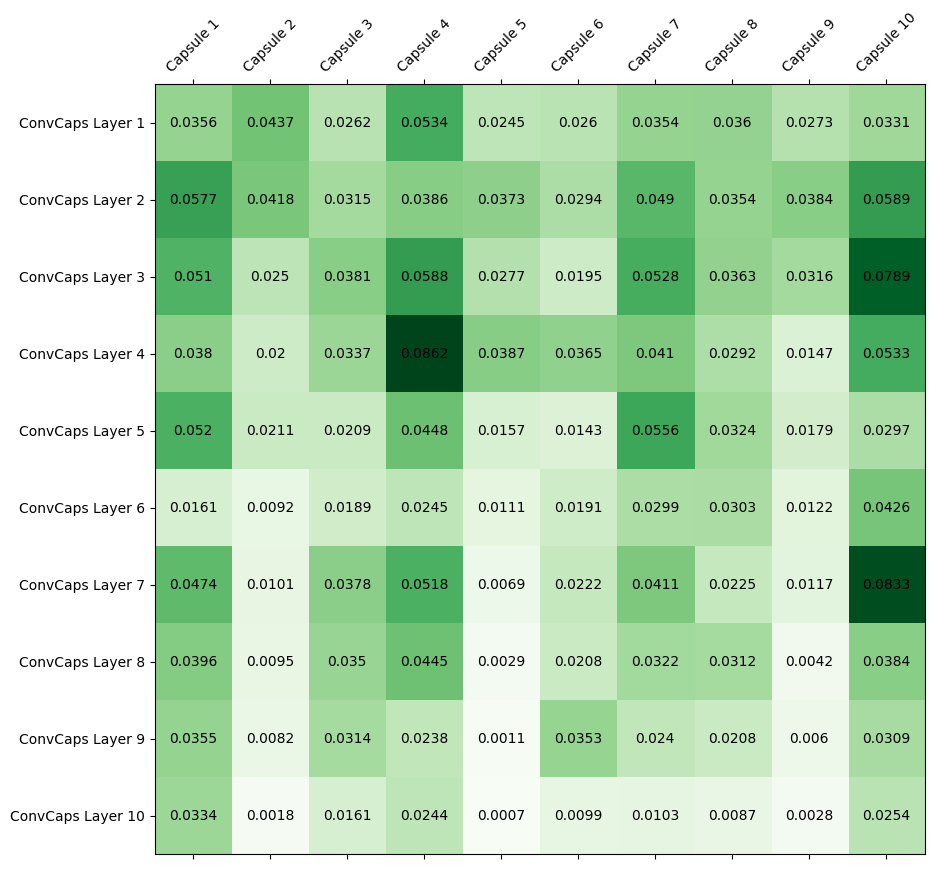

In [ ]:
utils.plot_caps_layers_activations(capsnet_inter10_convcaps_activations,
                                   n_caps=capsnet_inter10_convcaps_activations['intermediate_convcaps_layer_1'].shape[0],
                                   n_caps_layers=n_caps_layers, text_en=1)

#### Plots for losses and accuracies

In [ ]:
multilayer_capsnet_cifar10_model = torch.load(CIFAR10_TRAIN_DIR+'Trained_pruned_50pc_multilayer_inter10_capsnet_cifar10_model_Epoch15_of_15.pt')

epoch_loss = multilayer_capsnet_cifar10_model['epoch_loss']
epoch_accuracy = multilayer_capsnet_cifar10_model['epoch_accuracy']

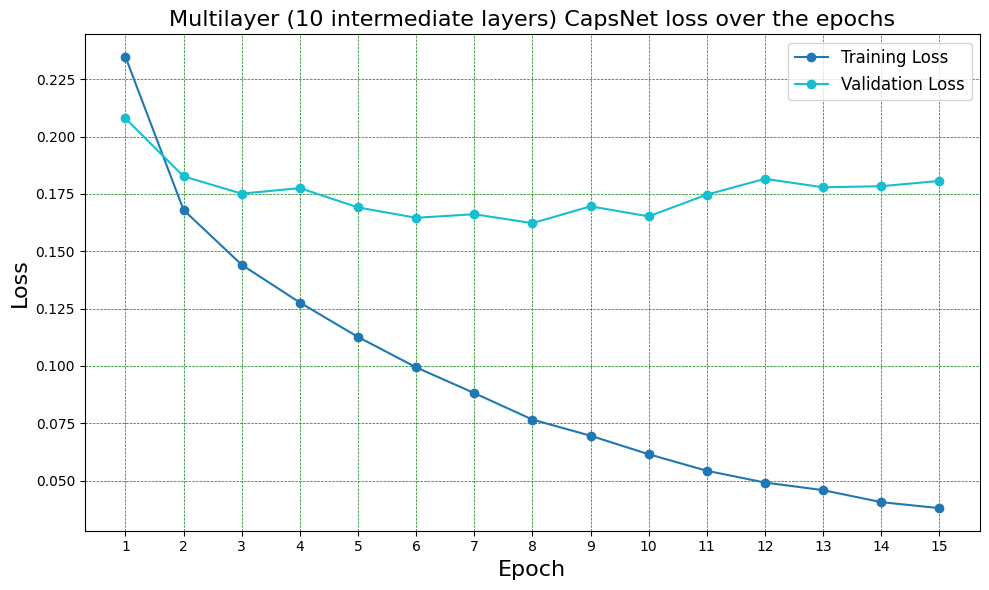

In [ ]:
utils.plot_line_chart(epoch_loss, ['Training Loss', 'Validation Loss'], 'Epoch', 'Loss',
                      'Multilayer (10 intermediate layers) CapsNet loss over the epochs')

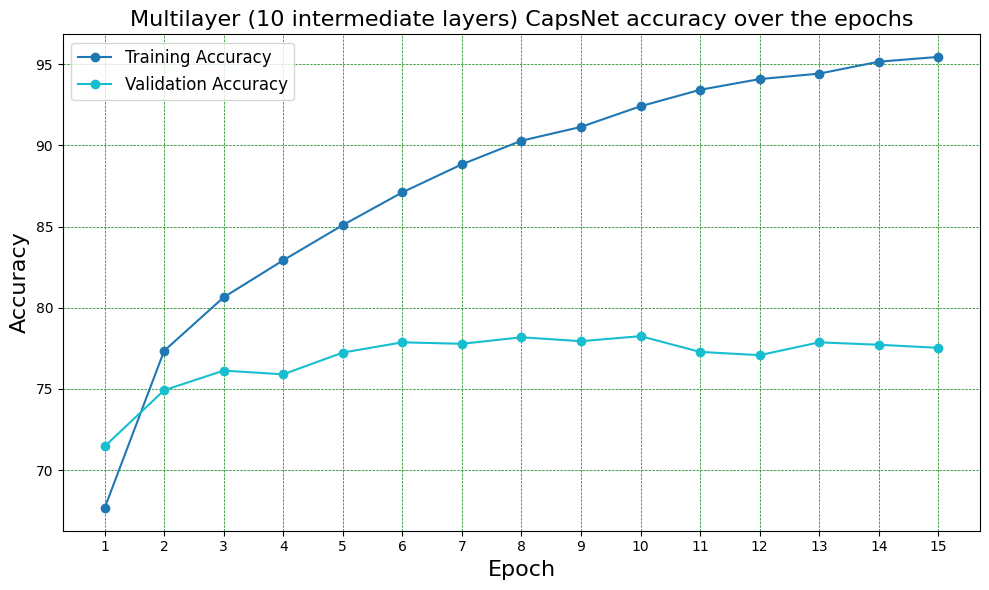

In [ ]:
utils.plot_line_chart(epoch_accuracy, ['Training Accuracy', 'Validation Accuracy'], 'Epoch', 'Accuracy',
                      'Multilayer (10 intermediate layers) CapsNet accuracy over the epochs')

In [ ]:
# time.sleep(5)

# from google.colab import runtime
# runtime.unassign()

## Plots for Base and All Multilayer CapsNet

In [6]:
CIFAR10_TRAIN_DIR = TRAIN_DIR+"cifar10/20Caps8Dim/"

pruned_multilayer_inter1_capsnet_model = torch.load(CIFAR10_TRAIN_DIR+'Trained_pruned_12pc_multilayer_inter1_capsnet_cifar10_model_Epoch30_of_30.pt', map_location=device)
pruned_multilayer_inter2_capsnet_model = torch.load(CIFAR10_TRAIN_DIR+'Trained_pruned_12pc_multilayer_inter2_capsnet_cifar10_model_Epoch15_of_15.pt', map_location=device)
pruned_multilayer_inter3_capsnet_model = torch.load(CIFAR10_TRAIN_DIR+'Trained_pruned_12pc_multilayer_inter3_capsnet_cifar10_model_Epoch15_of_15.pt', map_location=device)
pruned_multilayer_inter4_capsnet_model = torch.load(CIFAR10_TRAIN_DIR+'Trained_pruned_12pc_multilayer_inter4_capsnet_cifar10_model_Epoch15_of_15.pt', map_location=device)
pruned_multilayer_inter5_capsnet_model = torch.load(CIFAR10_TRAIN_DIR+'Trained_pruned_37pc_multilayer_inter5_capsnet_cifar10_model_Epoch15_of_15.pt', map_location=device)
pruned_multilayer_inter6_capsnet_model = torch.load(CIFAR10_TRAIN_DIR+'Trained_pruned_25pc_multilayer_inter6_capsnet_cifar10_model_Epoch15_of_15.pt', map_location=device)
pruned_multilayer_inter7_capsnet_model = torch.load(CIFAR10_TRAIN_DIR+'Trained_pruned_25pc_multilayer_inter7_capsnet_cifar10_model_Epoch15_of_15.pt', map_location=device)
pruned_multilayer_inter8_capsnet_model = torch.load(CIFAR10_TRAIN_DIR+'Trained_pruned_25pc_multilayer_inter8_capsnet_cifar10_model_Epoch15_of_15.pt', map_location=device)
pruned_multilayer_inter9_capsnet_model = torch.load(CIFAR10_TRAIN_DIR+'Trained_pruned_25pc_multilayer_inter9_capsnet_cifar10_model_Epoch15_of_15.pt', map_location=device)
pruned_multilayer_inter10_capsnet_model = torch.load(CIFAR10_TRAIN_DIR+'Trained_pruned_37pc_multilayer_inter10_capsnet_cifar10_model_Epoch15_of_15.pt', map_location=device)

In [7]:
models = [pruned_multilayer_inter1_capsnet_model,
          pruned_multilayer_inter2_capsnet_model,
          pruned_multilayer_inter3_capsnet_model,
          pruned_multilayer_inter4_capsnet_model,
          pruned_multilayer_inter5_capsnet_model,
          pruned_multilayer_inter6_capsnet_model,
          pruned_multilayer_inter7_capsnet_model,
          pruned_multilayer_inter8_capsnet_model,
          pruned_multilayer_inter9_capsnet_model,
          pruned_multilayer_inter10_capsnet_model]

legends = ['1 InterLayer [PR=0.125]',
           '2 InterLayers [PR=0.125]',
           '3 InterLayers [PR=0.125]',
           '4 InterLayers [PR=0.125]',
           '5 InterLayers [PR=0.375]',
           '6 InterLayers [PR=0.25]',
           '7 InterLayers [PR=0.25]',
           '8 InterLayers [PR=0.25]',
           '9 InterLayers [PR=0.25]',
           '10 InterLayers [PR=0.375]']

n_epochs = 15

epoch_losses = np.zeros((len(models), n_epochs))
epoch_accuracies = np.zeros((len(models), n_epochs))

for indx, model in enumerate(models):
    epoch_losses[indx] = model['epoch_loss'][:,:15][1]
    epoch_accuracies[indx] = model['epoch_accuracy'][:, :15][1]

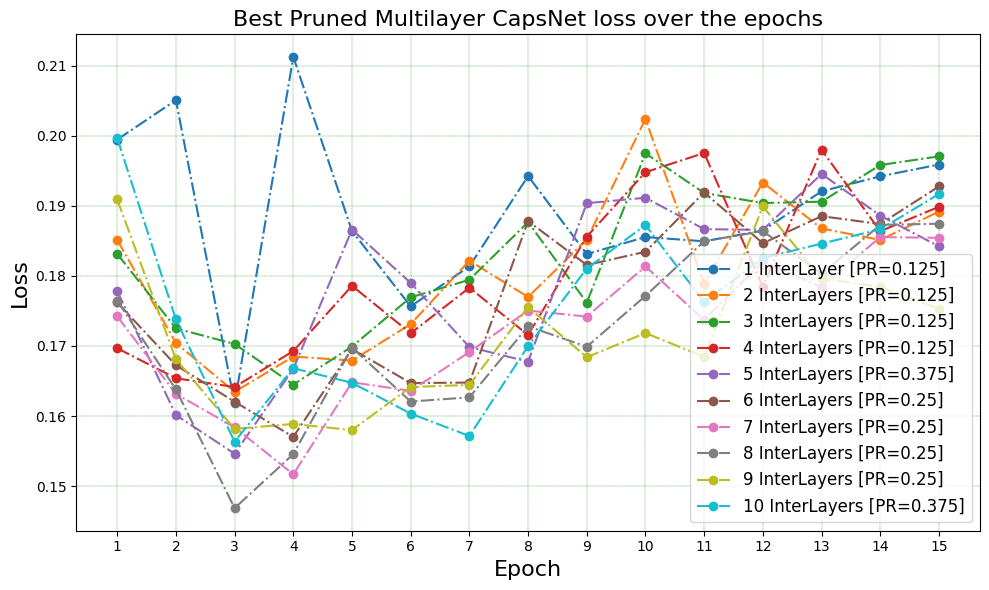

In [8]:
utils.plot_line_chart(epoch_losses, legends, 'Epoch', 'Loss',
                      'Best Pruned Multilayer CapsNet loss over the epochs', marker='o', line='-.')

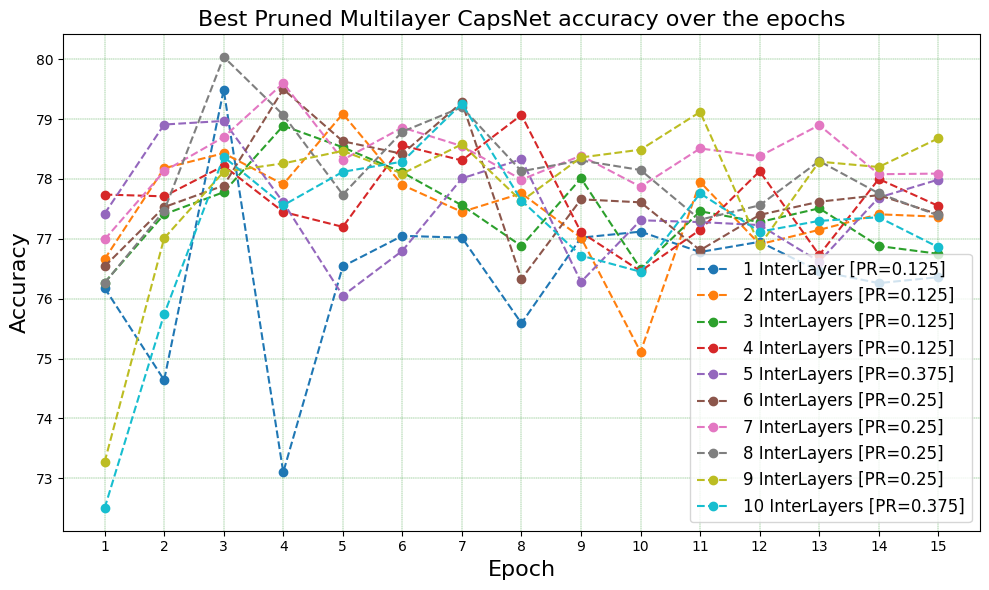

In [9]:
utils.plot_line_chart(epoch_accuracies, legends, 'Epoch', 'Accuracy',
                      'Best Pruned Multilayer CapsNet accuracy over the epochs', marker='o', line='--')